<a href="https://colab.research.google.com/github/grinaldo-oliveira/SibGrapi/blob/main/Validando_o_arquivo_NPY.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd /content/drive/MyDrive/Doutorado/SibGrapi

/content/drive/MyDrive/Doutorado/SibGrapi


In [ ]:
import numpy as np

# Carrega o arquivo .npy
try:
    # Carregando o arquivo
    dados = np.load('Data/Crescent/UNI/UNI_info.npy', allow_pickle=True)

    # Informações básicas
    print(f"Tipo de dados: {type(dados)}")
    print(f"Forma (shape): {dados.shape}")
    print(f"Tipo de elementos (dtype): {dados.dtype}")
    print(f"Número de dimensões: {dados.ndim}")
    print(f"Tamanho total (número de elementos): {dados.size}")

    # Se for um array estruturado (com campos nomeados)
    if hasattr(dados.dtype, 'names') and dados.dtype.names is not None:
        print("\nCampos do array estruturado:")
        for nome in dados.dtype.names:
            print(f"- {nome}: {dados.dtype[nome]}")

    # Se for um dicionário armazenado com allow_pickle=True
    if dados.dtype == np.dtype('O'):  # tipo objeto
        try:
            if isinstance(dados.item(), dict):
                print("\nEste arquivo contém um dicionário com as seguintes chaves:")
                for chave in dados.item().keys():
                    valor = dados.item()[chave]
                    if hasattr(valor, 'shape'):
                        print(f"- {chave}: {type(valor)} com shape {valor.shape}")
                    else:
                        print(f"- {chave}: {type(valor)}")
        except:
            pass

    # Amostra dos dados (se possível)
    print("\nVisualização de amostra dos dados:")
    if dados.size > 0:
        if dados.ndim == 0:  # Caso seja um objeto único (como um dicionário)
            print("Este arquivo contém um único objeto.")
        else:
            # Limita a visualização para não sobrecarregar o console
            max_elements = 5
            if dados.ndim == 1:
                print(dados[:min(max_elements, dados.size)])
            else:
                print(dados[:min(max_elements, dados.shape[0])])

except Exception as e:
    print(f"Erro ao carregar o arquivo: {e}")

Tipo de dados: <class 'numpy.ndarray'>
Forma (shape): ()
Tipo de elementos (dtype): object
Número de dimensões: 0
Tamanho total (número de elementos): 1

Este arquivo contém um dicionário com as seguintes chaves:
- model: <class 'str'>
- fnames: <class 'list'>
- labels: <class 'list'>
- embeddings: <class 'str'>
- classes: <class 'list'>

Visualização de amostra dos dados:
Este arquivo contém um único objeto.


In [ ]:
def load_embbed(pickle_path: str) -> tuple:
    data = np.load(pickle_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    embeds    = data['embeddings']
    labels    = data['labels']
    classes   = data['classes']

    embeds = np.vstack(embeds)
    labels = np.vstack(labels)

In [ ]:
data = np.load("Data/Crescent/UNI/UNI_info.npy", allow_pickle=True).tolist()

In [ ]:
data.keys()

dict_keys(['model', 'fnames', 'labels', 'embeddings', 'classes'])

In [ ]:
model = data['model']
file_refs = data['fnames']
embeds    = data['embeddings']
labels    = data['labels']
classes   = data['classes']

In [ ]:
   embeds = np.vstack(embeds)
   labels = np.vstack(labels)

In [ ]:
labels.shape

(12772, 1)

In [ ]:
print(f"Total number of elements in file_refs: {len(file_refs)}")

Total number of elements in file_refs: 12772


In [ ]:
fp = np.memmap("Data/Crescent/UNI/UNI.npy", dtype='float32', mode='w+', shape=(3,4))

In [ ]:
print(fp)
print("Shape:", fp.shape)
print("Data type:", fp.dtype)

[[0. 0. 0. 0.]
 [0. 0. 0. 0.]
 [0. 0. 0. 0.]]
Shape: (3, 4)
Data type: float32


In [ ]:
model, file_refs, embeddings, labels, classes = load_embbed("Data/Sclerosis/UNI/UNI_info.npy")


TypeError: cannot unpack non-iterable NoneType object

In [ ]:
import numpy as np

# Abrir o arquivo memmap em modo de leitura
fp = np.memmap("Data/Crescent/UNI/UNI.npy", mode='r')

# Mostrar dimensões
print("Formato do array:", fp.shape)

# Se o array for multidimensional, você pode percorrê-lo
if len(fp.shape) > 1:
    for i in range(min(1024, fp.shape[0])):  # Limita a 10 linhas para não sobrecarregar
        print(f"Linha {i}:", fp[i])
else:
    # Se for unidimensional, mostrar os primeiros elementos
    print("Primeiros 20 elementos:", fp[:1024])

    # E os últimos elementos
    print("Últimos 20 elementos:", fp[-1024:])

Formato do array: (104628224,)
Primeiros 20 elementos: [  0   0   0 ... 102 236  63]
Últimos 20 elementos: [  0   0   0 ... 181 246  63]


In [ ]:
fp.shape

(104628224,)

In [ ]:
import numpy as np
from numpy.lib.format import open_memmap

# Abrir o arquivo usando open_memmap em modo de leitura
fp = open_memmap("Data/Sclerosis/UNI/UNI.npy", mode='r')

# Mostrar dimensões
print("Formato do array:", fp.shape)

# Se o array for multidimensional, você pode percorrê-lo
if len(fp.shape) > 1:
    for i in range(min(10, fp.shape[0])):  # Limita a 10 linhas para não sobrecarregar
        print(f"Linha {i}:", fp[i])
else:
    # Se for unidimensional, mostrar os primeiros elementos
    print("Primeiros 20 elementos:", fp[:20])

    # E os últimos elementos
    print("Últimos 20 elementos:", fp[-20:])

ValueError: the magic string is not correct; expected b'\x93NUMPY', got b'\x00\x00\x00\x00\x00\x00'

In [ ]:
import numpy as np

# Abrir o arquivo com memmap
fp = np.memmap("Data/Crescent/UNI/UNI.npy", mode='r')

# Calcular quantas linhas completas podemos formar
# Assumindo que queremos 8192 colunas por linha
n_rows = len(fp) // 8192

# Reshape o memmap para ter n_rows linhas e 8192 colunas
# Isso irá descartar qualquer dado extra que não forme uma linha completa
fp_reshaped = fp[:n_rows * 8192].reshape(n_rows, 8192)

# Se você precisa que seja uma lista de listas em vez de um array NumPy
# (embora trabalhar com o array NumPy seja geralmente mais eficiente)
fp_list = fp_reshaped.tolist()

In [ ]:
fp_list

[[0,
  0,
  0,
  128,
  194,
  11,
  231,
  63,
  0,
  0,
  0,
  96,
  19,
  216,
  217,
  191,
  0,
  0,
  0,
  160,
  208,
  19,
  185,
  63,
  0,
  0,
  0,
  0,
  249,
  189,
  219,
  191,
  0,
  0,
  0,
  32,
  14,
  139,
  246,
  63,
  0,
  0,
  0,
  64,
  41,
  150,
  155,
  63,
  0,
  0,
  0,
  32,
  81,
  94,
  250,
  63,
  0,
  0,
  0,
  128,
  2,
  195,
  0,
  64,
  0,
  0,
  0,
  96,
  120,
  230,
  216,
  191,
  0,
  0,
  0,
  32,
  143,
  133,
  203,
  63,
  0,
  0,
  0,
  160,
  33,
  78,
  238,
  63,
  0,
  0,
  0,
  64,
  6,
  2,
  0,
  192,
  0,
  0,
  0,
  160,
  51,
  41,
  242,
  63,
  0,
  0,
  0,
  224,
  187,
  203,
  176,
  191,
  0,
  0,
  0,
  192,
  175,
  147,
  248,
  63,
  0,
  0,
  0,
  0,
  70,
  157,
  185,
  191,
  0,
  0,
  0,
  128,
  250,
  205,
  239,
  191,
  0,
  0,
  0,
  0,
  15,
  19,
  238,
  63,
  0,
  0,
  0,
  32,
  109,
  5,
  211,
  63,
  0,
  0,
  0,
  32,
  125,
  219,
  192,
  191,
  0,
  0,
  0,
  128,
  148,
  130,
  227,
  191,
  0

In [ ]:
import numpy as np
import os
from numpy.lib.format import open_memmap
import matplotlib.pyplot as plt
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import time

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.

    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings

    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"

    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])

    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')

    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    n_rows = len(fp) // 8192

    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)

    return embeds, labels, classes, file_refs, model

def plot_confusion_matrix(cm, classes, title='Confusion Matrix', cmap=plt.cm.Blues):
    """
    Plota uma matriz de confusão mais bonita com matplotlib.
    """
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap, xticklabels=classes, yticklabels=classes)
    plt.title(title)
    plt.ylabel('Verdadeiro')
    plt.xlabel('Previsto')
    plt.tight_layout()
    plt.savefig(f"{title.replace(' ', '_')}.png")
    plt.close()

def main():
    # Definir o caminho do arquivo
    file_path = "Data/Crescent/UNI/UNI.npy"

    # Verificar se o arquivo existe
    if not os.path.exists(file_path):
        print(f"Erro: O arquivo {file_path} não foi encontrado.")
        return

    # Verificar se o arquivo _info existe
    base_name, ext = os.path.splitext(file_path)
    info_path = f"{base_name}_info{ext}"
    if not os.path.exists(info_path):
        print(f"Erro: O arquivo {info_path} não foi encontrado.")
        return

    print(f"Carregando dados de {file_path}...")

    try:
        # Carregar embeddings e outras informações
        embeds, labels, classes, file_refs, model = load_embed(file_path)

        # Converter labels para formato utilizável pelos classificadores
        # Assumindo que labels tem o formato one-hot encoding, precisamos convertê-los para índices
        if labels.shape[1] > 1:  # Se for one-hot encoding
            y = np.argmax(labels, axis=1)
        else:
            y = labels.ravel()

        print(f"Dados carregados com sucesso!")
        print(f"Formato dos embeddings: {embeds.shape}")
        print(f"Número de classes: {len(classes)}")
        print(f"Classes disponíveis: {classes}")

        # Dividir dados em conjuntos de treinamento e teste
        X_train, X_test, y_train, y_test = train_test_split(embeds, y, test_size=0.2, random_state=42, stratify=y)

        # Normalizar os dados
        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)

        print("\n--- Treinando Classificadores ---\n")

        # Configurar e treinar o classificador MLP
        print("Treinando MLP...")
        start_time = time.time()
        mlp = MLPClassifier(hidden_layer_sizes=(100, 50), max_iter=500, random_state=42, verbose=True)
        mlp.fit(X_train_scaled, y_train)
        mlp_time = time.time() - start_time

        # Avaliar MLP
        mlp_pred = mlp.predict(X_test_scaled)
        mlp_acc = accuracy_score(y_test, mlp_pred)
        mlp_report = classification_report(y_test, mlp_pred, target_names=classes, output_dict=True)
        mlp_cm = confusion_matrix(y_test, mlp_pred)

        # Calcular validação cruzada para MLP
        mlp_cv = cross_val_score(mlp, X_train_scaled, y_train, cv=5)

        # Configurar e treinar o classificador SVM
        print("\nTreinando SVM...")
        start_time = time.time()
        svm = SVC(kernel='rbf', C=10, gamma='scale', random_state=42, verbose=True)
        svm.fit(X_train_scaled, y_train)
        svm_time = time.time() - start_time

        # Avaliar SVM
        svm_pred = svm.predict(X_test_scaled)
        svm_acc = accuracy_score(y_test, svm_pred)
        svm_report = classification_report(y_test, svm_pred, target_names=classes, output_dict=True)
        svm_cm = confusion_matrix(y_test, svm_pred)

        # Calcular validação cruzada para SVM
        svm_cv = cross_val_score(svm, X_train_scaled, y_train, cv=5)

        # Gerar relatório
        print("\n--- RELATÓRIO DE PERFORMANCE ---\n")

        print(f"Classificador MLP:")
        print(f"Tempo de treinamento: {mlp_time:.2f} segundos")
        print(f"Acurácia: {mlp_acc:.4f}")
        print(f"Validação cruzada (5-fold): {mlp_cv.mean():.4f} (±{mlp_cv.std():.4f})")
        print("Relatório de classificação:\n")
        for cls in classes:
            print(f"  {cls}:")
            print(f"    Precisão: {mlp_report[cls]['precision']:.4f}")
            print(f"    Recall: {mlp_report[cls]['recall']:.4f}")
            print(f"    F1-Score: {mlp_report[cls]['f1-score']:.4f}")

        print("\nClassificador SVM:")
        print(f"Tempo de treinamento: {svm_time:.2f} segundos")
        print(f"Acurácia: {svm_acc:.4f}")
        print(f"Validação cruzada (5-fold): {svm_cv.mean():.4f} (±{svm_cv.std():.4f})")
        print("Relatório de classificação:\n")
        for cls in classes:
            print(f"  {cls}:")
            print(f"    Precisão: {svm_report[cls]['precision']:.4f}")
            print(f"    Recall: {svm_report[cls]['recall']:.4f}")
            print(f"    F1-Score: {svm_report[cls]['f1-score']:.4f}")

        print("\nComparação de classificadores:")
        print(f"Diferença de acurácia (MLP - SVM): {(mlp_acc - svm_acc):.4f}")
        print(f"Classificador com melhor acurácia: {'MLP' if mlp_acc > svm_acc else 'SVM'}")

        # Gerar gráficos
        plot_confusion_matrix(mlp_cm, classes, "Matriz de Confusão - MLP")
        plot_confusion_matrix(svm_cm, classes, "Matriz de Confusão - SVM")

        # Salvar relatório em um arquivo
        with open("relatorio_classificadores.txt", "w") as f:
            f.write("--- RELATÓRIO DE PERFORMANCE DE CLASSIFICADORES ---\n\n")
            f.write(f"Arquivo de dados: {file_path}\n")
            f.write(f"Número de classes: {len(classes)}\n")
            f.write(f"Classes: {', '.join(classes)}\n")
            f.write(f"Dimensão dos embeddings: {embeds.shape[1]}\n\n")

            f.write(f"Classificador MLP:\n")
            f.write(f"Tempo de treinamento: {mlp_time:.2f} segundos\n")
            f.write(f"Acurácia: {mlp_acc:.4f}\n")
            f.write(f"Validação cruzada (5-fold): {mlp_cv.mean():.4f} (±{mlp_cv.std():.4f})\n")
            f.write("Relatório de classificação:\n")
            for cls in classes:
                f.write(f"  {cls}:\n")
                f.write(f"    Precisão: {mlp_report[cls]['precision']:.4f}\n")
                f.write(f"    Recall: {mlp_report[cls]['recall']:.4f}\n")
                f.write(f"    F1-Score: {mlp_report[cls]['f1-score']:.4f}\n")

            f.write("\nClassificador SVM:\n")
            f.write(f"Tempo de treinamento: {svm_time:.2f} segundos\n")
            f.write(f"Acurácia: {svm_acc:.4f}\n")
            f.write(f"Validação cruzada (5-fold): {svm_cv.mean():.4f} (±{svm_cv.std():.4f})\n")
            f.write("Relatório de classificação:\n")
            for cls in classes:
                f.write(f"  {cls}:\n")
                f.write(f"    Precisão: {svm_report[cls]['precision']:.4f}\n")
                f.write(f"    Recall: {svm_report[cls]['recall']:.4f}\n")
                f.write(f"    F1-Score: {svm_report[cls]['f1-score']:.4f}\n")

            f.write("\nComparação de classificadores:\n")
            f.write(f"Diferença de acurácia (MLP - SVM): {(mlp_acc - svm_acc):.4f}\n")
            f.write(f"Classificador com melhor acurácia: {'MLP' if mlp_acc > svm_acc else 'SVM'}\n")

        print("\nRelatório completo salvo em 'relatorio_classificadores.txt'")
        print("Matrizes de confusão salvas como imagens.")

    except Exception as e:
        print(f"Erro ao processar os dados: {e}")

if __name__ == "__main__":
    main()

Carregando dados de Data/Crescent/UNI/UNI.npy...
Dados carregados com sucesso!
Formato dos embeddings: (12772, 8192)
Número de classes: 2
Classes disponíveis: ['others', 'Crescent']

--- Treinando Classificadores ---

Treinando MLP...


/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:698: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


Iteration 1, loss = 0.25038165
Iteration 2, loss = 0.02824160
Iteration 3, loss = 0.00842546
Iteration 4, loss = 0.00760832
Iteration 5, loss = 0.00644082
Iteration 6, loss = 0.00439919
Iteration 7, loss = 0.00441150
Iteration 8, loss = 0.00381321
Iteration 9, loss = 0.00326383
Iteration 10, loss = 0.00304378
Iteration 11, loss = 0.00288527
Iteration 12, loss = 0.00285707
Iteration 13, loss = 0.00297676
Iteration 14, loss = 0.00281200
Iteration 15, loss = 0.00260951
Iteration 16, loss = 0.00278998
Iteration 17, loss = 0.00311557
Iteration 18, loss = 0.00275291
Iteration 19, loss = 0.00255479
Iteration 20, loss = 0.00256444
Iteration 21, loss = 0.00243439
Iteration 22, loss = 0.00262335
Iteration 23, loss = 0.00250673
Iteration 24, loss = 0.00237413
Iteration 25, loss = 0.00223651
Iteration 26, loss = 0.00239020
Iteration 27, loss = 0.00241588
Iteration 28, loss = 0.00221670
Iteration 29, loss = 0.00222935
Iteration 30, loss = 0.00230591


/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:698: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


KeyboardInterrupt: 

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import umap
import seaborn as sns

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.

    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings

    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"

    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])

    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')

    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    n_rows = len(fp) // embed_dim
    print(f"- Quantidade de embeddings: {embed_dim}")

    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)

    return embeds, labels, classes, file_refs, model

# Definir o caminho do arquivo
file_path = "Data/Crescent/UNI/UNI.npy"

# Carregar os embeddings
print(f"Carregando embeddings do arquivo: {file_path}")
embeds, labels, classes, file_refs, model = load_embed(file_path)

print(f"Embeddings carregados com sucesso:")
print(f"- Formato dos embeddings: {embeds.shape}")
print(f"- Número de classes: {len(classes)}")
print(f"- Classes: {classes}")
print(f"- Formato das labels: {labels.shape}")
print(f"- Modelo usado: {model}")

# Calcular e exibir a quantidade de amostras em cada classe
print("\nQuantidade de amostras por classe:")
for i, classe in enumerate(classes):
    # Contar quantas vezes esta classe aparece nas labels
    # Assumindo que as labels são one-hot encoding
    quantidade = np.sum(labels[:, i])
    print(f"- {classe}: {int(quantidade)} amostras")

# Para verificação, mostrar o total de amostras
total_amostras = np.sum(labels)
print(f"\nTotal de amostras: {int(total_amostras)}")

Carregando embeddings do arquivo: Data/Crescent/UNI/UNI.npy
- Quantidade de embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (12772, 8192)
- Número de classes: 2
- Classes: ['others', 'Crescent']
- Formato das labels: (12772, 1)
- Modelo usado: UNI

Quantidade de amostras por classe:
- others: 6386 amostras


IndexError: index 1 is out of bounds for axis 1 with size 1

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import umap
import seaborn as sns

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.

    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings

    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"

    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])

    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')

    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    n_rows = len(fp) // 8192

    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)

    return embeds, labels, classes, file_refs, model

# Definir o caminho do arquivo
file_path = "Data/Crescent/UNI/UNI.npy"

# Carregar os embeddings
print(f"Carregando embeddings do arquivo: {file_path}")
embeds, labels, classes, file_refs, model = load_embed(file_path)

print(f"Embeddings carregados com sucesso:")
print(f"- Formato dos embeddings: {embeds.shape}")
print(f"- Número de classes: {len(classes)}")
print(f"- Classes: {classes}")
print(f"- Formato das labels: {labels.shape}")
print(f"- Modelo usado: {model}")

# Calcular e exibir a quantidade de amostras em cada classe
print("\nQuantidade de amostras por classe:")

# Parece que as labels têm formato diferente do esperado
# Vamos adaptá-las para contar corretamente
if labels.shape[1] == 1:  # Se for uma única coluna com índices de classe
    # Converter para ints se necessário
    label_indices = labels.flatten().astype(int)

    # Usar np.bincount para contar ocorrências de cada classe
    counts = np.bincount(label_indices)

    # Se houver mais classes do que índices encontrados, garantir que temos contadores para todas
    if len(counts) < len(classes):
        counts = np.pad(counts, (0, len(classes) - len(counts)), 'constant')

    # Imprimir a contagem para cada classe
    for i, classe in enumerate(classes):
        if i < len(counts):
            print(f"- {classe}: {counts[i]} amostras")
        else:
            print(f"- {classe}: 0 amostras")
else:
    # Se as labels forem one-hot encoding
    for i, classe in enumerate(classes):
        if i < labels.shape[1]:
            quantidade = np.sum(labels[:, i])
            print(f"- {classe}: {int(quantidade)} amostras")
        else:
            print(f"- {classe}: Não foi possível calcular (formato de labels incompatível)")

# Para verificação, mostrar o total de amostras
total_amostras = len(labels)
print(f"\nTotal de amostras: {total_amostras}")

Carregando embeddings do arquivo: Data/Crescent/UNI/UNI.npy
Embeddings carregados com sucesso:
- Formato dos embeddings: (12772, 8192)
- Número de classes: 2
- Classes: ['others', 'Crescent']
- Formato das labels: (12772, 1)
- Modelo usado: UNI

Quantidade de amostras por classe:
- others: 6386 amostras
- Crescent: 6386 amostras

Total de amostras: 12772


Carregando embeddings do arquivo: Data/Crescent/UNI/UNI.npy
Embeddings carregados com sucesso:
- Formato dos embeddings: (12772, 8192)
- Número de classes: 2
- Classes: ['others', 'Crescent']
- Formato das labels: (12772, 1)
- Modelo usado: UNI

Verificando distribuição das labels:
Formato das labels carregadas: (12772, 1)
Primeiras 5 linhas de labels:
[[1]
 [1]
 [1]
 [1]
 [1]]
As labels parecem estar codificadas diretamente

Distribuição de classes (por índice):
Classe 0 (others): 6386 amostras
Classe 1 (Crescent): 6386 amostras

Verificando mapeamento classes x índices:
Lista de classes: ['others', 'Crescent']
Possível problema de case-sensitivity? Comparando:
  0: 'others' vs versão lowercase: 'others'
  1: 'Crescent' vs versão lowercase: 'crescent'

Verificando manualmente quantas amostras existem por valor específico nas labels:
Contagem por valor nas labels (antes de flatten/argmax):
  Valor 0: 6386 amostras
  Valor 1: 6386 amostras

Aplicando UMAP para redução para 3D...


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Plotting 3D - Classe 'others' (índice 0): 6386 amostras
Plotting 3D - Classe 'Crescent' (índice 1): 6386 amostras


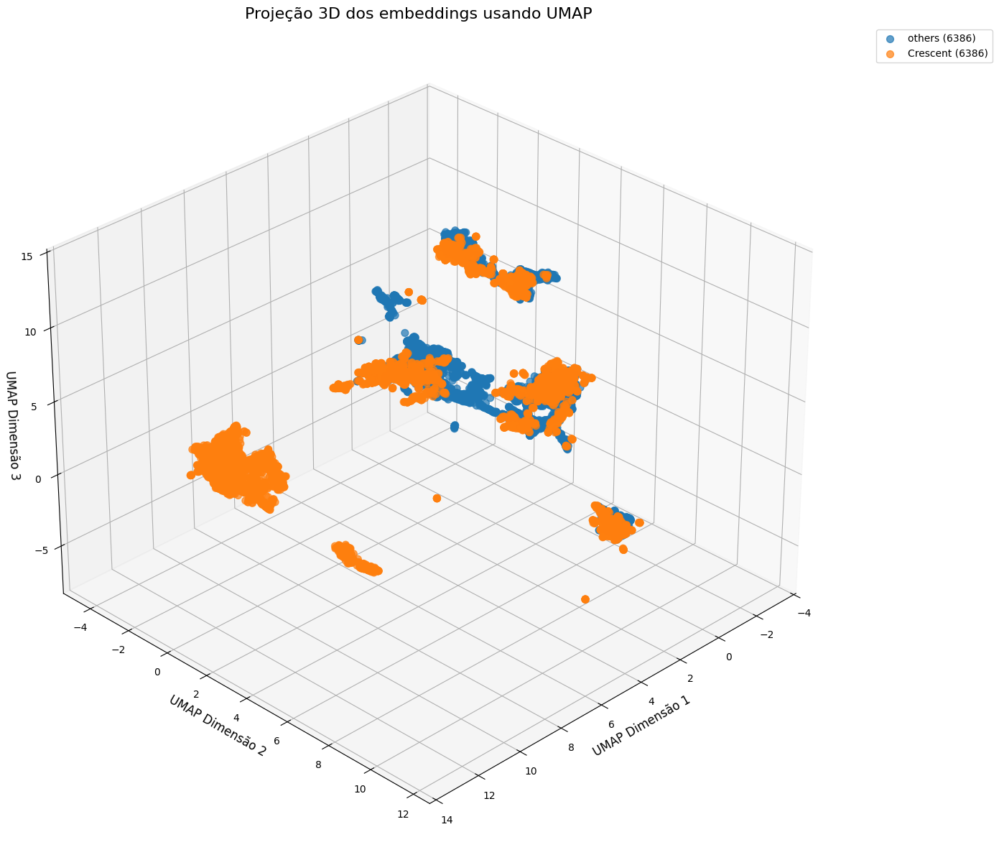


Visualização 3D concluída e salva como 'embeddings_3d_umap.png'.
Use o mouse para rotacionar a visualização 3D.


In [ ]:

import os
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import umap
import seaborn as sns

# Habilitando modo interativo
plt.ion()

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.

    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings

    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"

    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])

    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')

    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples

    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim

    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)

    return embeds, labels, classes, file_refs, model

# Definir o caminho do arquivo
file_path = "Data/Crescent/UNI/UNI.npy"

# Carregar os embeddings
print(f"Carregando embeddings do arquivo: {file_path}")
embeds, labels, classes, file_refs, model = load_embed(file_path)

print(f"Embeddings carregados com sucesso:")
print(f"- Formato dos embeddings: {embeds.shape}")
print(f"- Número de classes: {len(classes)}")
print(f"- Classes: {classes}")
print(f"- Formato das labels: {labels.shape}")
print(f"- Modelo usado: {model}")

# Debug: Verificar se as labels contêm a classe "crescent"
print("\nVerificando distribuição das labels:")
print(f"Formato das labels carregadas: {labels.shape}")
print(f"Primeiras 5 linhas de labels:\n{labels[:5]}")

# Verificar se as labels estão em formato one-hot ou codificadas diretamente
if labels.shape[1] > 1:
    print("As labels parecem estar em formato one-hot")
    label_indices = np.argmax(labels, axis=1)
else:
    print("As labels parecem estar codificadas diretamente")
    # Ensure labels are treated as integers for indexing/counting
    label_indices = labels.flatten().astype(int)

# Verificar a contagem de cada classe
unique_indices, counts = np.unique(label_indices, return_counts=True)
print(f"\nDistribuição de classes (por índice):")
for idx, count in zip(unique_indices, counts):
    # Ensure idx is within the bounds of classes list
    class_name = classes[idx] if idx < len(classes) else f"Desconhecida (Índice {idx})"
    print(f"Classe {idx} ({class_name}): {count} amostras")

# Verificar se há um problema de mapeamento de classes
print(f"\nVerificando mapeamento classes x índices:")
print(f"Lista de classes: {classes}")
print(f"Possível problema de case-sensitivity? Comparando:")
for i, cls in enumerate(classes):
    print(f"  {i}: '{cls}' vs versão lowercase: '{cls.lower()}'")

print("\nVerificando manualmente quantas amostras existem por valor específico nas labels:")
# Check counts for each unique label index found
unique_label_values, label_counts = np.unique(labels, return_counts=True)
print("Contagem por valor nas labels (antes de flatten/argmax):")
for val, count in zip(unique_label_values, label_counts):
    print(f"  Valor {val}: {count} amostras")

# Aplicar UMAP para redução de dimensionalidade 3D
print("\nAplicando UMAP para redução para 3D...")
reducer_3d = umap.UMAP(n_components=3, random_state=42)
embedding_3d = reducer_3d.fit_transform(embeds)

# Configurar uma paleta de cores personalizada para as classes
num_classes = len(classes)
palette = sns.color_palette("tab10", n_colors=num_classes)

# Visualização 3D com interatividade
fig = plt.figure(figsize=(14, 12))
ax = fig.add_subplot(111, projection='3d')

# Use the processed label_indices for plotting in 3D
for i, classe in enumerate(classes):
    mask = label_indices == i
    samples_count = np.sum(mask)
    print(f"Plotting 3D - Classe '{classe}' (índice {i}): {samples_count} amostras")

    if samples_count > 0:
        ax.scatter(
            embedding_3d[mask, 0],
            embedding_3d[mask, 1],
            embedding_3d[mask, 2],
            c=[palette[i % len(palette)]], # Use modulo for safety
            label=f"{classe} ({samples_count})",
            alpha=0.7,
            s=50
        )

ax.set_title('Projeção 3D dos embeddings usando UMAP', fontsize=16)
ax.set_xlabel('UMAP Dimensão 1', fontsize=12)
ax.set_ylabel('UMAP Dimensão 2', fontsize=12)
ax.set_zlabel('UMAP Dimensão 3', fontsize=12)
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Configuração para rotação interativa
def rotate_view(event):
    if event.inaxes == ax:
        ax.view_init(elev=ax.elev, azim=ax.azim)
        fig.canvas.draw_idle()

# Função para lidar com o arrastar do mouse
def on_motion(event):
    if event.button == 1:  # Botão esquerdo do mouse
        if event.inaxes == ax:
            ax.view_init(elev=ax.elev - (event.ydata - prev_event[1]) * 0.5,
                         azim=ax.azim - (event.xdata - prev_event[0]) * 0.5)
            fig.canvas.draw_idle()
            prev_event[0], prev_event[1] = event.xdata, event.ydata

# Variável para armazenar a posição anterior do mouse
prev_event = [None, None]

# Função para capturar o clique do mouse
def on_press(event):
    if event.button == 1:  # Botão esquerdo do mouse
        if event.inaxes == ax:
            prev_event[0], prev_event[1] = event.xdata, event.ydata

# Conectando os eventos com as funções
fig.canvas.mpl_connect('motion_notify_event', on_motion)
fig.canvas.mpl_connect('button_press_event', on_press)

# Configuração inicial da vista
ax.view_init(30, 45)
plt.savefig('embeddings_3d_umap.png', dpi=300)
plt.show()

print("\nVisualização 3D concluída e salva como 'embeddings_3d_umap.png'.")
print("Use o mouse para rotacionar a visualização 3D.")

In [ ]:
import os
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
import umap
from plotly.offline import plot

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.

    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings

    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"

    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])

    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')

    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    print(f"-Quantidade de Embeddings: {embed_dim}")

    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim

    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)

    return embeds, labels, classes, file_refs, model

# Definir o caminho do arquivo
file_path = "Data/Normal/UNI/UNI.npy"

# Carregar os embeddings
print(f"Carregando embeddings do arquivo: {file_path}")
embeds, labels, classes, file_refs, model = load_embed(file_path)

print(f"Embeddings carregados com sucesso:")
print(f"- Formato dos embeddings: {embeds.shape}")
print(f"- Número de classes: {len(classes)}")
print(f"- Classes: {classes}")
print(f"- Formato das labels: {labels.shape}")
print(f"- Modelo usado: {model}")

# Debug: Verificar se as labels contêm a classe "crescent"
print("\nVerificando distribuição das labels:")
print(f"Formato das labels carregadas: {labels.shape}")
print(f"Primeiras 5 linhas de labels:\n{labels[:5]}")

# Verificar se as labels estão em formato one-hot ou codificadas diretamente
if labels.shape[1] > 1:
    print("As labels parecem estar em formato one-hot")
    label_indices = np.argmax(labels, axis=1)
else:
    print("As labels parecem estar codificadas diretamente")
    # Ensure labels are treated as integers for indexing/counting
    label_indices = labels.flatten().astype(int)

# Verificar a contagem de cada classe
unique_indices, counts = np.unique(label_indices, return_counts=True)
print(f"\nDistribuição de classes (por índice):")
for idx, count in zip(unique_indices, counts):
    # Ensure idx is within the bounds of classes list
    class_name = classes[idx] if idx < len(classes) else f"Desconhecida (Índice {idx})"
    print(f"Classe {idx} ({class_name}): {count} amostras")

# Verificar se há um problema de mapeamento de classes
print(f"\nVerificando mapeamento classes x índices:")
print(f"Lista de classes: {classes}")
print(f"Possível problema de case-sensitivity? Comparando:")
for i, cls in enumerate(classes):
    print(f"  {i}: '{cls}' vs versão lowercase: '{cls.lower()}'")

print("\nVerificando manualmente quantas amostras existem por valor específico nas labels:")
# Check counts for each unique label index found
unique_label_values, label_counts = np.unique(labels, return_counts=True)
print("Contagem por valor nas labels (antes de flatten/argmax):")
for val, count in zip(unique_label_values, label_counts):
    print(f"  Valor {val}: {count} amostras")

# Aplicar UMAP para redução de dimensionalidade 3D
print("\nAplicando UMAP para redução para 3D...")
reducer_3d = umap.UMAP(n_components=3, random_state=42)
embedding_3d = reducer_3d.fit_transform(embeds)

# Criar uma paleta de cores
colors = px.colors.qualitative.Plotly[:len(classes)]

# Criar figura Plotly
fig = go.Figure()

# Adicionar cada classe como um conjunto de pontos separado
for i, classe in enumerate(classes):
    mask = label_indices == i
    samples_count = np.sum(mask)
    print(f"Plotting 3D - Classe '{classe}' (índice {i}): {samples_count} amostras")

    if samples_count > 0:
        fig.add_trace(go.Scatter3d(
            x=embedding_3d[mask, 0],
            y=embedding_3d[mask, 1],
            z=embedding_3d[mask, 2],
            mode='markers',
            marker=dict(
                size=5,
                color=colors[i % len(colors)],
                opacity=0.8,
                line=dict(
                    width=0.5,
                    color='rgb(50,50,50)'
                )
            ),
            name=f"{classe} ({samples_count})",
            hovertemplate=(
                '<b>%{text}</b><br>' +
                'UMAP1: %{x:.2f}<br>' +
                'UMAP2: %{y:.2f}<br>' +
                'UMAP3: %{z:.2f}'
            ),
            text=[f"Amostra {j+1} de {classe}" for j in range(samples_count)]
        ))

# Configurar o layout com opções de visualização melhoradas
fig.update_layout(
    title='Projeção 3D dos embeddings usando UMAP',
    scene=dict(
        xaxis_title='UMAP Dimensão 1',
        yaxis_title='UMAP Dimensão 2',
        zaxis_title='UMAP Dimensão 3',
        aspectmode='auto'
    ),
    legend=dict(
        title='Classes',
        yanchor="top",
        y=0.99,
        xanchor="right",
        x=0.99
    ),
    margin=dict(l=0, r=0, b=0, t=40),
    template="plotly_white",
    scene_camera=dict(
        eye=dict(x=1.5, y=1.5, z=1)
    )
)

# Salvar como HTML interativo e exibir
plot(fig, filename='embeddings_3d_umap_interactive.html', auto_open=True)
print("\nVisualização 3D interativa concluída e salva como 'embeddings_3d_umap_interactive.html'.")
print("Use o mouse para rotacionar, fazer pan e zoom na visualização 3D.")

Carregando embeddings do arquivo: Data/Normal/UNI/UNI.npy
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (11992, 8192)
- Número de classes: 2
- Classes: ['others', 'Normal']
- Formato das labels: (11992, 1)
- Modelo usado: UNI

Verificando distribuição das labels:
Formato das labels carregadas: (11992, 1)
Primeiras 5 linhas de labels:
[[0]
 [0]
 [0]
 [0]
 [0]]
As labels parecem estar codificadas diretamente

Distribuição de classes (por índice):
Classe 0 (others): 5996 amostras
Classe 1 (Normal): 5996 amostras

Verificando mapeamento classes x índices:
Lista de classes: ['others', 'Normal']
Possível problema de case-sensitivity? Comparando:
  0: 'others' vs versão lowercase: 'others'
  1: 'Normal' vs versão lowercase: 'normal'

Verificando manualmente quantas amostras existem por valor específico nas labels:
Contagem por valor nas labels (antes de flatten/argmax):
  Valor 0: 5996 amostras
  Valor 1: 5996 amostras

Aplicando UMAP para reduçã

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_spectral_embedding.py:329: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



Plotting 3D - Classe 'others' (índice 0): 5996 amostras
Plotting 3D - Classe 'Normal' (índice 1): 5996 amostras

Visualização 3D interativa concluída e salva como 'embeddings_3d_umap_interactive.html'.
Use o mouse para rotacionar, fazer pan e zoom na visualização 3D.


Carregando embeddings do arquivo: Data/Normal/UNI/UNI.npy
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (11992, 8192)
- Número de classes: 2
- Classes: ['others', 'Normal']
- Formato das labels: (11992, 1)
- Modelo usado: UNI

Resultados da Avaliação dos Classificadores:
Classificador Acurácia Precisão Recall F1-Score
          MLP   0.9505   0.9530 0.9488   0.9509
          SVM   0.9569   0.9612 0.9532   0.9572


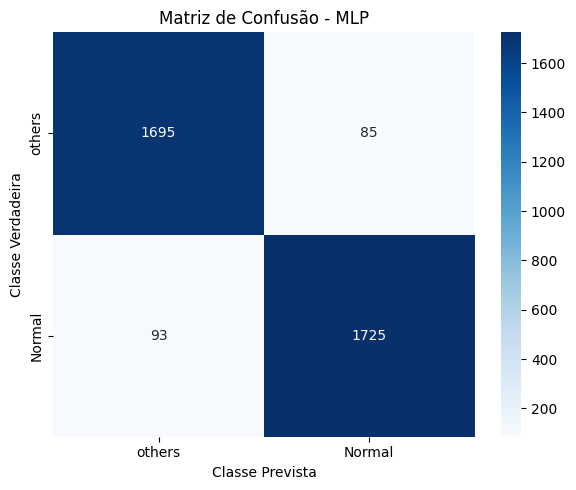

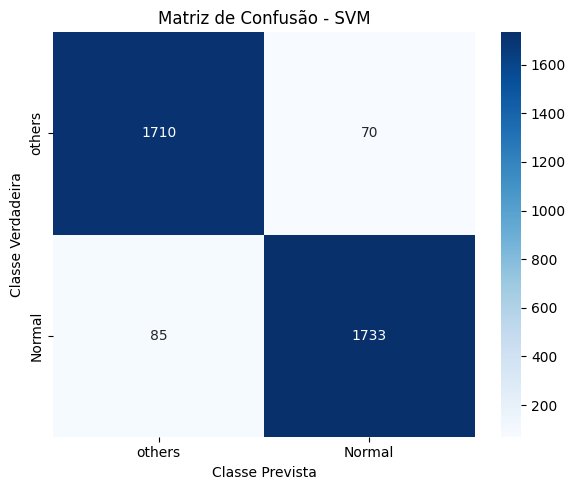

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_spectral_embedding.py:329: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.

/usr/local/lib/python3.11/dist-packages/umap/spectral.py:548: UserWarning:

Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

/usr/local/lib/python3.11/dist-packages/umap/spectral.py:548: UserWarning:

Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some nois

In [ ]:
import os
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
import umap
from plotly.offline import plot
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.
    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings
    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"
    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])
    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')
    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    print(f"-Quantidade de Embeddings: {embed_dim}")
    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim
    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)
    return embeds, labels, classes, file_refs, model

def evaluate_classifier(classifier, X_train, X_test, y_train, y_test, name):
    """
    Treina e avalia um classificador.

    Args:
        classifier: Classificador a ser avaliado
        X_train: Dados de treinamento
        X_test: Dados de teste
        y_train: Labels de treinamento
        y_test: Labels de teste
        name: Nome do classificador

    Returns:
        dict: Métricas de desempenho (acurácia, precisão, recall, f1-score)
    """
    # Treinar o classificador
    classifier.fit(X_train, y_train.ravel())

    # Fazer previsões
    y_pred = classifier.predict(X_test)

    # Calcular métricas
    metrics = {
        'Classificador': name,
        'Acurácia': accuracy_score(y_test, y_pred),
        'Precisão': precision_score(y_test, y_pred),
        'Recall': recall_score(y_test, y_pred),
        'F1-Score': f1_score(y_test, y_pred)
    }

    # Matriz de confusão
    cm = confusion_matrix(y_test, y_pred)

    return metrics, cm

def plot_confusion_matrix(cm, classifier_name, classes):
    """
    Plota a matriz de confusão.

    Args:
        cm: Matriz de confusão
        classifier_name: Nome do classificador
        classes: Nomes das classes
    """
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title(f'Matriz de Confusão - {classifier_name}')
    plt.ylabel('Classe Verdadeira')
    plt.xlabel('Classe Prevista')
    plt.tight_layout()
    plt.show()

# Definir o caminho do arquivo
file_path = "Data/Normal/UNI/UNI.npy"

# Carregar os embeddings
print(f"Carregando embeddings do arquivo: {file_path}")
embeds, labels, classes, file_refs, model = load_embed(file_path)
print(f"Embeddings carregados com sucesso:")
print(f"- Formato dos embeddings: {embeds.shape}")
print(f"- Número de classes: {len(classes)}")
print(f"- Classes: {classes}")
print(f"- Formato das labels: {labels.shape}")
print(f"- Modelo usado: {model}")

# Dividir os dados em conjuntos de treino e teste
X_train, X_test, y_train, y_test = train_test_split(embeds, labels, test_size=0.3, random_state=42)

# Normalizar os dados
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Configurar os classificadores
mlp = MLPClassifier(hidden_layer_sizes=(100,), max_iter=500, alpha=0.0001,
                    solver='adam', random_state=42, early_stopping=True)

svm = SVC(kernel='rbf', C=1.0, gamma='scale', random_state=42)

# Avaliar cada classificador
results = []
confusion_matrices = {}

# Avaliar MLP
mlp_metrics, mlp_cm = evaluate_classifier(mlp, X_train_scaled, X_test_scaled, y_train, y_test, "MLP")
results.append(mlp_metrics)
confusion_matrices["MLP"] = mlp_cm

# Avaliar SVM
svm_metrics, svm_cm = evaluate_classifier(svm, X_train_scaled, X_test_scaled, y_train, y_test, "SVM")
results.append(svm_metrics)
confusion_matrices["SVM"] = svm_cm

# Criar DataFrame com os resultados
results_df = pd.DataFrame(results)

# Formatar os resultados para melhor visualização
for col in ['Acurácia', 'Precisão', 'Recall', 'F1-Score']:
    results_df[col] = results_df[col].map(lambda x: f"{x:.4f}")

# Exibir a tabela de resultados
print("\nResultados da Avaliação dos Classificadores:")
print(results_df.to_string(index=False))

# Plotar as matrizes de confusão
for classifier_name, cm in confusion_matrices.items():
    plot_confusion_matrix(cm, classifier_name, classes)

# Visualizar os dados com UMAP para verificar a separabilidade
reducer = umap.UMAP(n_components=2, random_state=42)
embeddings_2d = reducer.fit_transform(embeds)

# Plotar visualização UMAP
fig = px.scatter(
    x=embeddings_2d[:, 0],
    y=embeddings_2d[:, 1],
    color=[classes[i[0]] for i in labels],
    title=f"Visualização UMAP dos Embeddings ({model})",
    labels={'x': 'UMAP 1', 'y': 'UMAP 2'},
    color_discrete_sequence=px.colors.qualitative.Set1
)

fig.update_layout(
    legend_title="Classes",
    width=800,
    height=600
)

fig.show()

# Criar tabela comparativa com Plotly
fig_table = go.Figure(data=[go.Table(
    header=dict(
        values=list(results_df.columns),
        fill_color='paleturquoise',
        align='center'
    ),
    cells=dict(
        values=[results_df[col] for col in results_df.columns],
        fill_color='lavender',
        align='center'
    )
)])

fig_table.update_layout(
    title="Comparação de Desempenho dos Classificadores",
    width=800
)

fig_table.show()

In [ ]:
import os
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score
import pandas as pd
import matplotlib.pyplot as plt

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.
    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings
    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"
    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])
    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')
    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    print(f"-Quantidade de Embeddings: {embed_dim}")
    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim
    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)
    return embeds, labels, classes, file_refs, model

def prepare_binary_classification_data(embeds, labels, classes, target_class):
    """
    Prepara os dados para classificação binária, onde a classe alvo é 1 e todas as outras são 0.
    Args:
        embeds: Embeddings dos dados
        labels: Labels dos dados (one-hot encoded)
        classes: Lista de nomes das classes
        target_class: Nome da classe alvo
    Returns:
        tuple: (X, y) onde X são os embeddings e y são as labels binárias
    """
    # Encontrar o índice da classe alvo
    if target_class not in classes:
        raise ValueError(f"A classe '{target_class}' não foi encontrada na lista de classes.")

    target_idx = classes.index(target_class)
    # Converter labels one-hot para binário (classe alvo vs. resto)
    y_binary = labels[:, target_idx].astype(int)

    return embeds, y_binary

def evaluate_classifiers(X, y, n_folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Avalia classificadores MLP e SVM usando cross-validation com diferentes números de folds.
    Args:
        X: Features (embeddings)
        y: Labels binárias
        n_folds_list: Lista de números de folds para cross-validation
    Returns:
        dict: Resultados de f1-score para cada classificador e número de folds
    """
    # Padronizar os dados
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    results = {
        'MLP': [],
        'SVM': []
    }

    # Configurar classificadores
    mlp = MLPClassifier(hidden_layer_sizes=(100,), max_iter=1000, random_state=42)
    svm = SVC(kernel='rbf', random_state=42)

    for n_folds in n_folds_list:
        print(f"Executando cross-validation com {n_folds} folds...")

        # Avaliar MLP
        mlp_scores = cross_val_score(mlp, X_scaled, y, cv=n_folds, scoring='f1')
        results['MLP'].append(mlp_scores.mean())

        # Avaliar SVM
        svm_scores = cross_val_score(svm, X_scaled, y, cv=n_folds, scoring='f1')
        results['SVM'].append(svm_scores.mean())

        print(f"  - MLP f1-score: {mlp_scores.mean():.4f}")
        print(f"  - SVM f1-score: {svm_scores.mean():.4f}")

    return results

def plot_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score para cada classe alvo e número de folds.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    plt.figure(figsize=(12, 8))

    colors = plt.cm.tab10.colors
    markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'h']

    color_idx = 0
    for class_name, model_results in results_dict.items():
        for model_name, scores in model_results.items():
            label = f"{class_name} - {model_name}"
            plt.plot(folds_list, scores, marker=markers[color_idx % len(markers)],
                    label=label, color=colors[color_idx % len(colors)])
            color_idx += 1

    plt.xlabel('Número de Folds')
    plt.ylabel('F1-Score')
    plt.title('Desempenho dos Classificadores por Número de Folds')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend(loc='best')
    plt.tight_layout()
    plt.savefig('resultados_classificacao.png', dpi=300)
    plt.show()

def plot_results_plotly(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score usando Plotly para uma visualização interativa.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    fig = go.Figure()

    for class_name, model_results in results_dict.items():
        for model_name, scores in model_results.items():
            fig.add_trace(go.Scatter(
                x=folds_list,
                y=scores,
                mode='lines+markers',
                name=f"{class_name} - {model_name}"
            ))

    fig.update_layout(
        title='Desempenho dos Classificadores por Número de Folds',
        xaxis=dict(title='Número de Folds'),
        yaxis=dict(title='F1-Score'),
        legend_title='Classe-Modelo',
        hovermode='x',
        template='plotly_white'
    )

    fig.show()
    # Salvar como HTML interativo
    fig.write_html("resultados_classificacao.html")

def main():
    # Definir o conjunto de caminhos dos arquivos
    file_paths = [
        "Data/Sclerosis/UNI/UNI.npy",
        "Data/Podocitopadia/UNI/UNI.npy",
        "Data/Normal/UNI/UNI.npy",
        "Data/Hypercelularidade/UNI/UNI.npy",
        "Data/Crescent/UNI/UNI.npy",
        # Adicione mais caminhos conforme necessário
    ]

    # Dicionário para armazenar resultados para todas as classes alvo
    all_results = {}
    n_folds_list = [5, 6, 7, 8, 9, 10]

    for file_path in file_paths:
        print(f"\nProcessando arquivo: {file_path}")

        # Carregar os embeddings
        embeds, labels, classes, file_refs, model = load_embed(file_path)
        print(f"Embeddings carregados com sucesso:")
        print(f"- Formato dos embeddings: {embeds.shape}")
        print(f"- Número de classes: {len(classes)}")
        print(f"- Classes: {classes}")
        print(f"- Formato das labels: {labels.shape}")
        print(f"- Modelo usado: {model}")

        # Identificar classes alvo (todas exceto "others")
        target_classes = [c for c in classes if c.lower() != "others"]

        # Para cada classe alvo, criar e avaliar classificadores binários
        for target_class in target_classes:
            print(f"\nCriando classificadores binários para a classe alvo: {target_class}")

            # Preparar dados para classificação binária
            X, y = prepare_binary_classification_data(embeds, labels, classes, target_class)

            # Avaliar classificadores
            results = evaluate_classifiers(X, y, n_folds_list)

            # Armazenar resultados
            all_results[target_class] = results

    # Plotar resultados
    print("\nGerando gráficos dos resultados...")
    plot_results(all_results, n_folds_list)
    plot_results_plotly(all_results, n_folds_list)
    print("Processamento concluído!")

if __name__ == "__main__":
    main()


Processando arquivo: Data/Sclerosis/UNI/UNI.npy
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (13906, 8192)
- Número de classes: 2
- Classes: ['others', 'Sclerosis']
- Formato das labels: (13906, 1)
- Modelo usado: UNI

Criando classificadores binários para a classe alvo: Sclerosis


IndexError: index 1 is out of bounds for axis 1 with size 1

In [ ]:
import os
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score
import pandas as pd
import matplotlib.pyplot as plt

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.
    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings
    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"
    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']

    # Verificar o formato das labels e imprimir informações de debug
    labels = np.array(data['labels'])
    print(f"- Formato original das labels: {labels.shape}")

    if labels.ndim == 1:
        print("  - Labels são índices de classes")
    else:
        print(f"  - Labels possivelmente one-hot, verificando: {np.unique(labels)}")

    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')
    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    print(f"-Quantidade de Embeddings: {embed_dim}")
    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim
    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)
    return embeds, labels, classes, file_refs, model

def prepare_binary_classification_data(embeds, labels, classes, target_class):
    """
    Prepara os dados para classificação binária, onde a classe alvo é 1 e todas as outras são 0.
    Args:
        embeds: Embeddings dos dados
        labels: Labels dos dados (one-hot encoded ou índices)
        classes: Lista de nomes das classes
        target_class: Nome da classe alvo
    Returns:
        tuple: (X, y) onde X são os embeddings e y são as labels binárias
    """
    # Encontrar o índice da classe alvo
    if target_class not in classes:
        raise ValueError(f"A classe '{target_class}' não foi encontrada na lista de classes.")

    target_idx = classes.index(target_class)

    # Verificar o formato das labels e converter para binário
    if labels.ndim == 2 and labels.shape[1] == len(classes):
        # Labels estão em formato one-hot
        y_binary = labels[:, target_idx].astype(int)
    elif labels.ndim == 2 and labels.shape[1] == 1:
        # Labels são índices em formato de coluna
        y_binary = (labels.flatten() == target_idx).astype(int)
    elif labels.ndim == 1:
        # Labels são índices em formato de array
        y_binary = (labels == target_idx).astype(int)
    else:
        raise ValueError(f"Formato de labels não reconhecido: {labels.shape}")

    print(f"  - Distribuição de classes: {np.sum(y_binary)} exemplos da classe alvo, {len(y_binary) - np.sum(y_binary)} de outras classes")

    return embeds, y_binary

def evaluate_classifiers(X, y, n_folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Avalia classificadores MLP e SVM usando cross-validation com diferentes números de folds.
    Args:
        X: Features (embeddings)
        y: Labels binárias
        n_folds_list: Lista de números de folds para cross-validation
    Returns:
        dict: Resultados de f1-score para cada classificador e número de folds
    """
    # Padronizar os dados
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    results = {
        'MLP': [],
        'SVM': []
    }

    # Configurar classificadores
    mlp = MLPClassifier(hidden_layer_sizes=(100,), max_iter=1000, random_state=42)
    svm = SVC(kernel='rbf', random_state=42)

    for n_folds in n_folds_list:
        print(f"Executando cross-validation com {n_folds} folds...")

        # Avaliar MLP
        mlp_scores = cross_val_score(mlp, X_scaled, y, cv=n_folds, scoring='f1')
        results['MLP'].append(mlp_scores.mean())

        # Avaliar SVM
        svm_scores = cross_val_score(svm, X_scaled, y, cv=n_folds, scoring='f1')
        results['SVM'].append(svm_scores.mean())

        print(f"  - MLP f1-score: {mlp_scores.mean():.4f}")
        print(f"  - SVM f1-score: {svm_scores.mean():.4f}")

    return results

def plot_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score para cada classe alvo e número de folds.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    plt.figure(figsize=(12, 8))

    colors = plt.cm.tab10.colors
    markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'h']

    color_idx = 0
    for class_name, model_results in results_dict.items():
        for model_name, scores in model_results.items():
            label = f"{class_name} - {model_name}"
            plt.plot(folds_list, scores, marker=markers[color_idx % len(markers)],
                    label=label, color=colors[color_idx % len(colors)])
            color_idx += 1

    plt.xlabel('Número de Folds')
    plt.ylabel('F1-Score')
    plt.title('Desempenho dos Classificadores por Número de Folds')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend(loc='best')
    plt.tight_layout()
    plt.savefig('resultados_classificacao.png', dpi=300)
    plt.show()

def plot_results_plotly(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score usando Plotly para uma visualização interativa.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    fig = go.Figure()

    for class_name, model_results in results_dict.items():
        for model_name, scores in model_results.items():
            fig.add_trace(go.Scatter(
                x=folds_list,
                y=scores,
                mode='lines+markers',
                name=f"{class_name} - {model_name}"
            ))

    fig.update_layout(
        title='Desempenho dos Classificadores por Número de Folds',
        xaxis=dict(title='Número de Folds'),
        yaxis=dict(title='F1-Score'),
        legend_title='Classe-Modelo',
        hovermode='x',
        template='plotly_white'
    )

    fig.show()
    # Salvar como HTML interativo
    fig.write_html("resultados_classificacao.html")

def main():
    # Definir o conjunto de caminhos dos arquivos
    file_paths = [
        "Data/Sclerosis/UNI/UNI.npy",
        "Data/Podocitopadia/UNI/UNI.npy",
        "Data/Normal/UNI/UNI.npy",
        "Data/Hypercelularidade/UNI/UNI.npy",
        "Data/Crescent/UNI/UNI.npy",
        # Adicione mais caminhos conforme necessário
    ]

    # Dicionário para armazenar resultados para todas as classes alvo
    all_results = {}
    n_folds_list = [5, 6, 7, 8, 9, 10]

    for file_path in file_paths:
        print(f"\nProcessando arquivo: {file_path}")

        # Carregar os embeddings
        try:
            embeds, labels, classes, file_refs, model = load_embed(file_path)
            print(f"Embeddings carregados com sucesso:")
            print(f"- Formato dos embeddings: {embeds.shape}")
            print(f"- Número de classes: {len(classes)}")
            print(f"- Classes: {classes}")

            # Identificar classes alvo (todas exceto "others")
            target_classes = [c for c in classes if c.lower() != "others"]
            print(f"- Classes alvo identificadas: {target_classes}")

            if not target_classes:
                print("Aviso: Nenhuma classe alvo identificada (todas as classes são 'others')")
                continue

            # Para cada classe alvo, criar e avaliar classificadores binários
            for target_class in target_classes:
                print(f"\nCriando classificadores binários para a classe alvo: {target_class}")

                try:
                    # Preparar dados para classificação binária
                    X, y = prepare_binary_classification_data(embeds, labels, classes, target_class)

                    # Verificar se há exemplos suficientes da classe alvo
                    if np.sum(y) < 5 or (len(y) - np.sum(y)) < 5:
                        print(f"Aviso: Poucos exemplos para a classe {target_class}. Pulando...")
                        continue

                    # Avaliar classificadores
                    results = evaluate_classifiers(X, y, n_folds_list)

                    # Armazenar resultados
                    all_results[target_class] = results
                except Exception as e:
                    print(f"Erro ao processar a classe {target_class}: {str(e)}")
                    continue

        except Exception as e:
            print(f"Erro ao processar o arquivo {file_path}: {str(e)}")
            continue

    # Verificar se temos resultados para plotar
    if not all_results:
        print("Nenhum resultado foi gerado. Verifique os dados de entrada.")
        return

    # Plotar resultados
    print("\nGerando gráficos dos resultados...")
    try:
        plot_results(all_results, n_folds_list)
        plot_results_plotly(all_results, n_folds_list)
        print("Processamento concluído!")
    except Exception as e:
        print(f"Erro ao gerar gráficos: {str(e)}")


if __name__ == "__main__":
    main()


Processando arquivo: Data/Sclerosis/UNI/UNI.npy
- Formato original das labels: (13906,)
  - Labels são índices de classes
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (13906, 8192)
- Número de classes: 2
- Classes: ['others', 'Sclerosis']
- Classes alvo identificadas: ['Sclerosis']

Criando classificadores binários para a classe alvo: Sclerosis
  - Distribuição de classes: 6953 exemplos da classe alvo, 6953 de outras classes
Executando cross-validation com 5 folds...


/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:698: UserWarning:

Training interrupted by user.



KeyboardInterrupt: 

In [ ]:
import os
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score
import pandas as pd
import matplotlib.pyplot as plt
import time
import sys

def check_file_paths(file_paths):
    """
    Verifica se todos os caminhos de arquivo existem.

    Args:
        file_paths: Lista de caminhos de arquivo para verificar

    Returns:
        bool: True se todos os arquivos existem, False caso contrário
    """
    all_exist = True
    for path in file_paths:
        if not os.path.exists(path):
            print(f"ERRO: O arquivo '{path}' não existe.")
            all_exist = False

        # Verificar também se o arquivo de informações existe
        if all_exist:
            base_name, ext = os.path.splitext(path)
            info_path = f"{base_name}_info{ext}"
            if not os.path.exists(info_path):
                print(f"ERRO: O arquivo de informações '{info_path}' não existe.")
                all_exist = False

    return all_exist

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.
    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings
    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"
    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])
    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')
    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    print(f"-Quantidade de Embeddings: {embed_dim}")
    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim
    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)
    return embeds, labels, classes, file_refs, model

def prepare_binary_classification_data(embeds, labels, classes, target_class):
    """
    Prepara os dados para classificação binária, onde a classe alvo é 1 e todas as outras são 0.
    Args:
        embeds: Embeddings dos dados
        labels: Labels dos dados (one-hot encoded ou não)
        classes: Lista de nomes das classes
        target_class: Nome da classe alvo
    Returns:
        tuple: (X, y) onde X são os embeddings e y são as labels binárias
    """
    # Encontrar o índice da classe alvo
    if target_class not in classes:
        raise ValueError(f"A classe '{target_class}' não foi encontrada na lista de classes.")

    target_idx = classes.index(target_class)

    # Verificar a forma do array de labels
    print(f"Forma do array de labels: {labels.shape}")

    # Verificar se as labels estão no formato one-hot ou não
    if len(labels.shape) == 2 and labels.shape[1] == len(classes):
        # Labels estão em formato one-hot
        y_binary = labels[:, target_idx].astype(int)
    elif len(labels.shape) == 2 and labels.shape[1] == 1:
        # Labels estão em formato de índice único por linha
        y_binary = (labels.flatten() == target_idx).astype(int)
    else:
        # Tentar interpretar as labels de outra forma
        # Assumir que labels contém os índices das classes
        y_binary = np.zeros(len(labels), dtype=int)
        for i in range(len(labels)):
            # Se o valor em labels[i] corresponder ao índice da classe alvo
            if np.any(labels[i] == target_idx):
                y_binary[i] = 1

    print(f"Distribuição de classes binárias: {np.bincount(y_binary)}")
    return embeds, y_binary

def evaluate_classifiers(X, y, n_folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Avalia classificadores MLP e SVM usando cross-validation com diferentes números de folds.
    Mede e reporta o tempo de execução para cada classificador e fold.

    Args:
        X: Features (embeddings)
        y: Labels binárias
        n_folds_list: Lista de números de folds para cross-validation
    Returns:
        dict: Resultados de f1-score e tempos de execução para cada classificador e número de folds
    """
    # Padronizar os dados
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    results = {
        'MLP': {'scores': [], 'times': [], 'fold_scores': []},
        'SVM': {'scores': [], 'times': [], 'fold_scores': []}
    }

    # Configurar classificadores
    # Calcular o tamanho da camada oculta baseado na fórmula 2*N+1, onde N é a dimensão do embedding
    embed_dim = X.shape[1]  # Número de features (embeddings) por amostra
    hidden_layer_size = 2 * embed_dim + 1  # Aplicando a fórmula 2*N+1
    print(f"  - Dimensão do embedding: {embed_dim}, Tamanho da camada oculta: {hidden_layer_size}")

    mlp = MLPClassifier(
        hidden_layer_sizes=(hidden_layer_size,),
        max_iter=300,              # Reduzido de 1000 para 300
        early_stopping=True,       # Habilita parada antecipada
        validation_fraction=0.1,   # 10% dos dados para validação
        n_iter_no_change=10,       # Para se não houver melhoria por 10 iterações
        tol=1e-4,                  # Tolerância para considerar convergência
        random_state=42,
        learning_rate_init=0.001,  # Taxa de aprendizado inicial
        learning_rate='adaptive'   # Taxa de aprendizado adaptativa
    )
    svm = SVC(
        kernel='rbf',
        C=10.0,
        gamma='scale',
        random_state=42,
        probability=True
    )

    for n_folds in n_folds_list:
        print(f"Executando cross-validation com {n_folds} folds...")

        # Criar estratégia de cross-validation para poder acessar cada fold
        skf = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=42)

        # Avaliar MLP
        mlp_start_time = time.time()
        mlp_fold_scores = []

        print(f"\n  MLP - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
            y_train, y_test = y[train_idx], y[test_idx]

            # Calcular o tamanho da camada oculta baseado na fórmula 2*N+1
            embed_dim = X_train.shape[1]
            hidden_layer_size = 2 * embed_dim + 1

            mlp_clf = MLPClassifier(
                hidden_layer_sizes=(hidden_layer_size,),
                max_iter=300,
                early_stopping=True,
                validation_fraction=0.1,
                n_iter_no_change=10,
                tol=1e-4,
                random_state=42,
                learning_rate_init=0.001,
                learning_rate='adaptive'
            )
            mlp_clf.fit(X_train, y_train)
            y_pred = mlp_clf.predict(X_test)
            fold_score = f1_score(y_test, y_pred)
            mlp_fold_scores.append(fold_score)

            print(f"    Fold {fold_idx+1}: f1-score = {fold_score:.4f}")

        mlp_end_time = time.time()
        mlp_time = mlp_end_time - mlp_start_time

        mlp_mean_score = np.mean(mlp_fold_scores)
        results['MLP']['scores'].append(mlp_mean_score)
        results['MLP']['times'].append(mlp_time)
        results['MLP']['fold_scores'].append(mlp_fold_scores)

        print(f"  - MLP média f1-score: {mlp_mean_score:.4f}, tempo: {mlp_time:.2f} segundos")

        # Avaliar SVM
        svm_start_time = time.time()
        svm_fold_scores = []

        print(f"\n  SVM - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
            y_train, y_test = y[train_idx], y[test_idx]

            svm_clf = SVC(
                kernel='rbf',
                C=10.0,
                gamma='scale',
                random_state=42,
                probability=True
            )
            svm_clf.fit(X_train, y_train)
            y_pred = svm_clf.predict(X_test)
            fold_score = f1_score(y_test, y_pred)
            svm_fold_scores.append(fold_score)

            print(f"    Fold {fold_idx+1}: f1-score = {fold_score:.4f}")

        svm_end_time = time.time()
        svm_time = svm_end_time - svm_start_time

        svm_mean_score = np.mean(svm_fold_scores)
        results['SVM']['scores'].append(svm_mean_score)
        results['SVM']['times'].append(svm_time)
        results['SVM']['fold_scores'].append(svm_fold_scores)

        print(f"  - SVM média f1-score: {svm_mean_score:.4f}, tempo: {svm_time:.2f} segundos")

    return results

def print_tabular_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Imprime os resultados de f1-score em formato tabulado para cada classe alvo e número de folds.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    print("\n" + "="*80)
    print(f"RESULTADOS F1-SCORE POR FOLD".center(80))
    print("="*80)

    # Preparar dados para pandas DataFrame
    rows = []

    for class_name, model_results in results_dict.items():
        for model_name, results in model_results.items():
            scores = results['scores']
            for i, n_folds in enumerate(folds_list):
                row = {
                    'Classe': class_name,
                    'Modelo': model_name,
                    'Folds': n_folds,
                    'F1-Score': scores[i]
                }
                rows.append(row)

    # Criar e exibir DataFrame
    df = pd.DataFrame(rows)

    # Formatar para mostrar tabela pivotada mais legível
    pivot_df = df.pivot_table(
        index=['Classe', 'Modelo'],
        columns='Folds',
        values='F1-Score',
        aggfunc='first'
    )

    print("\nTabela de F1-Score por Número de Folds:")
    print(pivot_df.round(4))

    # Exportar para CSV
    pivot_df.to_csv('resultados_f1_score.csv')
    print("\nResultados salvos em 'resultados_f1_score.csv'")

    # Mostrar tabela detalhada com todas as informações
    print("\nTabela Detalhada:")
    pd.set_option('display.max_rows', None)
    pd.set_option('display.width', 120)
    print(df.sort_values(by=['Classe', 'Modelo', 'Folds']).round(4))

    print("\n" + "="*80)

def plot_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score para cada classe alvo e número de folds.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    # Gráfico de F1-Score
    plt.figure(figsize=(12, 8))

    colors = plt.cm.tab10.colors
    markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'h']

    color_idx = 0
    for class_name, model_results in results_dict.items():
        for model_name, results in model_results.items():
            scores = results['scores']
            label = f"{class_name} - {model_name}"
            plt.plot(folds_list, scores, marker=markers[color_idx % len(markers)],
                    label=label, color=colors[color_idx % len(colors)])
            color_idx += 1

    plt.xlabel('Número de Folds')
    plt.ylabel('F1-Score')
    plt.title('Desempenho dos Classificadores por Número de Folds')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend(loc='best')
    plt.tight_layout()
    plt.savefig('resultados_f1_score.png', dpi=300)
    plt.show()

    # Gráfico de tempo de execução
    plt.figure(figsize=(12, 8))

    color_idx = 0
    for class_name, model_results in results_dict.items():
        for model_name, results in model_results.items():
            times = results['times']
            label = f"{class_name} - {model_name}"
            plt.plot(folds_list, times, marker=markers[color_idx % len(markers)],
                    label=label, color=colors[color_idx % len(colors)])
            color_idx += 1

    plt.xlabel('Número de Folds')
    plt.ylabel('Tempo de Execução (segundos)')
    plt.title('Tempo de Execução dos Classificadores por Número de Folds')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend(loc='best')
    plt.tight_layout()
    plt.savefig('resultados_tempo.png', dpi=300)
    plt.show()

def plot_results_plotly(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score usando Plotly para uma visualização interativa.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    fig = go.Figure()

    for class_name, model_results in results_dict.items():
        for model_name, results in model_results.items():
            fig.add_trace(go.Scatter(
                x=folds_list,
                y=results['scores'],
                mode='lines+markers',
                name=f"{class_name} - {model_name}"
            ))

    fig.update_layout(
        title='Desempenho dos Classificadores por Número de Folds',
        xaxis=dict(title='Número de Folds'),
        yaxis=dict(title='F1-Score'),
        legend_title='Classe-Modelo',
        hovermode='x',
        template='plotly_white'
    )

    fig.show()
    # Salvar como HTML interativo
    fig.write_html("resultados_classificacao.html")

def main():
    # Definir o conjunto de caminhos dos arquivos
    file_paths = [
        "Data/Sclerosis/UNI/UNI.npy",
        "Data/Podocitopatia/UNI/UNI.npy",
        "Data/Normal/UNI/UNI.npy",
        "Data/Hypercelularidade/UNI/UNI.npy",
        "Data/Crescent/UNI/UNI.npy",
        # Adicione mais caminhos conforme necessário
    ]

    # Verificar se os arquivos existem
    if not check_file_paths(file_paths):
        print("ERRO: Verifique os caminhos dos arquivos e tente novamente.")
        return

    # Dicionário para armazenar resultados para todas as classes alvo
    all_results = {}
    n_folds_list = [5, 6, 7, 8, 9, 10]

    for file_path in file_paths:
        print(f"\nProcessando arquivo: {file_path}")

        # Carregar os embeddings
        embeds, labels, classes, file_refs, model = load_embed(file_path)
        print(f"Embeddings carregados com sucesso:")
        print(f"- Formato dos embeddings: {embeds.shape}")
        print(f"- Número de classes: {len(classes)}")
        print(f"- Classes: {classes}")
        print(f"- Formato das labels: {labels.shape}")
        print(f"- Modelo usado: {model}")

        # Identificar classes alvo (todas exceto "others")
        target_classes = [c for c in classes if c.lower() != "others"]

        # Se não houver classes alvo, usar todas as classes exceto a primeira (presumindo que seja "others")
        if not target_classes and len(classes) > 1:
            print("Nenhuma classe 'others' encontrada. Usando todas as classes exceto a primeira.")
            target_classes = classes[1:]
        # Se apenas uma classe, usar essa classe
        elif not target_classes and len(classes) == 1:
            print("Apenas uma classe encontrada. Usando-a como classe alvo.")
            target_classes = classes

        print(f"Classes alvo identificadas: {target_classes}")

        # Para cada classe alvo, criar e avaliar classificadores binários
        for target_class in target_classes:
            print(f"\nCriando classificadores binários para a classe alvo: {target_class}")

            try:
                # Preparar dados para classificação binária
                X, y = prepare_binary_classification_data(embeds, labels, classes, target_class)

                # Verificar se há suficientes exemplos positivos e negativos
                if len(np.unique(y)) < 2:
                    print(f"AVISO: A classe {target_class} não tem exemplos suficientes de ambas as classes para treinamento.")
                    continue

                # Avaliar classificadores
                results = evaluate_classifiers(X, y, n_folds_list)

                # Armazenar resultados
                all_results[target_class] = results
            except Exception as e:
                print(f"Erro ao processar a classe {target_class}: {e}")
                continue

    # Verificar se temos resultados para plotar
    if not all_results:
        print("Nenhum resultado foi gerado para plotagem.")
        return

    # Plotar resultados
    print("\nGerando gráficos dos resultados...")
    plot_results(all_results, n_folds_list)
    plot_results_plotly(all_results, n_folds_list)

    # Imprimir resultados em formato tabulado
    print_tabular_results(all_results, n_folds_list)

    print("Processamento concluído!")

if __name__ == "__main__":
    main()


Processando arquivo: Data/Sclerosis/UNI/UNI.npy
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (13906, 8192)
- Número de classes: 2
- Classes: ['others', 'Sclerosis']
- Formato das labels: (13906, 1)
- Modelo usado: UNI
Classes alvo identificadas: ['Sclerosis']

Criando classificadores binários para a classe alvo: Sclerosis
Forma do array de labels: (13906, 1)
Distribuição de classes binárias: [6953 6953]
  - Dimensão do embedding: 8192, Tamanho da camada oculta: 16385
Executando cross-validation com 5 folds...

  MLP - 5 folds:


/usr/local/lib/python3.11/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:698: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


KeyboardInterrupt: 

In [ ]:
import os
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score
import pandas as pd
import matplotlib.pyplot as plt
import time
import sys

def check_file_paths(file_paths):
    """
    Verifica se todos os caminhos de arquivo existem.

    Args:
        file_paths: Lista de caminhos de arquivo para verificar

    Returns:
        bool: True se todos os arquivos existem, False caso contrário
    """
    all_exist = True
    for path in file_paths:
        if not os.path.exists(path):
            print(f"ERRO: O arquivo '{path}' não existe.")
            all_exist = False

        # Verificar também se o arquivo de informações existe
        if all_exist:
            base_name, ext = os.path.splitext(path)
            info_path = f"{base_name}_info{ext}"
            if not os.path.exists(info_path):
                print(f"ERRO: O arquivo de informações '{info_path}' não existe.")
                all_exist = False

    return all_exist

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.
    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings
    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"
    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])
    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')
    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    print(f"-Quantidade de Embeddings: {embed_dim}")
    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim
    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)
    return embeds, labels, classes, file_refs, model

def prepare_binary_classification_data(embeds, labels, classes, target_class):
    """
    Prepara os dados para classificação binária, onde a classe alvo é 1 e todas as outras são 0.
    Args:
        embeds: Embeddings dos dados
        labels: Labels dos dados (one-hot encoded ou não)
        classes: Lista de nomes das classes
        target_class: Nome da classe alvo
    Returns:
        tuple: (X, y) onde X são os embeddings e y são as labels binárias
    """
    # Encontrar o índice da classe alvo
    if target_class not in classes:
        raise ValueError(f"A classe '{target_class}' não foi encontrada na lista de classes.")

    target_idx = classes.index(target_class)

    # Verificar a forma do array de labels
    print(f"Forma do array de labels: {labels.shape}")

    # Verificar se as labels estão no formato one-hot ou não
    if len(labels.shape) == 2 and labels.shape[1] == len(classes):
        # Labels estão em formato one-hot
        y_binary = labels[:, target_idx].astype(int)
    elif len(labels.shape) == 2 and labels.shape[1] == 1:
        # Labels estão em formato de índice único por linha
        y_binary = (labels.flatten() == target_idx).astype(int)
    else:
        # Tentar interpretar as labels de outra forma
        # Assumir que labels contém os índices das classes
        y_binary = np.zeros(len(labels), dtype=int)
        for i in range(len(labels)):
            # Se o valor em labels[i] corresponder ao índice da classe alvo
            if np.any(labels[i] == target_idx):
                y_binary[i] = 1

    print(f"Distribuição de classes binárias: {np.bincount(y_binary)}")
    return embeds, y_binary

def evaluate_classifiers(X, y, n_folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Avalia classificadores MLP e SVM usando cross-validation com diferentes números de folds.
    Mede e reporta o tempo de execução para cada classificador e fold.

    Args:
        X: Features (embeddings)
        y: Labels binárias
        n_folds_list: Lista de números de folds para cross-validation
    Returns:
        dict: Resultados de f1-score e tempos de execução para cada classificador e número de folds
    """
    # Padronizar os dados
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    results = {
        'MLP': {'scores': [], 'times': [], 'fold_scores': []},
        'SVM': {'scores': [], 'times': [], 'fold_scores': []}
    }

    # Configurar classificadores
    # Calcular o tamanho da camada oculta baseado na fórmula 2*N+1, onde N é a dimensão do embedding
    embed_dim = X.shape[1]  # Número de features (embeddings) por amostra
    hidden_layer_size = 2 * embed_dim + 1  # Aplicando a fórmula 2*N+1
    print(f"  - Dimensão do embedding: {embed_dim}, Tamanho da camada oculta: {hidden_layer_size}")

    mlp = MLPClassifier(
        hidden_layer_sizes=(hidden_layer_size,),
        max_iter=300,              # Reduzido de 1000 para 300
        early_stopping=True,       # Habilita parada antecipada
        validation_fraction=0.1,   # 10% dos dados para validação
        n_iter_no_change=10,       # Para se não houver melhoria por 10 iterações
        tol=1e-4,                  # Tolerância para considerar convergência
        random_state=42,
        learning_rate_init=0.001,  # Taxa de aprendizado inicial
        learning_rate='adaptive'   # Taxa de aprendizado adaptativa
    )
    svm = SVC(
        kernel='rbf',
        C=10.0,
        gamma='scale',
        random_state=42,
        probability=True
    )

    for n_folds in n_folds_list:
        print(f"Executando cross-validation com {n_folds} folds...")

        # Criar estratégia de cross-validation para poder acessar cada fold
        skf = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=42)

        # Avaliar MLP
        mlp_start_time = time.time()
        mlp_fold_scores = []

        print(f"\n  MLP - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
            y_train, y_test = y[train_idx], y[test_idx]

            # Calcular o tamanho da camada oculta baseado na fórmula 2*N+1
            embed_dim = X_train.shape[1]
            hidden_layer_size = 2 * embed_dim + 1

            mlp_clf = MLPClassifier(
                hidden_layer_sizes=(hidden_layer_size,),
                max_iter=300,
                early_stopping=True,
                validation_fraction=0.1,
                n_iter_no_change=10,
                tol=1e-4,
                random_state=42,
                learning_rate_init=0.001,
                learning_rate='adaptive'
            )
            mlp_clf.fit(X_train, y_train)
            y_pred = mlp_clf.predict(X_test)
            fold_score = f1_score(y_test, y_pred)
            mlp_fold_scores.append(fold_score)

            print(f"    Fold {fold_idx+1}: f1-score = {fold_score:.4f}")

        mlp_end_time = time.time()
        mlp_time = mlp_end_time - mlp_start_time

        mlp_mean_score = np.mean(mlp_fold_scores)
        results['MLP']['scores'].append(mlp_mean_score)
        results['MLP']['times'].append(mlp_time)
        results['MLP']['fold_scores'].append(mlp_fold_scores)

        print(f"  - MLP média f1-score: {mlp_mean_score:.4f}, tempo: {mlp_time:.2f} segundos")

        # Avaliar SVM
        svm_start_time = time.time()
        svm_fold_scores = []

        print(f"\n  SVM - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
            y_train, y_test = y[train_idx], y[test_idx]

            svm_clf = SVC(
                kernel='rbf',
                C=10.0,
                gamma='scale',
                random_state=42,
                probability=True
            )
            svm_clf.fit(X_train, y_train)
            y_pred = svm_clf.predict(X_test)
            fold_score = f1_score(y_test, y_pred)
            svm_fold_scores.append(fold_score)

            print(f"    Fold {fold_idx+1}: f1-score = {fold_score:.4f}")

        svm_end_time = time.time()
        svm_time = svm_end_time - svm_start_time

        svm_mean_score = np.mean(svm_fold_scores)
        results['SVM']['scores'].append(svm_mean_score)
        results['SVM']['times'].append(svm_time)
        results['SVM']['fold_scores'].append(svm_fold_scores)

        print(f"  - SVM média f1-score: {svm_mean_score:.4f}, tempo: {svm_time:.2f} segundos")

    return results

def print_tabular_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Imprime os resultados de f1-score em formato tabulado para cada classe alvo e número de folds,
    separando os resultados por classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        print("\n" + "="*80)
        print(f"RESULTADOS F1-SCORE POR FOLD - CLASSIFICADOR {clf}".center(80))
        print("="*80)

        # Preparar dados para pandas DataFrame
        rows = []

        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                for i, n_folds in enumerate(folds_list):
                    row = {
                        'Classe': class_name,
                        'Folds': n_folds,
                        'F1-Score': scores[i]
                    }
                    rows.append(row)

        # Criar e exibir DataFrame
        df = pd.DataFrame(rows)

        # Formatar para mostrar tabela pivotada mais legível
        pivot_df = df.pivot_table(
            index=['Classe'],
            columns='Folds',
            values='F1-Score',
            aggfunc='first'
        )

        print(f"\nTabela de F1-Score por Número de Folds - {clf}:")
        print(pivot_df.round(4))

        # Exportar para CSV
        csv_filename = f'resultados_f1_score_{clf}.csv'
        pivot_df.to_csv(csv_filename)
        print(f"\nResultados salvos em '{csv_filename}'")

        # Mostrar tabela detalhada com todas as informações
        print(f"\nTabela Detalhada - {clf}:")
        pd.set_option('display.max_rows', None)
        pd.set_option('display.width', 120)
        print(df.sort_values(by=['Classe', 'Folds']).round(4))

        print("\n" + "="*80)

def plot_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score para cada classe alvo e número de folds,
    gerando gráficos separados para cada classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        # Gráfico de F1-Score para o classificador atual
        plt.figure(figsize=(12, 8))

        colors = plt.cm.tab10.colors
        markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'h']

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                label = f"{class_name}"
                plt.plot(folds_list, scores, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('F1-Score')
        plt.title(f'Desempenho do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_f1_score_{clf}.png', dpi=300)
        plt.show()

    # Gráficos de tempo de execução separados para cada classificador
    for clf in classifiers:
        plt.figure(figsize=(12, 8))

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                times = model_results[clf]['times']
                label = f"{class_name}"
                plt.plot(folds_list, times, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('Tempo de Execução (segundos)')
        plt.title(f'Tempo de Execução do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_tempo_{clf}.png', dpi=300)
        plt.show()

def plot_results_plotly(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score usando Plotly para uma visualização interativa,
    gerando gráficos separados para cada classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        fig = go.Figure()

        for class_name, model_results in results_dict.items():
            if clf in model_results:
                fig.add_trace(go.Scatter(
                    x=folds_list,
                    y=model_results[clf]['scores'],
                    mode='lines+markers',
                    name=f"{class_name}"
                ))

        fig.update_layout(
            title=f'Desempenho do Classificador {clf} por Número de Folds',
            xaxis=dict(title='Número de Folds'),
            yaxis=dict(title='F1-Score'),
            legend_title='Classe',
            hovermode='x',
            template='plotly_white'
        )

        fig.show()
        # Salvar como HTML interativo
        fig.write_html(f"resultados_classificacao_{clf}.html")

def main():
    # Definir o conjunto de caminhos dos arquivos
    file_paths = [
        "Data/Sclerosis/UNI/UNI.npy",
        "Data/Podocitopatia/UNI/UNI.npy",
        "Data/Normal/UNI/UNI.npy",
        "Data/Hypercelularidade/UNI/UNI.npy",
        "Data/Crescent/UNI/UNI.npy",
        # Adicione mais caminhos conforme necessário
    ]

    # Verificar se os arquivos existem
    if not check_file_paths(file_paths):
        print("ERRO: Verifique os caminhos dos arquivos e tente novamente.")
        return

    # Dicionário para armazenar resultados para todas as classes alvo
    all_results = {}
    n_folds_list = [5, 6, 7, 8, 9, 10]

    for file_path in file_paths:
        print(f"\nProcessando arquivo: {file_path}")

        # Carregar os embeddings
        embeds, labels, classes, file_refs, model = load_embed(file_path)
        print(f"Embeddings carregados com sucesso:")
        print(f"- Formato dos embeddings: {embeds.shape}")
        print(f"- Número de classes: {len(classes)}")
        print(f"- Classes: {classes}")
        print(f"- Formato das labels: {labels.shape}")
        print(f"- Modelo usado: {model}")

        # Identificar classes alvo (todas exceto "others")
        target_classes = [c for c in classes if c.lower() != "others"]

        # Se não houver classes alvo, usar todas as classes exceto a primeira (presumindo que seja "others")
        if not target_classes and len(classes) > 1:
            print("Nenhuma classe 'others' encontrada. Usando todas as classes exceto a primeira.")
            target_classes = classes[1:]
        # Se apenas uma classe, usar essa classe
        elif not target_classes and len(classes) == 1:
            print("Apenas uma classe encontrada. Usando-a como classe alvo.")
            target_classes = classes

        print(f"Classes alvo identificadas: {target_classes}")

        # Para cada classe alvo, criar e avaliar classificadores binários
        for target_class in target_classes:
            print(f"\nCriando classificadores binários para a classe alvo: {target_class}")

            try:
                # Preparar dados para classificação binária
                X, y = prepare_binary_classification_data(embeds, labels, classes, target_class)

                # Verificar se há suficientes exemplos positivos e negativos
                if len(np.unique(y)) < 2:
                    print(f"AVISO: A classe {target_class} não tem exemplos suficientes de ambas as classes para treinamento.")
                    continue

                # Avaliar classificadores
                results = evaluate_classifiers(X, y, n_folds_list)

                # Armazenar resultados
                all_results[target_class] = results
            except Exception as e:
                print(f"Erro ao processar a classe {target_class}: {e}")
                continue

    # Verificar se temos resultados para plotar
    if not all_results:
        print("Nenhum resultado foi gerado para plotagem.")
        return

    # Plotar resultados
    print("\nGerando gráficos dos resultados...")
    plot_results(all_results, n_folds_list)
    plot_results_plotly(all_results, n_folds_list)

    # Imprimir resultados em formato tabulado
    print_tabular_results(all_results, n_folds_list)

    print("Processamento concluído!")

if __name__ == "__main__":
    main()


Processando arquivo: Data/Sclerosis/UNI/UNI.npy
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (13906, 8192)
- Número de classes: 2
- Classes: ['others', 'Sclerosis']
- Formato das labels: (13906, 1)
- Modelo usado: UNI
Classes alvo identificadas: ['Sclerosis']

Criando classificadores binários para a classe alvo: Sclerosis
Forma do array de labels: (13906, 1)
Distribuição de classes binárias: [6953 6953]
  - Dimensão do embedding: 8192, Tamanho da camada oculta: 16385
Executando cross-validation com 5 folds...

  MLP - 5 folds:


In [ ]:
import os
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score
import pandas as pd
import matplotlib.pyplot as plt
import time
import sys

def check_file_paths(file_paths):
    """
    Verifica se todos os caminhos de arquivo existem.

    Args:
        file_paths: Lista de caminhos de arquivo para verificar

    Returns:
        bool: True se todos os arquivos existem, False caso contrário
    """
    all_exist = True
    for path in file_paths:
        if not os.path.exists(path):
            print(f"ERRO: O arquivo '{path}' não existe.")
            all_exist = False

        # Verificar também se o arquivo de informações existe
        if all_exist:
            base_name, ext = os.path.splitext(path)
            info_path = f"{base_name}_info{ext}"
            if not os.path.exists(info_path):
                print(f"ERRO: O arquivo de informações '{info_path}' não existe.")
                all_exist = False

    return all_exist

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.
    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings
    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"
    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])
    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')
    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    print(f"-Quantidade de Embeddings: {embed_dim}")
    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim
    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)
    return embeds, labels, classes, file_refs, model

def prepare_binary_classification_data(embeds, labels, classes, target_class):
    """
    Prepara os dados para classificação binária, onde a classe alvo é 1 e todas as outras são 0.
    Args:
        embeds: Embeddings dos dados
        labels: Labels dos dados (one-hot encoded ou não)
        classes: Lista de nomes das classes
        target_class: Nome da classe alvo
    Returns:
        tuple: (X, y) onde X são os embeddings e y são as labels binárias
    """
    # Encontrar o índice da classe alvo
    if target_class not in classes:
        raise ValueError(f"A classe '{target_class}' não foi encontrada na lista de classes.")

    target_idx = classes.index(target_class)

    # Verificar a forma do array de labels
    print(f"Forma do array de labels: {labels.shape}")

    # Verificar se as labels estão no formato one-hot ou não
    if len(labels.shape) == 2 and labels.shape[1] == len(classes):
        # Labels estão em formato one-hot
        y_binary = labels[:, target_idx].astype(int)
    elif len(labels.shape) == 2 and labels.shape[1] == 1:
        # Labels estão em formato de índice único por linha
        y_binary = (labels.flatten() == target_idx).astype(int)
    else:
        # Tentar interpretar as labels de outra forma
        # Assumir que labels contém os índices das classes
        y_binary = np.zeros(len(labels), dtype=int)
        for i in range(len(labels)):
            # Se o valor em labels[i] corresponder ao índice da classe alvo
            if np.any(labels[i] == target_idx):
                y_binary[i] = 1

    print(f"Distribuição de classes binárias: {np.bincount(y_binary)}")
    return embeds, y_binary

def evaluate_classifiers(X, y, n_folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Avalia classificadores MLP e SVM usando cross-validation com diferentes números de folds.
    Mede e reporta o tempo de execução para cada classificador e fold.

    Args:
        X: Features (embeddings)
        y: Labels binárias
        n_folds_list: Lista de números de folds para cross-validation
    Returns:
        dict: Resultados de f1-score e tempos de execução para cada classificador e número de folds
    """
    # Padronizar os dados
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    results = {
        'MLP': {'scores': [], 'times': [], 'fold_scores': []},
        'SVM': {'scores': [], 'times': [], 'fold_scores': []}
    }

    # Configuração otimizada do MLP para melhor velocidade
    mlp = MLPClassifier(
        hidden_layer_sizes=(100,),      # Tamanho fixo simplificado
        activation='relu',              # ReLU é geralmente mais rápido
        solver='adam',                  # Adam converge mais rápido
        alpha=0.01,                     # Aumentado para regularização mais forte e convergência mais rápida
        batch_size='auto',              # Auto-ajuste do tamanho do batch
        learning_rate='constant',       # Taxa constante é mais previsível
        learning_rate_init=0.001,       # Taxa padrão
        max_iter=100,                   # Reduzido para convergência mais rápida
        tol=1e-3,                       # Tolerância aumentada
        early_stopping=True,            # Para antecipadamente se não houver melhoria
        validation_fraction=0.1,        # Fração para validação
        n_iter_no_change=10,            # Para após 10 iterações sem melhoria
        random_state=42
    )

    svm = SVC(
        kernel='rbf',
        C=10.0,
        gamma='scale',
        random_state=42,
        probability=True
    )

    for n_folds in n_folds_list:
        print(f"Executando cross-validation com {n_folds} folds...")

        # Criar estratégia de cross-validation para poder acessar cada fold
        skf = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=42)

        # Avaliar MLP
        mlp_start_time = time.time()
        mlp_fold_scores = []

        print(f"\n  MLP - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
            y_train, y_test = y[train_idx], y[test_idx]

            # Usar a configuração otimizada do MLP
            mlp_clf = MLPClassifier(
                hidden_layer_sizes=(100,),      # Tamanho fixo simplificado
                activation='relu',              # ReLU é geralmente mais rápido
                solver='adam',                  # Adam converge mais rápido
                alpha=0.01,                     # Aumentado para regularização mais forte
                batch_size='auto',              # Auto-ajuste do tamanho do batch
                learning_rate='constant',       # Taxa constante é mais previsível
                learning_rate_init=0.001,       # Taxa padrão
                max_iter=100,                   # Reduzido para convergência mais rápida
                tol=1e-3,                       # Tolerância aumentada
                early_stopping=True,            # Para antecipadamente se não houver melhoria
                validation_fraction=0.1,        # Fração para validação
                n_iter_no_change=10,            # Para após 10 iterações sem melhoria
                random_state=42
            )

            mlp_clf.fit(X_train, y_train)
            y_pred = mlp_clf.predict(X_test)
            fold_score = f1_score(y_test, y_pred)
            mlp_fold_scores.append(fold_score)

            print(f"    Fold {fold_idx+1}: f1-score = {fold_score:.4f}")

        mlp_end_time = time.time()
        mlp_time = mlp_end_time - mlp_start_time

        mlp_mean_score = np.mean(mlp_fold_scores)
        results['MLP']['scores'].append(mlp_mean_score)
        results['MLP']['times'].append(mlp_time)
        results['MLP']['fold_scores'].append(mlp_fold_scores)

        print(f"  - MLP média f1-score: {mlp_mean_score:.4f}, tempo: {mlp_time:.2f} segundos")

        # Avaliar SVM
        svm_start_time = time.time()
        svm_fold_scores = []

        print(f"\n  SVM - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
            y_train, y_test = y[train_idx], y[test_idx]

            svm_clf = SVC(
                kernel='rbf',
                C=10.0,
                gamma='scale',
                random_state=42,
                probability=True
            )
            svm_clf.fit(X_train, y_train)
            y_pred = svm_clf.predict(X_test)
            fold_score = f1_score(y_test, y_pred)
            svm_fold_scores.append(fold_score)

            print(f"    Fold {fold_idx+1}: f1-score = {fold_score:.4f}")

        svm_end_time = time.time()
        svm_time = svm_end_time - svm_start_time

        svm_mean_score = np.mean(svm_fold_scores)
        results['SVM']['scores'].append(svm_mean_score)
        results['SVM']['times'].append(svm_time)
        results['SVM']['fold_scores'].append(svm_fold_scores)

        print(f"  - SVM média f1-score: {svm_mean_score:.4f}, tempo: {svm_time:.2f} segundos")

    return results

def print_tabular_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Imprime os resultados de f1-score em formato tabulado para cada classe alvo e número de folds,
    separando os resultados por classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        print("\n" + "="*80)
        print(f"RESULTADOS F1-SCORE POR FOLD - CLASSIFICADOR {clf}".center(80))
        print("="*80)

        # Preparar dados para pandas DataFrame
        rows = []

        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                for i, n_folds in enumerate(folds_list):
                    row = {
                        'Classe': class_name,
                        'Folds': n_folds,
                        'F1-Score': scores[i]
                    }
                    rows.append(row)

        # Criar e exibir DataFrame
        df = pd.DataFrame(rows)

        # Formatar para mostrar tabela pivotada mais legível
        pivot_df = df.pivot_table(
            index=['Classe'],
            columns='Folds',
            values='F1-Score',
            aggfunc='first'
        )

        print(f"\nTabela de F1-Score por Número de Folds - {clf}:")
        print(pivot_df.round(4))

        # Exportar para CSV
        csv_filename = f'resultados_f1_score_{clf}.csv'
        pivot_df.to_csv(csv_filename)
        print(f"\nResultados salvos em '{csv_filename}'")

        # Mostrar tabela detalhada com todas as informações
        print(f"\nTabela Detalhada - {clf}:")
        pd.set_option('display.max_rows', None)
        pd.set_option('display.width', 120)
        print(df.sort_values(by=['Classe', 'Folds']).round(4))

        print("\n" + "="*80)

def plot_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score para cada classe alvo e número de folds,
    gerando gráficos separados para cada classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        # Gráfico de F1-Score para o classificador atual
        plt.figure(figsize=(12, 8))

        colors = plt.cm.tab10.colors
        markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'h']

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                label = f"{class_name}"
                plt.plot(folds_list, scores, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('F1-Score')
        plt.title(f'Desempenho do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_f1_score_{clf}.png', dpi=300)
        plt.show()

    # Gráficos de tempo de execução separados para cada classificador
    for clf in classifiers:
        plt.figure(figsize=(12, 8))

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                times = model_results[clf]['times']
                label = f"{class_name}"
                plt.plot(folds_list, times, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('Tempo de Execução (segundos)')
        plt.title(f'Tempo de Execução do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_tempo_{clf}.png', dpi=300)
        plt.show()

def plot_results_plotly(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score usando Plotly para uma visualização interativa,
    gerando gráficos separados para cada classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        fig = go.Figure()

        for class_name, model_results in results_dict.items():
            if clf in model_results:
                fig.add_trace(go.Scatter(
                    x=folds_list,
                    y=model_results[clf]['scores'],
                    mode='lines+markers',
                    name=f"{class_name}"
                ))

        fig.update_layout(
            title=f'Desempenho do Classificador {clf} por Número de Folds',
            xaxis=dict(title='Número de Folds'),
            yaxis=dict(title='F1-Score'),
            legend_title='Classe',
            hovermode='x',
            template='plotly_white'
        )

        fig.show()
        # Salvar como HTML interativo
        fig.write_html(f"resultados_classificacao_{clf}.html")

def main():
    # Definir o conjunto de caminhos dos arquivos
    file_paths = [
        "Data/Sclerosis/UNI/UNI.npy",
        "Data/Podocitopatia/UNI/UNI.npy",
        "Data/Normal/UNI/UNI.npy",
        "Data/Hypercelularidade/UNI/UNI.npy",
        "Data/Crescent/UNI/UNI.npy",
        # Adicione mais caminhos conforme necessário
    ]

    # Verificar se os arquivos existem
    if not check_file_paths(file_paths):
        print("ERRO: Verifique os caminhos dos arquivos e tente novamente.")
        return

    # Dicionário para armazenar resultados para todas as classes alvo
    all_results = {}
    n_folds_list = [5, 6, 7, 8, 9, 10]

    for file_path in file_paths:
        print(f"\nProcessando arquivo: {file_path}")

        # Carregar os embeddings
        embeds, labels, classes, file_refs, model = load_embed(file_path)
        print(f"Embeddings carregados com sucesso:")
        print(f"- Formato dos embeddings: {embeds.shape}")
        print(f"- Número de classes: {len(classes)}")
        print(f"- Classes: {classes}")
        print(f"- Formato das labels: {labels.shape}")
        print(f"- Modelo usado: {model}")

        # Identificar classes alvo (todas exceto "others")
        target_classes = [c for c in classes if c.lower() != "others"]

        # Se não houver classes alvo, usar todas as classes exceto a primeira (presumindo que seja "others")
        if not target_classes and len(classes) > 1:
            print("Nenhuma classe 'others' encontrada. Usando todas as classes exceto a primeira.")
            target_classes = classes[1:]
        # Se apenas uma classe, usar essa classe
        elif not target_classes and len(classes) == 1:
            print("Apenas uma classe encontrada. Usando-a como classe alvo.")
            target_classes = classes

        print(f"Classes alvo identificadas: {target_classes}")

        # Para cada classe alvo, criar e avaliar classificadores binários
        for target_class in target_classes:
            print(f"\nCriando classificadores binários para a classe alvo: {target_class}")

            try:
                # Preparar dados para classificação binária
                X, y = prepare_binary_classification_data(embeds, labels, classes, target_class)

                # Verificar se há suficientes exemplos positivos e negativos
                if len(np.unique(y)) < 2:
                    print(f"AVISO: A classe {target_class} não tem exemplos suficientes de ambas as classes para treinamento.")
                    continue

                # Avaliar classificadores
                results = evaluate_classifiers(X, y, n_folds_list)

                # Armazenar resultados
                all_results[target_class] = results
            except Exception as e:
                print(f"Erro ao processar a classe {target_class}: {e}")
                continue

    # Verificar se temos resultados para plotar
    if not all_results:
        print("Nenhum resultado foi gerado para plotagem.")
        return

    # Plotar resultados
    print("\nGerando gráficos dos resultados...")
    plot_results(all_results, n_folds_list)
    plot_results_plotly(all_results, n_folds_list)

    # Imprimir resultados em formato tabulado
    print_tabular_results(all_results, n_folds_list)

    print("Processamento concluído!")

if __name__ == "__main__":
    main()


Processando arquivo: Data/Sclerosis/UNI/UNI.npy
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (13906, 8192)
- Número de classes: 2
- Classes: ['others', 'Sclerosis']
- Formato das labels: (13906, 1)
- Modelo usado: UNI
Classes alvo identificadas: ['Sclerosis']

Criando classificadores binários para a classe alvo: Sclerosis
Forma do array de labels: (13906, 1)
Distribuição de classes binárias: [6953 6953]
Executando cross-validation com 5 folds...

  MLP - 5 folds:
    Fold 1: f1-score = 0.9620
    Fold 2: f1-score = 0.9621
    Fold 3: f1-score = 0.9657
    Fold 4: f1-score = 0.9634
    Fold 5: f1-score = 0.9697
  - MLP média f1-score: 0.9646, tempo: 390.41 segundos

  SVM - 5 folds:


In [ ]:
import os
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score
import pandas as pd
import matplotlib.pyplot as plt
import time
import sys
import pickle
import json
from datetime import datetime

# Diretório para salvar os checkpoints
CHECKPOINT_DIR = "checkpoints"
MODEL_DIR = os.path.join(CHECKPOINT_DIR, "models")
RESULTS_DIR = os.path.join(CHECKPOINT_DIR, "results")

def ensure_dirs_exist():
    """Cria diretórios necessários se não existirem"""
    for directory in [CHECKPOINT_DIR, MODEL_DIR, RESULTS_DIR]:
        if not os.path.exists(directory):
            os.makedirs(directory)
            print(f"Diretório criado: {directory}")

def check_file_paths(file_paths):
    """
    Verifica se todos os caminhos de arquivo existem.

    Args:
        file_paths: Lista de caminhos de arquivo para verificar

    Returns:
        bool: True se todos os arquivos existem, False caso contrário
    """
    all_exist = True
    for path in file_paths:
        if not os.path.exists(path):
            print(f"ERRO: O arquivo '{path}' não existe.")
            all_exist = False

        # Verificar também se o arquivo de informações existe
        if all_exist:
            base_name, ext = os.path.splitext(path)
            info_path = f"{base_name}_info{ext}"
            if not os.path.exists(info_path):
                print(f"ERRO: O arquivo de informações '{info_path}' não existe.")
                all_exist = False

    return all_exist

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.
    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings
    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"
    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])
    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')
    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    print(f"-Quantidade de Embeddings: {embed_dim}")
    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim
    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)
    return embeds, labels, classes, file_refs, model

def prepare_binary_classification_data(embeds, labels, classes, target_class):
    """
    Prepara os dados para classificação binária, onde a classe alvo é 1 e todas as outras são 0.
    Args:
        embeds: Embeddings dos dados
        labels: Labels dos dados (one-hot encoded ou não)
        classes: Lista de nomes das classes
        target_class: Nome da classe alvo
    Returns:
        tuple: (X, y) onde X são os embeddings e y são as labels binárias
    """
    # Encontrar o índice da classe alvo
    if target_class not in classes:
        raise ValueError(f"A classe '{target_class}' não foi encontrada na lista de classes.")

    target_idx = classes.index(target_class)

    # Verificar a forma do array de labels
    print(f"Forma do array de labels: {labels.shape}")

    # Verificar se as labels estão no formato one-hot ou não
    if len(labels.shape) == 2 and labels.shape[1] == len(classes):
        # Labels estão em formato one-hot
        y_binary = labels[:, target_idx].astype(int)
    elif len(labels.shape) == 2 and labels.shape[1] == 1:
        # Labels estão em formato de índice único por linha
        y_binary = (labels.flatten() == target_idx).astype(int)
    else:
        # Tentar interpretar as labels de outra forma
        # Assumir que labels contém os índices das classes
        y_binary = np.zeros(len(labels), dtype=int)
        for i in range(len(labels)):
            # Se o valor em labels[i] corresponder ao índice da classe alvo
            if np.any(labels[i] == target_idx):
                y_binary[i] = 1

    print(f"Distribuição de classes binárias: {np.bincount(y_binary)}")
    return embeds, y_binary

def get_checkpoint_filename(data_file, target_class, classifier_type, n_folds):
    """
    Gera um nome de arquivo para checkpoint baseado nos parâmetros

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds

    Returns:
        str: Nome do arquivo de checkpoint
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    checkpoint_name = f"{base_name}_{safe_class_name}_{classifier_type}_{n_folds}folds"

    return checkpoint_name

def save_model(clf, data_file, target_class, classifier_type, n_folds, fold_idx):
    """
    Salva um modelo treinado em um arquivo

    Args:
        clf: Modelo treinado
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds
        fold_idx: Índice do fold atual
    """
    checkpoint_name = get_checkpoint_filename(data_file, target_class, classifier_type, n_folds)
    filename = os.path.join(MODEL_DIR, f"{checkpoint_name}_fold{fold_idx+1}.pkl")

    with open(filename, 'wb') as f:
        pickle.dump(clf, f)

    print(f"Modelo {classifier_type} salvo: {filename}")

def load_model(data_file, target_class, classifier_type, n_folds, fold_idx):
    """
    Carrega um modelo treinado de um arquivo

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds
        fold_idx: Índice do fold atual

    Returns:
        object: Modelo carregado ou None se não existir
    """
    checkpoint_name = get_checkpoint_filename(data_file, target_class, classifier_type, n_folds)
    filename = os.path.join(MODEL_DIR, f"{checkpoint_name}_fold{fold_idx+1}.pkl")

    if os.path.exists(filename):
        try:
            with open(filename, 'rb') as f:
                clf = pickle.load(f)
            print(f"Modelo {classifier_type} carregado: {filename}")
            return clf
        except Exception as e:
            print(f"Erro ao carregar modelo {filename}: {e}")
            return None

    return None

def save_results(results, data_file, target_class):
    """
    Salva os resultados de avaliação em um arquivo JSON

    Args:
        results: Dicionário de resultados
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    filename = os.path.join(RESULTS_DIR, f"{base_name}_{safe_class_name}_results.json")

    # Converter arrays numpy para listas para salvar em JSON
    serializable_results = {}
    for clf_type, clf_results in results.items():
        serializable_results[clf_type] = {
            'scores': [float(score) for score in clf_results['scores']],
            'times': [float(time_val) for time_val in clf_results['times']],
            'fold_scores': [[float(score) for score in fold_list] for fold_list in clf_results['fold_scores']]
        }

    with open(filename, 'w') as f:
        json.dump(serializable_results, f, indent=2)

    print(f"Resultados salvos: {filename}")

def load_results(data_file, target_class):
    """
    Carrega os resultados de avaliação de um arquivo JSON

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo

    Returns:
        dict: Dicionário de resultados ou None se não existir
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    filename = os.path.join(RESULTS_DIR, f"{base_name}_{safe_class_name}_results.json")

    if os.path.exists(filename):
        try:
            with open(filename, 'r') as f:
                results = json.load(f)
            print(f"Resultados carregados: {filename}")
            return results
        except Exception as e:
            print(f"Erro ao carregar resultados {filename}: {e}")
            return None

    return None

def evaluate_classifiers(X, y, data_file, target_class, n_folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Avalia classificadores MLP e SVM usando cross-validation com diferentes números de folds.
    Verifica se já existem resultados salvos antes de treinar novamente.

    Args:
        X: Features (embeddings)
        y: Labels binárias
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        n_folds_list: Lista de números de folds para cross-validation

    Returns:
        dict: Resultados de f1-score e tempos de execução para cada classificador e número de folds
    """
    # Verificar se já temos resultados salvos para esta classe alvo
    existing_results = load_results(data_file, target_class)
    if existing_results is not None:
        print(f"Utilizando resultados previamente calculados para {target_class}")
        return existing_results

    # Padronizar os dados
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    results = {
        'MLP': {'scores': [], 'times': [], 'fold_scores': []},
        'SVM': {'scores': [], 'times': [], 'fold_scores': []}
    }

    # Configuração otimizada do MLP para melhor velocidade
    mlp_config = {
        'hidden_layer_sizes': (100,),      # Tamanho fixo simplificado
        'activation': 'relu',              # ReLU é geralmente mais rápido
        'solver': 'adam',                  # Adam converge mais rápido
        'alpha': 0.01,                     # Aumentado para regularização mais forte
        'batch_size': 'auto',              # Auto-ajuste do tamanho do batch
        'learning_rate': 'constant',       # Taxa constante é mais previsível
        'learning_rate_init': 0.001,       # Taxa padrão
        'max_iter': 100,                   # Reduzido para convergência mais rápida
        'tol': 1e-3,                       # Tolerância aumentada
        'early_stopping': True,            # Para antecipadamente se não houver melhoria
        'validation_fraction': 0.1,        # Fração para validação
        'n_iter_no_change': 10,            # Para após 10 iterações sem melhoria
        'random_state': 42
    }

    svm_config = {
        'kernel': 'linear',
        'C': 1.0,
        'gamma': 'auto',
        'random_state': 42,
        'probability': False
    }

    # Para cada configuração de número de folds
    for n_folds in n_folds_list:
        print(f"Executando cross-validation com {n_folds} folds...")

        # Criar estratégia de cross-validation para poder acessar cada fold
        skf = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=42)

        # Avaliar MLP
        mlp_start_time = time.time()
        mlp_fold_scores = []

        print(f"\n  MLP - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            # Verificar se já temos o modelo treinado para este fold
            mlp_clf = load_model(data_file, target_class, 'MLP', n_folds, fold_idx)

            if mlp_clf is None:
                print(f"    Treinando MLP para fold {fold_idx+1}/{n_folds}...")
                X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
                y_train, y_test = y[train_idx], y[test_idx]

                # Usar a configuração otimizada do MLP
                mlp_clf = MLPClassifier(**mlp_config)
                mlp_clf.fit(X_train, y_train)

                # Salvar o modelo treinado
                save_model(mlp_clf, data_file, target_class, 'MLP', n_folds, fold_idx)
            else:
                # Usar o modelo carregado para predição
                X_test = X_scaled[test_idx]
                y_test = y[test_idx]

            y_pred = mlp_clf.predict(X_test)
            fold_score = f1_score(y_test, y_pred)
            mlp_fold_scores.append(fold_score)

            print(f"    Fold {fold_idx+1}: f1-score = {fold_score:.4f}")

        mlp_end_time = time.time()
        mlp_time = mlp_end_time - mlp_start_time

        mlp_mean_score = np.mean(mlp_fold_scores)
        results['MLP']['scores'].append(mlp_mean_score)
        results['MLP']['times'].append(mlp_time)
        results['MLP']['fold_scores'].append(mlp_fold_scores)

        print(f"  - MLP média f1-score: {mlp_mean_score:.4f}, tempo: {mlp_time:.2f} segundos")

        # Avaliar SVM
        svm_start_time = time.time()
        svm_fold_scores = []

        print(f"\n  SVM - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            # Verificar se já temos o modelo treinado para este fold
            svm_clf = load_model(data_file, target_class, 'SVM', n_folds, fold_idx)

            if svm_clf is None:
                print(f"    Treinando SVM para fold {fold_idx+1}/{n_folds}...")
                X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
                y_train, y_test = y[train_idx], y[test_idx]

                # Usar a configuração do SVM
                svm_clf = SVC(**svm_config)
                svm_clf.fit(X_train, y_train)

                # Salvar o modelo treinado
                save_model(svm_clf, data_file, target_class, 'SVM', n_folds, fold_idx)
            else:
                # Usar o modelo carregado para predição
                X_test = X_scaled[test_idx]
                y_test = y[test_idx]

            y_pred = svm_clf.predict(X_test)
            fold_score = f1_score(y_test, y_pred)
            svm_fold_scores.append(fold_score)

            print(f"    Fold {fold_idx+1}: f1-score = {fold_score:.4f}")

        svm_end_time = time.time()
        svm_time = svm_end_time - svm_start_time

        svm_mean_score = np.mean(svm_fold_scores)
        results['SVM']['scores'].append(svm_mean_score)
        results['SVM']['times'].append(svm_time)
        results['SVM']['fold_scores'].append(svm_fold_scores)

        print(f"  - SVM média f1-score: {svm_mean_score:.4f}, tempo: {svm_time:.2f} segundos")

        # Salvar resultados parciais após cada configuração de fold
        save_results(results, data_file, target_class)

    return results

def print_tabular_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Imprime os resultados de f1-score em formato tabulado para cada classe alvo e número de folds,
    separando os resultados por classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        print("\n" + "="*80)
        print(f"RESULTADOS F1-SCORE POR FOLD - CLASSIFICADOR {clf}".center(80))
        print("="*80)

        # Preparar dados para pandas DataFrame
        rows = []

        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                for i, n_folds in enumerate(folds_list):
                    row = {
                        'Classe': class_name,
                        'Folds': n_folds,
                        'F1-Score': scores[i]
                    }
                    rows.append(row)

        # Criar e exibir DataFrame
        df = pd.DataFrame(rows)

        # Formatar para mostrar tabela pivotada mais legível
        pivot_df = df.pivot_table(
            index=['Classe'],
            columns='Folds',
            values='F1-Score',
            aggfunc='first'
        )

        print(f"\nTabela de F1-Score por Número de Folds - {clf}:")
        print(pivot_df.round(4))

        # Exportar para CSV
        csv_filename = f'resultados_f1_score_{clf}.csv'
        pivot_df.to_csv(csv_filename)
        print(f"\nResultados salvos em '{csv_filename}'")

        # Mostrar tabela detalhada com todas as informações
        print(f"\nTabela Detalhada - {clf}:")
        pd.set_option('display.max_rows', None)
        pd.set_option('display.width', 120)
        print(df.sort_values(by=['Classe', 'Folds']).round(4))

        print("\n" + "="*80)

def plot_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score para cada classe alvo e número de folds,
    gerando gráficos separados para cada classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        # Gráfico de F1-Score para o classificador atual
        plt.figure(figsize=(12, 8))

        colors = plt.cm.tab10.colors
        markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'h']

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                label = f"{class_name}"
                plt.plot(folds_list, scores, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('F1-Score')
        plt.title(f'Desempenho do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_f1_score_{clf}.png', dpi=300)
        plt.show()

    # Gráficos de tempo de execução separados para cada classificador
    for clf in classifiers:
        plt.figure(figsize=(12, 8))

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                times = model_results[clf]['times']
                label = f"{class_name}"
                plt.plot(folds_list, times, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('Tempo de Execução (segundos)')
        plt.title(f'Tempo de Execução do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_tempo_{clf}.png', dpi=300)
        plt.show()

def plot_results_plotly(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score usando Plotly para uma visualização interativa,
    gerando gráficos separados para cada classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        fig = go.Figure()

        for class_name, model_results in results_dict.items():
            if clf in model_results:
                fig.add_trace(go.Scatter(
                    x=folds_list,
                    y=model_results[clf]['scores'],
                    mode='lines+markers',
                    name=f"{class_name}"
                ))

        fig.update_layout(
            title=f'Desempenho do Classificador {clf} por Número de Folds',
            xaxis=dict(title='Número de Folds'),
            yaxis=dict(title='F1-Score'),
            legend_title='Classe',
            hovermode='x',
            template='plotly_white'
        )

        fig.show()
        # Salvar como HTML interativo
        fig.write_html(f"resultados_classificacao_{clf}.html")

def load_all_results_for_file(data_file, target_classes):
    """
    Carrega todos os resultados salvos para um determinado arquivo de dados e classes alvo

    Args:
        data_file: Caminho do arquivo de dados
        target_classes: Lista de classes alvo

    Returns:
        dict: Dicionário com todos os resultados carregados
    """
    all_results = {}

    for target_class in target_classes:
        results = load_results(data_file, target_class)
        if results is not None:
            all_results[target_class] = results

    return all_results

def main():
    # Garantir que os diretórios necessários existam
    ensure_dirs_exist()

    # Registrar data/hora de início
    start_time = datetime.now()
    print(f"Iniciando processamento em: {start_time.strftime('%Y-%m-%d %H:%M:%S')}")

    # Definir o conjunto de caminhos dos arquivos
    file_paths = [
        "Data/Sclerosis/UNI/UNI.npy",
        "Data/Podocitopatia/UNI/UNI.npy",
        "Data/Normal/UNI/UNI.npy",
        "Data/Hypercelularidade/UNI/UNI.npy",
        "Data/Crescent/UNI/UNI.npy",
        # Adicione mais caminhos conforme necessário
    ]

    # Verificar se os arquivos existem
    if not check_file_paths(file_paths):
        print("ERRO: Verifique os caminhos dos arquivos e tente novamente.")
        return

    # Dicionário para armazenar resultados para todas as classes alvo
    all_results = {}
    n_folds_list = [5, 6, 7, 8, 9, 10]

    # Criar um arquivo de log para registro de progresso
    log_file = os.path.join(CHECKPOINT_DIR, f"log_{start_time.strftime('%Y%m%d_%H%M%S')}.txt")

    with open(log_file, 'w') as log:
        log.write(f"Início do processamento: {start_time}\n")
        log.write(f"Arquivos a processar: {file_paths}\n\n")

    for file_path in file_paths:
        print(f"\nProcessando arquivo: {file_path}")

        with open(log_file, 'a') as log:
            log.write(f"\nProcessando arquivo: {file_path} - {datetime.now()}\n")

        try:
            # Carregar os embeddings
            embeds, labels, classes, file_refs, model = load_embed(file_path)
            print(f"Embeddings carregados com sucesso:")
            print(f"- Formato dos embeddings: {embeds.shape}")
            print(f"- Número de classes: {len(classes)}")
            print(f"- Classes: {classes}")
            print(f"- Formato das labels: {labels.shape}")
            print(f"- Modelo usado: {model}")

            # Identificar classes alvo (todas exceto "others")
            target_classes = [c for c in classes if c.lower() != "others"]

            # Se não houver classes alvo, usar todas as classes exceto a primeira (presumindo que seja "others")
            if not target_classes and len(classes) > 1:
                print("Nenhuma classe 'others' encontrada. Usando todas as classes exceto a primeira.")
                target_classes = classes[1:]
            # Se apenas uma classe, usar essa classe
            elif not target_classes and len(classes) == 1:
                print("Apenas uma classe encontrada. Usando-a como classe alvo.")
                target_classes = classes

            print(f"Classes alvo identificadas: {target_classes}")

            # Verificar primeiramente se já temos resultados salvos para este arquivo
            file_results = load_all_results_for_file(file_path, target_classes)
            if file_results and len(file_results) == len(target_classes):
                print(f"Todos os resultados para {file_path} já estão disponíveis. Usando dados existentes.")
                # Adicionar os resultados existentes ao dicionário geral
                all_results.update(file_results)
                continue

            # Para cada classe alvo, criar e avaliar classificadores binários
            for target_class in target_classes:
                print(f"\nCriando classificadores binários para a classe alvo: {target_class}")

                with open(log_file, 'a') as log:
                    log.write(f"  Processando classe: {target_class} - {datetime.now()}\n")

                # Verificar se já temos resultados para esta classe
                if target_class in file_results:
                    print(f"Resultados para a classe {target_class} já disponíveis. Pulando...")
                    all_results[target_class] = file_results[target_class]
                    continue

                try:
                    # Preparar dados para classificação binária
                    X, y = prepare_binary_classification_data(embeds, labels, classes, target_class)

                    # Verificar se há suficientes exemplos positivos e negativos
                    if len(np.unique(y)) < 2:
                        print(f"AVISO: A classe {target_class} não tem exemplos suficientes de ambas as classes para treinamento.")
                        with open(log_file, 'a') as log:
                            log.write(f"    AVISO: Classe {target_class} sem exemplos suficientes - pulando\n")
                        continue

                    # Avaliar classificadores
                    results = evaluate_classifiers(X, y, file_path, target_class, n_folds_list)

                    # Armazenar resultados
                    all_results[target_class] = results

                    # Registrar conclusão no log
                    with open(log_file, 'a') as log:
                        log.write(f"    Concluído processamento da classe {target_class} - {datetime.now()}\n")
                except Exception as e:
                    print(f"Erro ao processar a classe {target_class}: {e}")
                    with open(log_file, 'a') as log:
                        log.write(f"    ERRO na classe {target_class}: {e} - {datetime.now()}\n")
                    continue

            # Registrar conclusão do arquivo no log
            with open(log_file, 'a') as log:
                log.write(f"Concluído arquivo {file_path} - {datetime.now()}\n")
        except Exception as e:
            print(f"Erro ao processar o arquivo {file_path}: {e}")
            with open(log_file, 'a') as log:
                log.write(f"ERRO no arquivo {file_path}: {e} - {datetime.now()}\n")
            continue

    # Verificar se temos resultados para plotar
    if not all_results:
        print("Nenhum resultado foi gerado para plotagem.")
        return

    # Plotar resultados
    print("\nGerando gráficos dos resultados...")
    try:
        plot_results(all_results, n_folds_list)
        plot_results_plotly(all_results, n_folds_list)
    except Exception as e:
        print(f"Erro ao gerar gráficos: {e}")
        with open(log_file, 'a') as log:
            log.write(f"ERRO ao gerar gráficos: {e} - {datetime.now()}\n")

    # Imprimir resultados em formato tabulado
    try:
        print_tabular_results(all_results, n_folds_list)
    except Exception as e:
        print(f"Erro ao gerar tabelas: {e}")
        with open(log_file, 'a') as log:
            log.write(f"ERRO ao gerar tabelas: {e} - {datetime.now()}\n")

    # Registrar data/hora de término
    end_time = datetime.now()
    duration = end_time - start_time
    print(f"\nProcessamento concluído em {end_time.strftime('%Y-%m-%d %H:%M:%S')}")
    print(f"Duração total: {duration}")
    with open(log_file, 'a') as log:
        log.write(f"\nProcessamento concluído: {end_time}\n")
        log.write(f"Duração total: {duration}\n")

if __name__ == "__main__":
    main()

Diretório criado: checkpoints
Diretório criado: checkpoints/models
Diretório criado: checkpoints/results
Iniciando processamento em: 2025-05-17 11:50:37

Processando arquivo: Data/Sclerosis/UNI/UNI.npy
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (13906, 8192)
- Número de classes: 2
- Classes: ['others', 'Sclerosis']
- Formato das labels: (13906, 1)
- Modelo usado: UNI
Classes alvo identificadas: ['Sclerosis']

Criando classificadores binários para a classe alvo: Sclerosis
Forma do array de labels: (13906, 1)
Distribuição de classes binárias: [6953 6953]
Executando cross-validation com 5 folds...

  MLP - 5 folds:
    Treinando MLP para fold 1/5...
Modelo MLP salvo: checkpoints/models/UNI_Sclerosis_MLP_5folds_fold1.pkl
    Fold 1: f1-score = 0.9620
    Treinando MLP para fold 2/5...
Modelo MLP salvo: checkpoints/models/UNI_Sclerosis_MLP_5folds_fold2.pkl
    Fold 2: f1-score = 0.9621
    Treinando MLP para fold 3/5...
Modelo MLP salvo: che

KeyboardInterrupt: 

In [ ]:
import os
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score
import pandas as pd
import matplotlib.pyplot as plt
import time
import sys
import pickle
import json
from datetime import datetime

# Diretório para salvar os checkpoints
CHECKPOINT_DIR = "checkpoints"
MODEL_DIR = os.path.join(CHECKPOINT_DIR, "models")
RESULTS_DIR = os.path.join(CHECKPOINT_DIR, "results")

def ensure_dirs_exist():
    """Cria diretórios necessários se não existirem"""
    for directory in [CHECKPOINT_DIR, MODEL_DIR, RESULTS_DIR]:
        if not os.path.exists(directory):
            os.makedirs(directory)
            print(f"Diretório criado: {directory}")

def check_file_paths(file_paths):
    """
    Verifica se todos os caminhos de arquivo existem.

    Args:
        file_paths: Lista de caminhos de arquivo para verificar

    Returns:
        bool: True se todos os arquivos existem, False caso contrário
    """
    all_exist = True
    for path in file_paths:
        if not os.path.exists(path):
            print(f"ERRO: O arquivo '{path}' não existe.")
            all_exist = False

        # Verificar também se o arquivo de informações existe
        if all_exist:
            base_name, ext = os.path.splitext(path)
            info_path = f"{base_name}_info{ext}"
            if not os.path.exists(info_path):
                print(f"ERRO: O arquivo de informações '{info_path}' não existe.")
                all_exist = False

    return all_exist

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.
    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings
    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"
    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])
    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')
    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    print(f"-Quantidade de Embeddings: {embed_dim}")
    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim
    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)
    return embeds, labels, classes, file_refs, model

def prepare_binary_classification_data(embeds, labels, classes, target_class):
    """
    Prepara os dados para classificação binária, onde a classe alvo é 1 e todas as outras são 0.
    Args:
        embeds: Embeddings dos dados
        labels: Labels dos dados (one-hot encoded ou não)
        classes: Lista de nomes das classes
        target_class: Nome da classe alvo
    Returns:
        tuple: (X, y) onde X são os embeddings e y são as labels binárias
    """
    # Encontrar o índice da classe alvo
    if target_class not in classes:
        raise ValueError(f"A classe '{target_class}' não foi encontrada na lista de classes.")

    target_idx = classes.index(target_class)

    # Verificar a forma do array de labels
    print(f"Forma do array de labels: {labels.shape}")

    # Verificar se as labels estão no formato one-hot ou não
    if len(labels.shape) == 2 and labels.shape[1] == len(classes):
        # Labels estão em formato one-hot
        y_binary = labels[:, target_idx].astype(int)
    elif len(labels.shape) == 2 and labels.shape[1] == 1:
        # Labels estão em formato de índice único por linha
        y_binary = (labels.flatten() == target_idx).astype(int)
    else:
        # Tentar interpretar as labels de outra forma
        # Assumir que labels contém os índices das classes
        y_binary = np.zeros(len(labels), dtype=int)
        for i in range(len(labels)):
            # Se o valor em labels[i] corresponder ao índice da classe alvo
            if np.any(labels[i] == target_idx):
                y_binary[i] = 1

    print(f"Distribuição de classes binárias: {np.bincount(y_binary)}")
    return embeds, y_binary

def get_checkpoint_filename(data_file, target_class, classifier_type, n_folds):
    """
    Gera um nome de arquivo para checkpoint baseado nos parâmetros

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds

    Returns:
        str: Nome do arquivo de checkpoint
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    checkpoint_name = f"{base_name}_{safe_class_name}_{classifier_type}_{n_folds}folds"

    return checkpoint_name

def save_model(clf, data_file, target_class, classifier_type, n_folds, fold_idx):
    """
    Salva um modelo treinado em um arquivo

    Args:
        clf: Modelo treinado
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds
        fold_idx: Índice do fold atual
    """
    checkpoint_name = get_checkpoint_filename(data_file, target_class, classifier_type, n_folds)
    filename = os.path.join(MODEL_DIR, f"{checkpoint_name}_fold{fold_idx+1}.pkl")

    with open(filename, 'wb') as f:
        pickle.dump(clf, f)

    print(f"Modelo {classifier_type} salvo: {filename}")

def load_model(data_file, target_class, classifier_type, n_folds, fold_idx):
    """
    Carrega um modelo treinado de um arquivo

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds
        fold_idx: Índice do fold atual

    Returns:
        object: Modelo carregado ou None se não existir
    """
    checkpoint_name = get_checkpoint_filename(data_file, target_class, classifier_type, n_folds)
    filename = os.path.join(MODEL_DIR, f"{checkpoint_name}_fold{fold_idx+1}.pkl")

    if os.path.exists(filename):
        try:
            with open(filename, 'rb') as f:
                clf = pickle.load(f)
            print(f"Modelo {classifier_type} carregado: {filename}")
            return clf
        except Exception as e:
            print(f"Erro ao carregar modelo {filename}: {e}")
            return None

    return None

def save_results(results, data_file, target_class):
    """
    Salva os resultados de avaliação em um arquivo JSON

    Args:
        results: Dicionário de resultados
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    filename = os.path.join(RESULTS_DIR, f"{base_name}_{safe_class_name}_results.json")

    # Converter arrays numpy para listas para salvar em JSON
    serializable_results = {}
    for clf_type, clf_results in results.items():
        serializable_results[clf_type] = {
            'scores': [float(score) for score in clf_results['scores']],
            'times': [float(time_val) for time_val in clf_results['times']],
            'fold_scores': [[float(score) for score in fold_list] for fold_list in clf_results['fold_scores']]
        }

    with open(filename, 'w') as f:
        json.dump(serializable_results, f, indent=2)

    print(f"Resultados salvos: {filename}")

def load_results(data_file, target_class):
    """
    Carrega os resultados de avaliação de um arquivo JSON

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo

    Returns:
        dict: Dicionário de resultados ou None se não existir
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    filename = os.path.join(RESULTS_DIR, f"{base_name}_{safe_class_name}_results.json")

    if os.path.exists(filename):
        try:
            with open(filename, 'r') as f:
                results = json.load(f)
            print(f"Resultados carregados: {filename}")
            return results
        except Exception as e:
            print(f"Erro ao carregar resultados {filename}: {e}")
            return None

    return None

def evaluate_classifiers(X, y, data_file, target_class, n_folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Avalia classificadores MLP e SVM usando cross-validation com diferentes números de folds.
    Verifica se já existem resultados salvos antes de treinar novamente.

    Args:
        X: Features (embeddings)
        y: Labels binárias
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        n_folds_list: Lista de números de folds para cross-validation

    Returns:
        dict: Resultados de f1-score e tempos de execução para cada classificador e número de folds
    """
    # Verificar se já temos resultados salvos para esta classe alvo
    existing_results = load_results(data_file, target_class)
    if existing_results is not None:
        print(f"Utilizando resultados previamente calculados para {target_class}")
        return existing_results

    # Padronizar os dados
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    results = {
        'MLP': {'scores': [], 'times': [], 'fold_scores': []},
        'SVM': {'scores': [], 'times': [], 'fold_scores': []}
    }

    # Configuração otimizada do MLP para melhor velocidade
    mlp_config = {
        'hidden_layer_sizes': (100,),      # Tamanho fixo simplificado
        'activation': 'relu',              # ReLU é geralmente mais rápido
        'solver': 'adam',                  # Adam converge mais rápido
        'alpha': 0.01,                     # Aumentado para regularização mais forte
        'batch_size': 'auto',              # Auto-ajuste do tamanho do batch
        'learning_rate': 'constant',       # Taxa constante é mais previsível
        'learning_rate_init': 0.001,       # Taxa padrão
        'max_iter': 100,                   # Reduzido para convergência mais rápida
        'tol': 1e-3,                       # Tolerância aumentada
        'early_stopping': True,            # Para antecipadamente se não houver melhoria
        'validation_fraction': 0.1,        # Fração para validação
        'n_iter_no_change': 10,            # Para após 10 iterações sem melhoria
        'random_state': 42
    }

    svm_config = {
        'kernel': 'linear',
        'C': 1.0,
        'gamma': 'auto',
        'random_state': 42,
        'probability': False
    }

    # Para cada configuração de número de folds
    for n_folds in n_folds_list:
        print(f"Executando cross-validation com {n_folds} folds...")

        # Criar estratégia de cross-validation para poder acessar cada fold
        skf = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=42)

        # Avaliar MLP
        mlp_start_time = time.time()
        mlp_fold_scores = []

        print(f"\n  MLP - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            # Verificar se já temos o modelo treinado para este fold
            mlp_clf = load_model(data_file, target_class, 'MLP', n_folds, fold_idx)

            if mlp_clf is None:
                print(f"    Treinando MLP para fold {fold_idx+1}/{n_folds}...")
                X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
                y_train, y_test = y[train_idx], y[test_idx]

                # Usar a configuração otimizada do MLP
                mlp_clf = MLPClassifier(**mlp_config)
                mlp_clf.fit(X_train, y_train)

                # Salvar o modelo treinado
                save_model(mlp_clf, data_file, target_class, 'MLP', n_folds, fold_idx)
            else:
                # Usar o modelo carregado para predição
                X_test = X_scaled[test_idx]
                y_test = y[test_idx]

            y_pred = mlp_clf.predict(X_test)
            fold_score = f1_score(y_test, y_pred)
            mlp_fold_scores.append(fold_score)

            print(f"    Fold {fold_idx+1}: f1-score = {fold_score:.4f}")

        mlp_end_time = time.time()
        mlp_time = mlp_end_time - mlp_start_time

        mlp_mean_score = np.mean(mlp_fold_scores)
        results['MLP']['scores'].append(mlp_mean_score)
        results['MLP']['times'].append(mlp_time)
        results['MLP']['fold_scores'].append(mlp_fold_scores)

        print(f"  - MLP média f1-score: {mlp_mean_score:.4f}, tempo: {mlp_time:.2f} segundos")

        # Avaliar SVM
        svm_start_time = time.time()
        svm_fold_scores = []

        print(f"\n  SVM - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            # Verificar se já temos o modelo treinado para este fold
            svm_clf = load_model(data_file, target_class, 'SVM', n_folds, fold_idx)

            if svm_clf is None:
                print(f"    Treinando SVM para fold {fold_idx+1}/{n_folds}...")
                X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
                y_train, y_test = y[train_idx], y[test_idx]

                # Usar a configuração do SVM
                svm_clf = SVC(**svm_config)
                svm_clf.fit(X_train, y_train)

                # Salvar o modelo treinado
                save_model(svm_clf, data_file, target_class, 'SVM', n_folds, fold_idx)
            else:
                # Usar o modelo carregado para predição
                X_test = X_scaled[test_idx]
                y_test = y[test_idx]

            y_pred = svm_clf.predict(X_test)
            fold_score = f1_score(y_test, y_pred)
            svm_fold_scores.append(fold_score)

            print(f"    Fold {fold_idx+1}: f1-score = {fold_score:.4f}")

        svm_end_time = time.time()
        svm_time = svm_end_time - svm_start_time

        svm_mean_score = np.mean(svm_fold_scores)
        results['SVM']['scores'].append(svm_mean_score)
        results['SVM']['times'].append(svm_time)
        results['SVM']['fold_scores'].append(svm_fold_scores)

        print(f"  - SVM média f1-score: {svm_mean_score:.4f}, tempo: {svm_time:.2f} segundos")

        # Salvar resultados parciais após cada configuração de fold
        save_results(results, data_file, target_class)

    return results

def print_tabular_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Imprime os resultados de f1-score em formato tabulado para cada classe alvo e número de folds,
    separando os resultados por classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        print("\n" + "="*80)
        print(f"RESULTADOS F1-SCORE POR FOLD - CLASSIFICADOR {clf}".center(80))
        print("="*80)

        # Preparar dados para pandas DataFrame
        rows = []

        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                for i, n_folds in enumerate(folds_list):
                    row = {
                        'Classe': class_name,
                        'Folds': n_folds,
                        'F1-Score': scores[i]
                    }
                    rows.append(row)

        # Criar e exibir DataFrame
        df = pd.DataFrame(rows)

        # Formatar para mostrar tabela pivotada mais legível
        pivot_df = df.pivot_table(
            index=['Classe'],
            columns='Folds',
            values='F1-Score',
            aggfunc='first'
        )

        print(f"\nTabela de F1-Score por Número de Folds - {clf}:")
        print(pivot_df.round(4))

        # Exportar para CSV
        csv_filename = f'resultados_f1_score_{clf}.csv'
        pivot_df.to_csv(csv_filename)
        print(f"\nResultados salvos em '{csv_filename}'")

        # Mostrar tabela detalhada com todas as informações
        print(f"\nTabela Detalhada - {clf}:")
        pd.set_option('display.max_rows', None)
        pd.set_option('display.width', 120)
        print(df.sort_values(by=['Classe', 'Folds']).round(4))

        print("\n" + "="*80)

def plot_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score para cada classe alvo e número de folds,
    gerando gráficos separados para cada classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        # Gráfico de F1-Score para o classificador atual
        plt.figure(figsize=(12, 8))

        colors = plt.cm.tab10.colors
        markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'h']

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                label = f"{class_name}"
                plt.plot(folds_list, scores, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('F1-Score')
        plt.title(f'Desempenho do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_f1_score_{clf}.png', dpi=300)
        plt.show()

    # Gráficos de tempo de execução separados para cada classificador
    for clf in classifiers:
        plt.figure(figsize=(12, 8))

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                times = model_results[clf]['times']
                label = f"{class_name}"
                plt.plot(folds_list, times, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('Tempo de Execução (segundos)')
        plt.title(f'Tempo de Execução do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_tempo_{clf}.png', dpi=300)
        plt.show()

def plot_results_plotly(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score usando Plotly para uma visualização interativa,
    gerando gráficos separados para cada classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        fig = go.Figure()

        for class_name, model_results in results_dict.items():
            if clf in model_results:
                fig.add_trace(go.Scatter(
                    x=folds_list,
                    y=model_results[clf]['scores'],
                    mode='lines+markers',
                    name=f"{class_name}"
                ))

        fig.update_layout(
            title=f'Desempenho do Classificador {clf} por Número de Folds',
            xaxis=dict(title='Número de Folds'),
            yaxis=dict(title='F1-Score'),
            legend_title='Classe',
            hovermode='x',
            template='plotly_white'
        )

        fig.show()
        # Salvar como HTML interativo
        fig.write_html(f"resultados_classificacao_{clf}.html")

def load_all_results_for_file(data_file, target_classes):
    """
    Carrega todos os resultados salvos para um determinado arquivo de dados e classes alvo

    Args:
        data_file: Caminho do arquivo de dados
        target_classes: Lista de classes alvo

    Returns:
        dict: Dicionário com todos os resultados carregados
    """
    all_results = {}

    for target_class in target_classes:
        results = load_results(data_file, target_class)
        if results is not None:
            all_results[target_class] = results

    return all_results

def main():
    # Garantir que os diretórios necessários existam
    ensure_dirs_exist()

    # Registrar data/hora de início
    start_time = datetime.now()
    print(f"Iniciando processamento em: {start_time.strftime('%Y-%m-%d %H:%M:%S')}")

    # Definir o conjunto de caminhos dos arquivos
    file_paths = [
        "Data/Sclerosis/UNI/UNI.npy",
        "Data/Podocitopatia/UNI/UNI.npy",
        "Data/Normal/UNI/UNI.npy",
        "Data/Hypercelularidade/UNI/UNI.npy",
        "Data/Crescent/UNI/UNI.npy",
        # Adicione mais caminhos conforme necessário
    ]

    # Verificar se os arquivos existem
    if not check_file_paths(file_paths):
        print("ERRO: Verifique os caminhos dos arquivos e tente novamente.")
        return

    # Dicionário para armazenar resultados para todas as classes alvo
    all_results = {}
    n_folds_list = [5, 6, 7, 8, 9, 10]

    # Criar um arquivo de log para registro de progresso
    log_file = os.path.join(CHECKPOINT_DIR, f"log_{start_time.strftime('%Y%m%d_%H%M%S')}.txt")

    with open(log_file, 'w') as log:
        log.write(f"Início do processamento: {start_time}\n")
        log.write(f"Arquivos a processar: {file_paths}\n\n")

    for file_path in file_paths:
        print(f"\nProcessando arquivo: {file_path}")

        with open(log_file, 'a') as log:
            log.write(f"\nProcessando arquivo: {file_path} - {datetime.now()}\n")

        try:
            # Carregar os embeddings
            embeds, labels, classes, file_refs, model = load_embed(file_path)
            print(f"Embeddings carregados com sucesso:")
            print(f"- Formato dos embeddings: {embeds.shape}")
            print(f"- Número de classes: {len(classes)}")
            print(f"- Classes: {classes}")
            print(f"- Formato das labels: {labels.shape}")
            print(f"- Modelo usado: {model}")

            # Identificar classes alvo (todas exceto "others")
            target_classes = [c for c in classes if c.lower() != "others"]

            # Se não houver classes alvo, usar todas as classes exceto a primeira (presumindo que seja "others")
            if not target_classes and len(classes) > 1:
                print("Nenhuma classe 'others' encontrada. Usando todas as classes exceto a primeira.")
                target_classes = classes[1:]
            # Se apenas uma classe, usar essa classe
            elif not target_classes and len(classes) == 1:
                print("Apenas uma classe encontrada. Usando-a como classe alvo.")
                target_classes = classes

            print(f"Classes alvo identificadas: {target_classes}")

            # Verificar primeiramente se já temos resultados salvos para este arquivo
            file_results = load_all_results_for_file(file_path, target_classes)
            if file_results and len(file_results) == len(target_classes):
                print(f"Todos os resultados para {file_path} já estão disponíveis. Usando dados existentes.")
                # Adicionar os resultados existentes ao dicionário geral
                all_results.update(file_results)
                continue

            # Para cada classe alvo, criar e avaliar classificadores binários
            for target_class in target_classes:
                print(f"\nCriando classificadores binários para a classe alvo: {target_class}")

                with open(log_file, 'a') as log:
                    log.write(f"  Processando classe: {target_class} - {datetime.now()}\n")

                # Verificar se já temos resultados para esta classe
                if target_class in file_results:
                    print(f"Resultados para a classe {target_class} já disponíveis. Pulando...")
                    all_results[target_class] = file_results[target_class]
                    continue

                try:
                    # Preparar dados para classificação binária
                    X, y = prepare_binary_classification_data(embeds, labels, classes, target_class)

                    # Verificar se há suficientes exemplos positivos e negativos
                    if len(np.unique(y)) < 2:
                        print(f"AVISO: A classe {target_class} não tem exemplos suficientes de ambas as classes para treinamento.")
                        with open(log_file, 'a') as log:
                            log.write(f"    AVISO: Classe {target_class} sem exemplos suficientes - pulando\n")
                        continue

                    # Avaliar classificadores
                    results = evaluate_classifiers(X, y, file_path, target_class, n_folds_list)

                    # Armazenar resultados
                    all_results[target_class] = results

                    # Registrar conclusão no log
                    with open(log_file, 'a') as log:
                        log.write(f"    Concluído processamento da classe {target_class} - {datetime.now()}\n")
                except Exception as e:
                    print(f"Erro ao processar a classe {target_class}: {e}")
                    with open(log_file, 'a') as log:
                        log.write(f"    ERRO na classe {target_class}: {e} - {datetime.now()}\n")
                    continue

            # Registrar conclusão do arquivo no log
            with open(log_file, 'a') as log:
                log.write(f"Concluído arquivo {file_path} - {datetime.now()}\n")
        except Exception as e:
            print(f"Erro ao processar o arquivo {file_path}: {e}")
            with open(log_file, 'a') as log:
                log.write(f"ERRO no arquivo {file_path}: {e} - {datetime.now()}\n")
            continue

    # Verificar se temos resultados para plotar
    if not all_results:
        print("Nenhum resultado foi gerado para plotagem.")
        return

    # Plotar resultados
    print("\nGerando gráficos dos resultados...")
    try:
        plot_results(all_results, n_folds_list)
        plot_results_plotly(all_results, n_folds_list)
    except Exception as e:
        print(f"Erro ao gerar gráficos: {e}")
        with open(log_file, 'a') as log:
            log.write(f"ERRO ao gerar gráficos: {e} - {datetime.now()}\n")

    # Imprimir resultados em formato tabulado
    try:
        print_tabular_results(all_results, n_folds_list)
    except Exception as e:
        print(f"Erro ao gerar tabelas: {e}")
        with open(log_file, 'a') as log:
            log.write(f"ERRO ao gerar tabelas: {e} - {datetime.now()}\n")

    # Registrar data/hora de término
    end_time = datetime.now()
    duration = end_time - start_time
    print(f"\nProcessamento concluído em {end_time.strftime('%Y-%m-%d %H:%M:%S')}")
    print(f"Duração total: {duration}")
    with open(log_file, 'a') as log:
        log.write(f"\nProcessamento concluído: {end_time}\n")
        log.write(f"Duração total: {duration}\n")

if __name__ == "__main__":
    main()

Iniciando processamento em: 2025-05-18 00:56:24

Processando arquivo: Data/Sclerosis/UNI/UNI.npy
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (13906, 8192)
- Número de classes: 2
- Classes: ['others', 'Sclerosis']
- Formato das labels: (13906, 1)
- Modelo usado: UNI
Classes alvo identificadas: ['Sclerosis']
Resultados carregados: checkpoints/results/UNI_Sclerosis_results.json
Todos os resultados para Data/Sclerosis/UNI/UNI.npy já estão disponíveis. Usando dados existentes.

Processando arquivo: Data/Podocitopatia/UNI/UNI.npy
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (14038, 8192)
- Número de classes: 2
- Classes: ['others', 'Podocitopatia']
- Formato das labels: (14038, 1)
- Modelo usado: UNI
Classes alvo identificadas: ['Podocitopatia']
Resultados carregados: checkpoints/results/UNI_Podocitopatia_results.json
Todos os resultados para Data/Podocitopatia/UNI/UNI.npy já estão disponíveis. U

Iniciando processamento em: 2025-05-18 13:24:51

Processando arquivo: Data/Sclerosis/UNI/UNI.npy
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (13906, 8192)
- Número de classes: 2
- Classes: ['others', 'Sclerosis']
- Formato das labels: (13906, 1)
- Modelo usado: UNI
Classes alvo identificadas: ['Sclerosis']
Resultados carregados: checkpoints/results/UNI_Sclerosis_results.json
Todos os resultados para Data/Sclerosis/UNI/UNI.npy já estão disponíveis. Usando dados existentes.

Processando arquivo: Data/Podocitopatia/UNI/UNI.npy
-Quantidade de Embeddings: 8192
Embeddings carregados com sucesso:
- Formato dos embeddings: (14038, 8192)
- Número de classes: 2
- Classes: ['others', 'Podocitopatia']
- Formato das labels: (14038, 1)
- Modelo usado: UNI
Classes alvo identificadas: ['Podocitopatia']
Resultados carregados: checkpoints/results/UNI_Podocitopatia_results.json
Todos os resultados para Data/Podocitopatia/UNI/UNI.npy já estão disponíveis. U

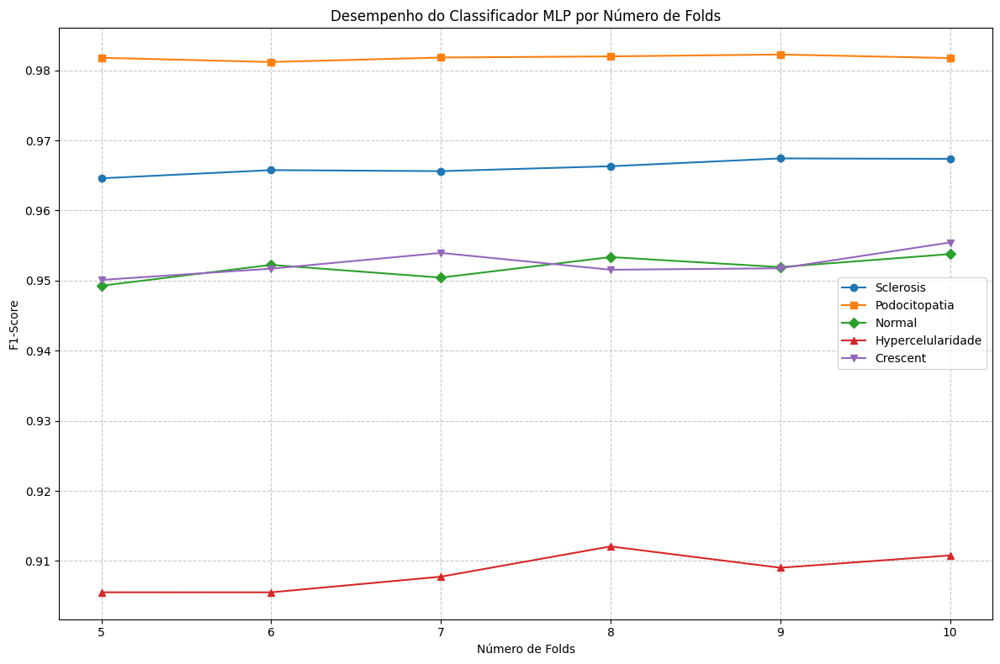

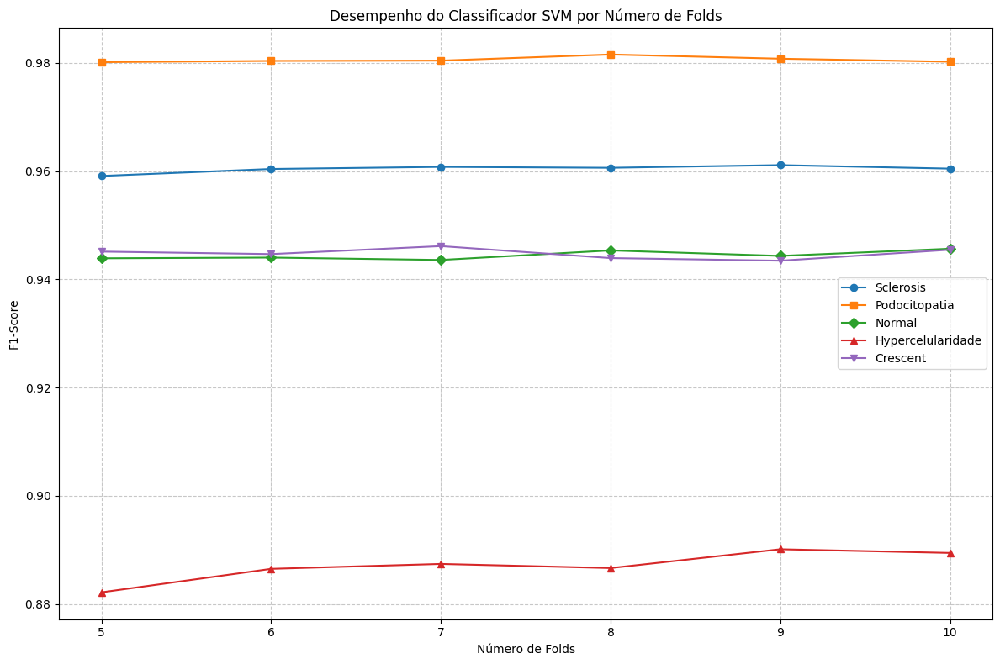

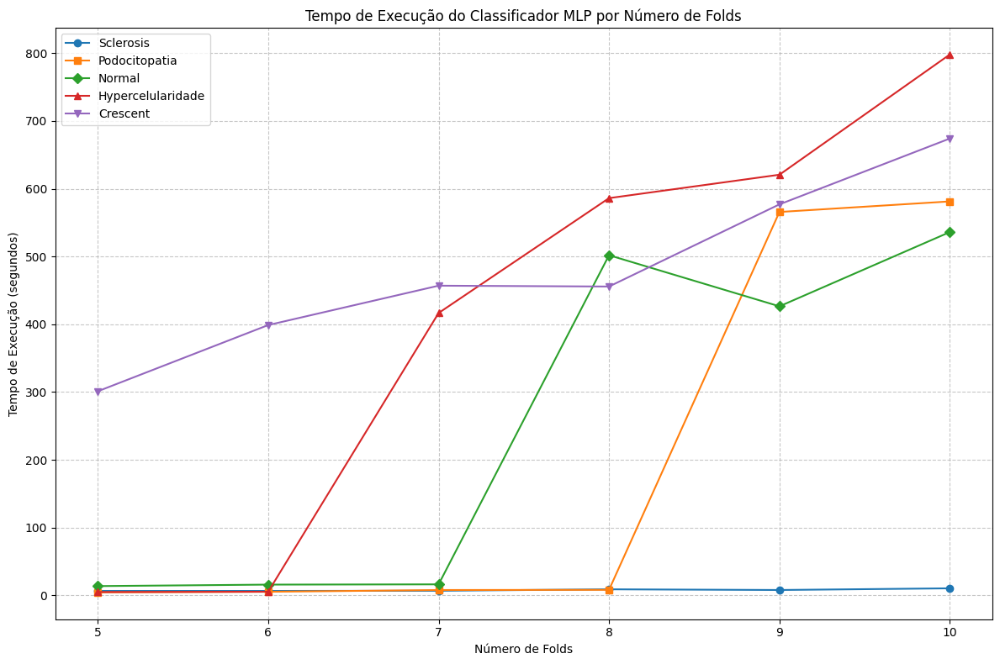

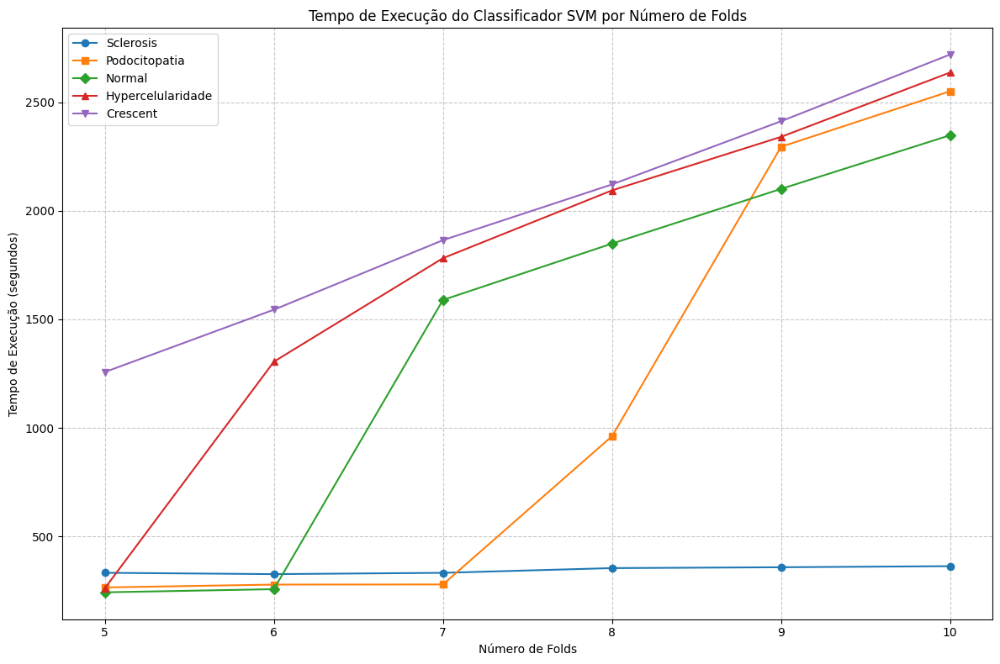

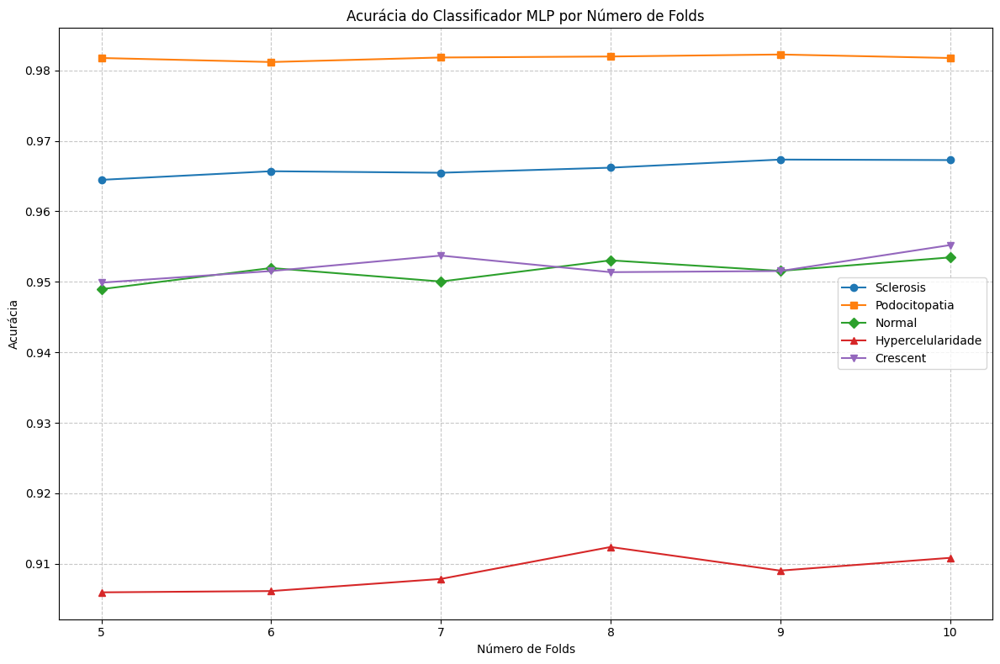

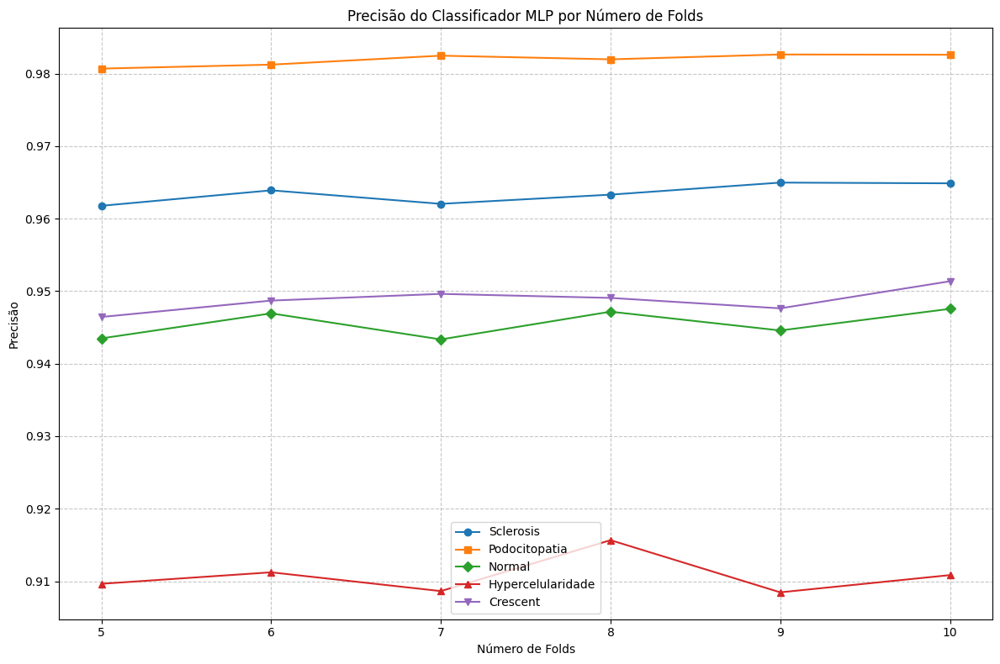

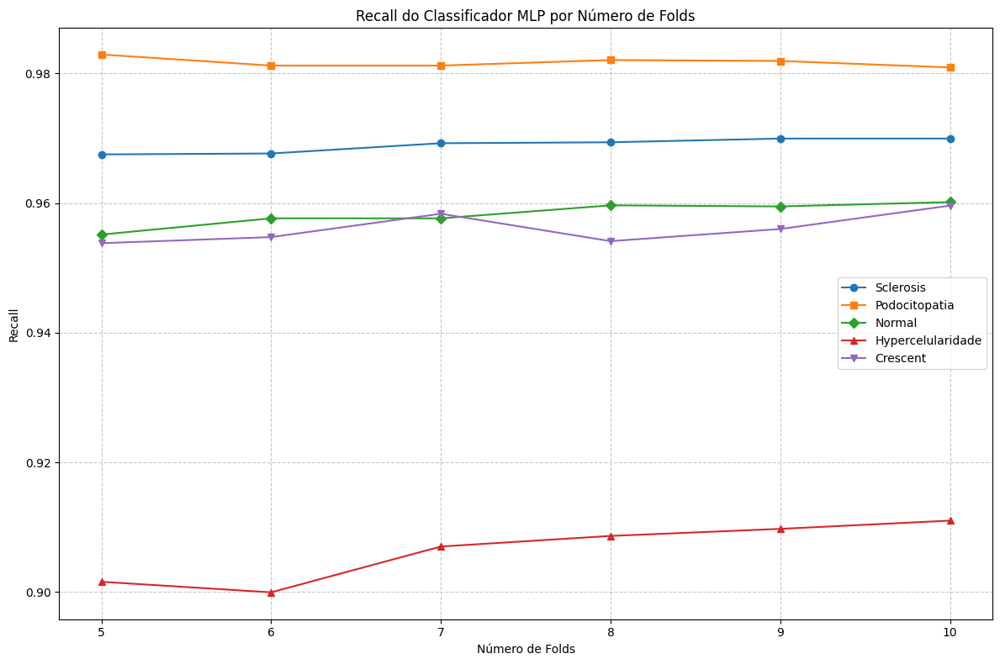

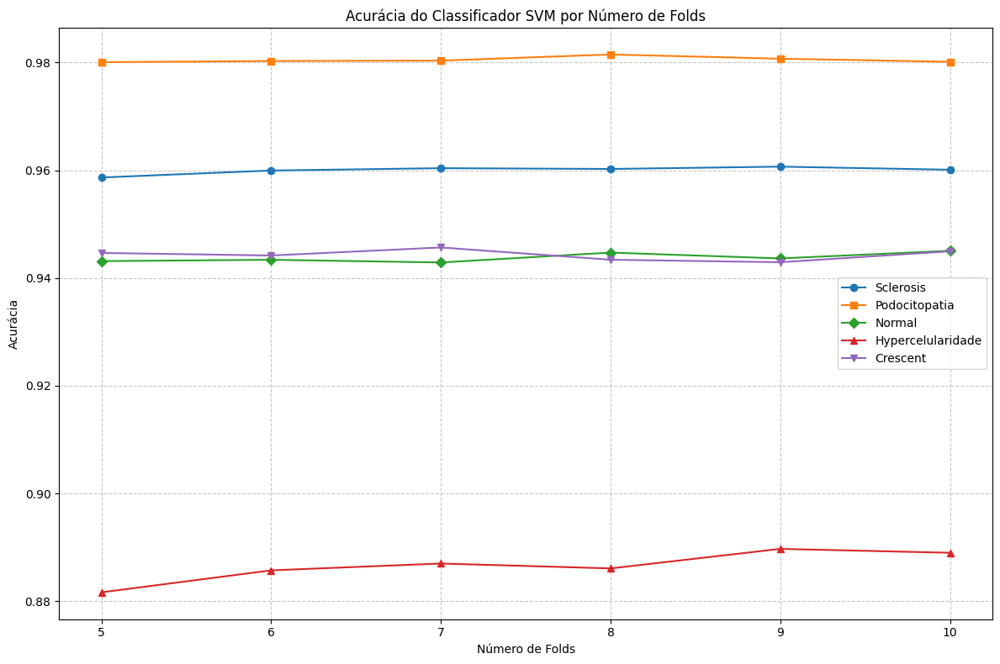

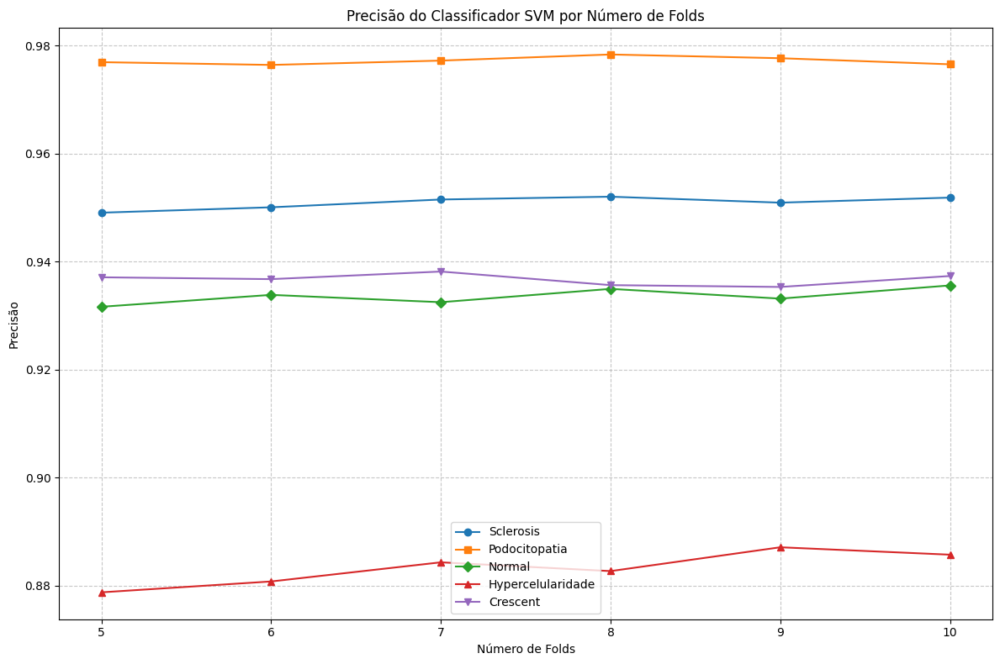

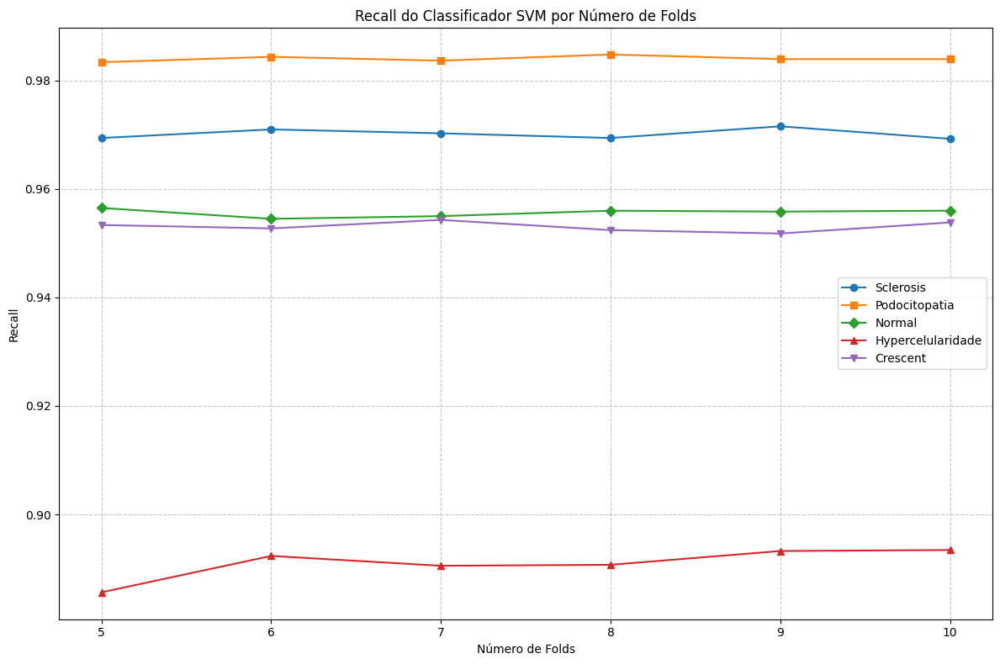

Erro ao gerar gráficos: name 'plot_results_plotly' is not defined

                RESULTADOS F1-SCORE POR FOLD - CLASSIFICADOR MLP                

Tabela de F1-Score por Número de Folds - MLP:
Folds                  5       6       7       8       9       10
Classe                                                           
Crescent           0.9501  0.9517  0.9540  0.9515  0.9518  0.9554
Hypercelularidade  0.9055  0.9055  0.9078  0.9121  0.9090  0.9108
Normal             0.9493  0.9522  0.9504  0.9534  0.9519  0.9538
Podocitopatia      0.9818  0.9812  0.9818  0.9820  0.9823  0.9817
Sclerosis          0.9646  0.9658  0.9656  0.9663  0.9674  0.9674

Resultados salvos em 'resultados_f1_score_MLP.csv'

Tabela Detalhada - MLP:
               Classe  Folds  F1-Score
24           Crescent      5    0.9501
25           Crescent      6    0.9517
26           Crescent      7    0.9540
27           Crescent      8    0.9515
28           Crescent      9    0.9518
29           Crescent     10    

In [ ]:
import os
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score, accuracy_score, precision_score, recall_score, confusion_matrix
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import time
import sys
import pickle
import json
from datetime import datetime

# Diretório para salvar os checkpoints
CHECKPOINT_DIR = "checkpoints"
MODEL_DIR = os.path.join(CHECKPOINT_DIR, "models")
RESULTS_DIR = os.path.join(CHECKPOINT_DIR, "results")
CONFUSION_MATRIX_DIR = os.path.join(CHECKPOINT_DIR, "confusion_matrices")

def ensure_dirs_exist():
    """Cria diretórios necessários se não existirem"""
    for directory in [CHECKPOINT_DIR, MODEL_DIR, RESULTS_DIR, CONFUSION_MATRIX_DIR]:
        if not os.path.exists(directory):
            os.makedirs(directory)
            print(f"Diretório criado: {directory}")

def check_file_paths(file_paths):
    """
    Verifica se todos os caminhos de arquivo existem.

    Args:
        file_paths: Lista de caminhos de arquivo para verificar

    Returns:
        bool: True se todos os arquivos existem, False caso contrário
    """
    all_exist = True
    for path in file_paths:
        if not os.path.exists(path):
            print(f"ERRO: O arquivo '{path}' não existe.")
            all_exist = False

        # Verificar também se o arquivo de informações existe
        if all_exist:
            base_name, ext = os.path.splitext(path)
            info_path = f"{base_name}_info{ext}"
            if not os.path.exists(info_path):
                print(f"ERRO: O arquivo de informações '{info_path}' não existe.")
                all_exist = False

    return all_exist

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.
    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings
    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"
    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])
    # Carregar embeddings do arquivo memmap principal
    fp = np.memmap(pickle_path, mode='r')
    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    num_samples = len(file_refs)
    embed_dim = len(fp) // num_samples
    print(f"-Quantidade de Embeddings: {embed_dim}")
    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim
    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)
    return embeds, labels, classes, file_refs, model

def prepare_binary_classification_data(embeds, labels, classes, target_class):
    """
    Prepara os dados para classificação binária, onde a classe alvo é 1 e todas as outras são 0.
    Args:
        embeds: Embeddings dos dados
        labels: Labels dos dados (one-hot encoded ou não)
        classes: Lista de nomes das classes
        target_class: Nome da classe alvo
    Returns:
        tuple: (X, y) onde X são os embeddings e y são as labels binárias
    """
    # Encontrar o índice da classe alvo
    if target_class not in classes:
        raise ValueError(f"A classe '{target_class}' não foi encontrada na lista de classes.")

    target_idx = classes.index(target_class)

    # Verificar a forma do array de labels
    print(f"Forma do array de labels: {labels.shape}")

    # Verificar se as labels estão no formato one-hot ou não
    if len(labels.shape) == 2 and labels.shape[1] == len(classes):
        # Labels estão em formato one-hot
        y_binary = labels[:, target_idx].astype(int)
    elif len(labels.shape) == 2 and labels.shape[1] == 1:
        # Labels estão em formato de índice único por linha
        y_binary = (labels.flatten() == target_idx).astype(int)
    else:
        # Tentar interpretar as labels de outra forma
        # Assumir que labels contém os índices das classes
        y_binary = np.zeros(len(labels), dtype=int)
        for i in range(len(labels)):
            # Se o valor em labels[i] corresponder ao índice da classe alvo
            if np.any(labels[i] == target_idx):
                y_binary[i] = 1

    print(f"Distribuição de classes binárias: {np.bincount(y_binary)}")
    return embeds, y_binary

def get_checkpoint_filename(data_file, target_class, classifier_type, n_folds):
    """
    Gera um nome de arquivo para checkpoint baseado nos parâmetros

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds

    Returns:
        str: Nome do arquivo de checkpoint
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    checkpoint_name = f"{base_name}_{safe_class_name}_{classifier_type}_{n_folds}folds"

    return checkpoint_name

def save_model(clf, data_file, target_class, classifier_type, n_folds, fold_idx):
    """
    Salva um modelo treinado em um arquivo

    Args:
        clf: Modelo treinado
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds
        fold_idx: Índice do fold atual
    """
    checkpoint_name = get_checkpoint_filename(data_file, target_class, classifier_type, n_folds)
    filename = os.path.join(MODEL_DIR, f"{checkpoint_name}_fold{fold_idx+1}.pkl")

    with open(filename, 'wb') as f:
        pickle.dump(clf, f)

    print(f"Modelo {classifier_type} salvo: {filename}")

def load_model(data_file, target_class, classifier_type, n_folds, fold_idx):
    """
    Carrega um modelo treinado de um arquivo

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds
        fold_idx: Índice do fold atual

    Returns:
        object: Modelo carregado ou None se não existir
    """
    checkpoint_name = get_checkpoint_filename(data_file, target_class, classifier_type, n_folds)
    filename = os.path.join(MODEL_DIR, f"{checkpoint_name}_fold{fold_idx+1}.pkl")

    if os.path.exists(filename):
        try:
            with open(filename, 'rb') as f:
                clf = pickle.load(f)
            print(f"Modelo {classifier_type} carregado: {filename}")
            return clf
        except Exception as e:
            print(f"Erro ao carregar modelo {filename}: {e}")
            return None

    return None

def plot_confusion_matrix(cm, class_names, classifier_type, data_file, target_class, n_folds, fold_idx):
    """
    Plota e salva a matriz de confusão

    Args:
        cm: Matriz de confusão
        class_names: Nomes das classes (target e others)
        classifier_type: Tipo do classificador (MLP ou SVM)
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        n_folds: Número de folds
        fold_idx: Índice do fold atual

    Returns:
        str: Caminho do arquivo salvo
    """
    checkpoint_name = get_checkpoint_filename(data_file, target_class, classifier_type, n_folds)
    filename = os.path.join(CONFUSION_MATRIX_DIR, f"{checkpoint_name}_fold{fold_idx+1}_cm.png")

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix - {classifier_type} - {target_class} - Fold {fold_idx+1}')
    plt.tight_layout()
    plt.savefig(filename, dpi=300)
    plt.close()

    return filename

def save_results(results, data_file, target_class):
    """
    Salva os resultados de avaliação em um arquivo JSON

    Args:
        results: Dicionário de resultados
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    filename = os.path.join(RESULTS_DIR, f"{base_name}_{safe_class_name}_results.json")

    # Converter arrays numpy para listas para salvar em JSON
    serializable_results = {}
    for clf_type, clf_results in results.items():
        serializable_results[clf_type] = {
            'scores': [float(score) for score in clf_results['scores']],
            'times': [float(time_val) for time_val in clf_results['times']],
            'fold_scores': [[float(score) for score in fold_list] for fold_list in clf_results['fold_scores']],
            'fold_metrics': clf_results.get('fold_metrics', []),
            'confusion_matrices': clf_results.get('confusion_matrices', [])
        }

    with open(filename, 'w') as f:
        json.dump(serializable_results, f, indent=2)

    print(f"Resultados salvos: {filename}")

def load_results(data_file, target_class):
    """
    Carrega os resultados de avaliação de um arquivo JSON

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo

    Returns:
        dict: Dicionário de resultados ou None se não existir
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    filename = os.path.join(RESULTS_DIR, f"{base_name}_{safe_class_name}_results.json")

    if os.path.exists(filename):
        try:
            with open(filename, 'r') as f:
                results = json.load(f)
            print(f"Resultados carregados: {filename}")
            return results
        except Exception as e:
            print(f"Erro ao carregar resultados {filename}: {e}")
            return None

    return None

def calculate_metrics(y_true, y_pred):
    """
    Calcula todas as métricas necessárias

    Args:
        y_true: Labels verdadeiras
        y_pred: Labels preditas

    Returns:
        dict: Dicionário com todas as métricas
    """
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)

    # Calculando o F1-Score para 'others' (classe 0)
    y_true_others = 1 - y_true
    y_pred_others = 1 - y_pred
    f1_others = f1_score(y_true_others, y_pred_others, zero_division=0)

    # Calculando a diferença percentual entre o F1-Score da classe alvo e da classe 'others'
    if f1_others > 0:
        f1_diff_percentage = ((f1 - f1_others) / f1_others) * 100
    else:
        f1_diff_percentage = float('inf')

    # Criando a matriz de confusão
    cm = confusion_matrix(y_true, y_pred)

    return {
        'accuracy': float(accuracy),
        'precision': float(precision),
        'recall': float(recall),
        'f1': float(f1),
        'f1_others': float(f1_others),
        'f1_diff_percentage': float(f1_diff_percentage),
        'confusion_matrix': cm.tolist()
    }

def evaluate_classifiers(X, y, data_file, target_class, n_folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Avalia classificadores MLP e SVM usando cross-validation com diferentes números de folds.
    Verifica se já existem resultados salvos antes de treinar novamente.

    Args:
        X: Features (embeddings)
        y: Labels binárias
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        n_folds_list: Lista de números de folds para cross-validation

    Returns:
        dict: Resultados de métricas e tempos de execução para cada classificador e número de folds
    """
    # Verificar se já temos resultados salvos para esta classe alvo
    existing_results = load_results(data_file, target_class)
    if existing_results is not None:
        print(f"Utilizando resultados previamente calculados para {target_class}")
        return existing_results

    # Criar diretórios necessários
    ensure_dirs_exist()

    # Padronizar os dados
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    results = {
        'MLP': {
            'scores': [],
            'times': [],
            'fold_scores': [],
            'fold_metrics': [],
            'confusion_matrices': []
        },
        'SVM': {
            'scores': [],
            'times': [],
            'fold_scores': [],
            'fold_metrics': [],
            'confusion_matrices': []
        }
    }

    # Configuração otimizada do MLP para melhor velocidade
    mlp_config = {
        'hidden_layer_sizes': (100,),      # Tamanho fixo simplificado
        'activation': 'relu',              # ReLU é geralmente mais rápido
        'solver': 'adam',                  # Adam converge mais rápido
        'alpha': 0.01,                     # Aumentado para regularização mais forte
        'batch_size': 'auto',              # Auto-ajuste do tamanho do batch
        'learning_rate': 'constant',       # Taxa constante é mais previsível
        'learning_rate_init': 0.001,       # Taxa padrão
        'max_iter': 100,                   # Reduzido para convergência mais rápida
        'tol': 1e-3,                       # Tolerância aumentada
        'early_stopping': True,            # Para antecipadamente se não houver melhoria
        'validation_fraction': 0.1,        # Fração para validação
        'n_iter_no_change': 10,            # Para após 10 iterações sem melhoria
        'random_state': 42
    }

    svm_config = {
        'kernel': 'linear',
        'C': 1.0,
        'gamma': 'auto',
        'random_state': 42,
        'probability': False
    }

    # Nomes das classes para a matriz de confusão
    class_names = [f"Others", f"{target_class}"]

    # Para cada configuração de número de folds
    for n_folds in n_folds_list:
        print(f"Executando cross-validation com {n_folds} folds...")

        # Criar estratégia de cross-validation para poder acessar cada fold
        skf = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=42)

        # Avaliar MLP
        mlp_start_time = time.time()
        mlp_fold_scores = []
        mlp_fold_metrics = []
        mlp_confusion_matrices = []

        print(f"\n  MLP - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            # Verificar se já temos o modelo treinado para este fold
            mlp_clf = load_model(data_file, target_class, 'MLP', n_folds, fold_idx)

            if mlp_clf is None:
                print(f"    Treinando MLP para fold {fold_idx+1}/{n_folds}...")
                X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
                y_train, y_test = y[train_idx], y[test_idx]

                # Usar a configuração otimizada do MLP
                mlp_clf = MLPClassifier(**mlp_config)
                mlp_clf.fit(X_train, y_train)

                # Salvar o modelo treinado
                save_model(mlp_clf, data_file, target_class, 'MLP', n_folds, fold_idx)
            else:
                # Usar o modelo carregado para predição
                X_test = X_scaled[test_idx]
                y_test = y[test_idx]

            y_pred = mlp_clf.predict(X_test)

            # Calcular métricas completas
            metrics = calculate_metrics(y_test, y_pred)
            mlp_fold_scores.append(metrics['f1'])
            mlp_fold_metrics.append(metrics)

            # Plotar e salvar a matriz de confusão
            cm_path = plot_confusion_matrix(
                np.array(metrics['confusion_matrix']),
                class_names,
                'MLP',
                data_file,
                target_class,
                n_folds,
                fold_idx
            )

            # Adicionar o caminho da matriz de confusão aos resultados
            metrics['confusion_matrix_path'] = cm_path
            mlp_confusion_matrices.append(cm_path)

            print(f"    Fold {fold_idx+1}:")
            print(f"      Acurácia: {metrics['accuracy']:.4f}")
            print(f"      Precisão: {metrics['precision']:.4f}")
            print(f"      Recall: {metrics['recall']:.4f}")
            print(f"      F1-Score: {metrics['f1']:.4f} ± {metrics['f1_diff_percentage']:.2f}% (vs Others)")
            print(f"      Matriz de confusão salva em: {cm_path}")

        mlp_end_time = time.time()
        mlp_time = mlp_end_time - mlp_start_time

        mlp_mean_score = np.mean(mlp_fold_scores)
        results['MLP']['scores'].append(mlp_mean_score)
        results['MLP']['times'].append(mlp_time)
        results['MLP']['fold_scores'].append(mlp_fold_scores)
        results['MLP']['fold_metrics'].append(mlp_fold_metrics)
        results['MLP']['confusion_matrices'].append(mlp_confusion_matrices)

        print(f"  - MLP média f1-score: {mlp_mean_score:.4f}, tempo: {mlp_time:.2f} segundos")

        # Avaliar SVM
        svm_start_time = time.time()
        svm_fold_scores = []
        svm_fold_metrics = []
        svm_confusion_matrices = []

        print(f"\n  SVM - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            # Verificar se já temos o modelo treinado para este fold
            svm_clf = load_model(data_file, target_class, 'SVM', n_folds, fold_idx)

            if svm_clf is None:
                print(f"    Treinando SVM para fold {fold_idx+1}/{n_folds}...")
                X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
                y_train, y_test = y[train_idx], y[test_idx]

                # Usar a configuração do SVM
                svm_clf = SVC(**svm_config)
                svm_clf.fit(X_train, y_train)

                # Salvar o modelo treinado
                save_model(svm_clf, data_file, target_class, 'SVM', n_folds, fold_idx)
            else:
                # Usar o modelo carregado para predição
                X_test = X_scaled[test_idx]
                y_test = y[test_idx]

            y_pred = svm_clf.predict(X_test)

            # Calcular métricas completas
            metrics = calculate_metrics(y_test, y_pred)
            svm_fold_scores.append(metrics['f1'])
            svm_fold_metrics.append(metrics)

            # Plotar e salvar a matriz de confusão
            cm_path = plot_confusion_matrix(
                np.array(metrics['confusion_matrix']),
                class_names,
                'SVM',
                data_file,
                target_class,
                n_folds,
                fold_idx
            )

            # Adicionar o caminho da matriz de confusão aos resultados
            metrics['confusion_matrix_path'] = cm_path
            svm_confusion_matrices.append(cm_path)

            print(f"    Fold {fold_idx+1}:")
            print(f"      Acurácia: {metrics['accuracy']:.4f}")
            print(f"      Precisão: {metrics['precision']:.4f}")
            print(f"      Recall: {metrics['recall']:.4f}")
            print(f"      F1-Score: {metrics['f1']:.4f} ± {metrics['f1_diff_percentage']:.2f}% (vs Others)")
            print(f"      Matriz de confusão salva em: {cm_path}")

        svm_end_time = time.time()
        svm_time = svm_end_time - svm_start_time

        svm_mean_score = np.mean(svm_fold_scores)
        results['SVM']['scores'].append(svm_mean_score)
        results['SVM']['times'].append(svm_time)
        results['SVM']['fold_scores'].append(svm_fold_scores)
        results['SVM']['fold_metrics'].append(svm_fold_metrics)
        results['SVM']['confusion_matrices'].append(svm_confusion_matrices)

        print(f"  - SVM média f1-score: {svm_mean_score:.4f}, tempo: {svm_time:.2f} segundos")

        # Salvar resultados parciais após cada configuração de fold
        save_results(results, data_file, target_class)

    return results

def print_detailed_metrics(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Imprime um quadro detalhado com todas as métricas (Acurácia, Precisão, Recall, F1-Score)
    para cada classe alvo, fold e classificador.

    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']
    metrics_names = ['accuracy', 'precision', 'recall', 'f1']

    for clf in classifiers:
        print("\n" + "="*100)
        print(f"RESULTADOS DETALHADOS - CLASSIFICADOR {clf}".center(100))
        print("="*100)

        for class_name, model_results in results_dict.items():
            if clf in model_results and 'fold_metrics' in model_results[clf]:
                print(f"\nClasse Alvo: {class_name}")

                for i, n_folds in enumerate(folds_list):
                    if i < len(model_results[clf]['fold_metrics']):
                        fold_metrics = model_results[clf]['fold_metrics'][i]

                        print(f"\n  {n_folds} folds:")

                        # Criar um DataFrame para exibir os resultados em formato tabular
                        metrics_data = []
                        for fold_idx, metrics in enumerate(fold_metrics):
                            row = {
                                'Fold': fold_idx + 1,
                                'Acurácia': metrics['accuracy'],
                                'Precisão': metrics['precision'],
                                'Recall': metrics['recall'],
                                'F1-Score': metrics['f1'],
                                'Diferença F1 (%)': metrics['f1_diff_percentage']
                            }
                            metrics_data.append(row)

                        # Criar o DataFrame e formatá-lo
                        df = pd.DataFrame(metrics_data)
                        print(df.round(4).to_string(index=False))

                        # Calcular e mostrar médias
                        means = df.mean().round(4)
                        print("\n  Médias:")
                        for metric in ['Acurácia', 'Precisão', 'Recall', 'F1-Score', 'Diferença F1 (%)']:
                            print(f"    {metric}: {means[metric]:.4f}")

                        # Exportar para CSV
                        csv_filename = f'resultados_detalhados_{clf}_{class_name.replace(" ", "_")}_{n_folds}folds.csv'
                        df.to_csv(csv_filename, index=False)
                        print(f"\n  Resultados detalhados salvos em '{csv_filename}'")

def print_tabular_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Imprime os resultados de f1-score em formato tabulado para cada classe alvo e número de folds,
    separando os resultados por classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        print("\n" + "="*80)
        print(f"RESULTADOS F1-SCORE POR FOLD - CLASSIFICADOR {clf}".center(80))
        print("="*80)

        # Preparar dados para pandas DataFrame
        rows = []

        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                for i, n_folds in enumerate(folds_list):
                    if i < len(scores):
                        row = {
                            'Classe': class_name,
                            'Folds': n_folds,
                            'F1-Score': scores[i]
                        }
                        rows.append(row)

        # Criar e exibir DataFrame
        df = pd.DataFrame(rows)

        # Formatar para mostrar tabela pivotada mais legível
        pivot_df = df.pivot_table(
            index=['Classe'],
            columns='Folds',
            values='F1-Score',
            aggfunc='first'
        )

        print(f"\nTabela de F1-Score por Número de Folds - {clf}:")
        print(pivot_df.round(4))

        # Exportar para CSV
        csv_filename = f'resultados_f1_score_{clf}.csv'
        pivot_df.to_csv(csv_filename)
        print(f"\nResultados salvos em '{csv_filename}'")

        # Mostrar tabela detalhada com todas as informações
        print(f"\nTabela Detalhada - {clf}:")
        pd.set_option('display.max_rows', None)
        pd.set_option('display.width', 120)
        print(df.sort_values(by=['Classe', 'Folds']).round(4))

        print("\n" + "="*80)

def plot_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score para cada classe alvo e número de folds,
    gerando gráficos separados para cada classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        # Gráfico de F1-Score para o classificador atual
        plt.figure(figsize=(12, 8))

        colors = plt.cm.tab10.colors
        markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'h']

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                label = f"{class_name}"
                plt.plot(folds_list, scores, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('F1-Score')
        plt.title(f'Desempenho do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_f1_score_{clf}.png', dpi=300)
        plt.show()

    # Gráficos de tempo de execução separados para cada classificador
    for clf in classifiers:
        plt.figure(figsize=(12, 8))

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                times = model_results[clf]['times']
                label = f"{class_name}"
                plt.plot(folds_list, times, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('Tempo de Execução (segundos)')
        plt.title(f'Tempo de Execução do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_tempo_{clf}.png', dpi=300)
        plt.show()

    # Gráficos adicionais para as métricas de desempenho (acurácia, precisão, recall)
    metrics_to_plot = {
        'accuracy': 'Acurácia',
        'precision': 'Precisão',
        'recall': 'Recall'
    }

    for clf in classifiers:
        for metric_key, metric_name in metrics_to_plot.items():
            plt.figure(figsize=(12, 8))

            color_idx = 0
            for class_name, model_results in results_dict.items():
                if (clf in model_results and
                    'fold_metrics' in model_results[clf] and
                    len(model_results[clf]['fold_metrics']) > 0):

                    # Extrair médias da métrica para cada configuração de fold
                    metric_values = []
                    for fold_metrics_list in model_results[clf]['fold_metrics']:
                        # Calcular a média da métrica em todos os folds desta configuração
                        avg_metric = np.mean([m[metric_key] for m in fold_metrics_list])
                        metric_values.append(avg_metric)

                    if len(metric_values) == len(folds_list):
                        label = f"{class_name}"
                        plt.plot(folds_list, metric_values,
                                marker=markers[color_idx % len(markers)],
                                label=label, color=colors[color_idx % len(colors)])
                        color_idx += 1

            plt.xlabel('Número de Folds')
            plt.ylabel(metric_name)
            plt.title(f'{metric_name} do Classificador {clf} por Número de Folds')
            plt.grid(True, linestyle='--', alpha=0.7)
            plt.legend(loc='best')
            plt.tight_layout()
            plt.savefig(f'resultados_{metric_key}_{clf}.png', dpi=300)
            plt.show()


def load_all_results_for_file(data_file, target_classes):
    """
    Carrega todos os resultados salvos para um determinado arquivo de dados e classes alvo

    Args:
        data_file: Caminho do arquivo de dados
        target_classes: Lista de classes alvo

    Returns:
        dict: Dicionário com todos os resultados carregados
    """
    all_results = {}

    for target_class in target_classes:
        results = load_results(data_file, target_class)
        if results is not None:
            all_results[target_class] = results

    return all_results

def main():
    # Garantir que os diretórios necessários existam
    ensure_dirs_exist()

    # Registrar data/hora de início
    start_time = datetime.now()
    print(f"Iniciando processamento em: {start_time.strftime('%Y-%m-%d %H:%M:%S')}")

    # Definir o conjunto de caminhos dos arquivos
    file_paths = [
        "Data/Sclerosis/UNI/UNI.npy",
        "Data/Podocitopatia/UNI/UNI.npy",
        "Data/Normal/UNI/UNI.npy",
        "Data/Hypercelularidade/UNI/UNI.npy",
        "Data/Crescent/UNI/UNI.npy",
        # Adicione mais caminhos conforme necessário
    ]

    # Verificar se os arquivos existem
    if not check_file_paths(file_paths):
        print("ERRO: Verifique os caminhos dos arquivos e tente novamente.")
        return

    # Dicionário para armazenar resultados para todas as classes alvo
    all_results = {}
    n_folds_list = [5, 6, 7, 8, 9, 10]

    # Criar um arquivo de log para registro de progresso
    log_file = os.path.join(CHECKPOINT_DIR, f"log_{start_time.strftime('%Y%m%d_%H%M%S')}.txt")

    with open(log_file, 'w') as log:
        log.write(f"Início do processamento: {start_time}\n")
        log.write(f"Arquivos a processar: {file_paths}\n\n")

    for file_path in file_paths:
        print(f"\nProcessando arquivo: {file_path}")

        with open(log_file, 'a') as log:
            log.write(f"\nProcessando arquivo: {file_path} - {datetime.now()}\n")

        try:
            # Carregar os embeddings
            embeds, labels, classes, file_refs, model = load_embed(file_path)
            print(f"Embeddings carregados com sucesso:")
            print(f"- Formato dos embeddings: {embeds.shape}")
            print(f"- Número de classes: {len(classes)}")
            print(f"- Classes: {classes}")
            print(f"- Formato das labels: {labels.shape}")
            print(f"- Modelo usado: {model}")

            # Identificar classes alvo (todas exceto "others")
            target_classes = [c for c in classes if c.lower() != "others"]

            # Se não houver classes alvo, usar todas as classes exceto a primeira (presumindo que seja "others")
            if not target_classes and len(classes) > 1:
                print("Nenhuma classe 'others' encontrada. Usando todas as classes exceto a primeira.")
                target_classes = classes[1:]
            # Se apenas uma classe, usar essa classe
            elif not target_classes and len(classes) == 1:
                print("Apenas uma classe encontrada. Usando-a como classe alvo.")
                target_classes = classes

            print(f"Classes alvo identificadas: {target_classes}")

            # Verificar primeiramente se já temos resultados salvos para este arquivo
            file_results = load_all_results_for_file(file_path, target_classes)
            if file_results and len(file_results) == len(target_classes):
                print(f"Todos os resultados para {file_path} já estão disponíveis. Usando dados existentes.")
                # Adicionar os resultados existentes ao dicionário geral
                all_results.update(file_results)
                continue

            # Para cada classe alvo, criar e avaliar classificadores binários
            for target_class in target_classes:
                print(f"\nCriando classificadores binários para a classe alvo: {target_class}")

                with open(log_file, 'a') as log:
                    log.write(f"  Processando classe: {target_class} - {datetime.now()}\n")

                # Verificar se já temos resultados para esta classe
                if target_class in file_results:
                    print(f"Resultados para a classe {target_class} já disponíveis. Pulando...")
                    all_results[target_class] = file_results[target_class]
                    continue

                try:
                    # Preparar dados para classificação binária
                    X, y = prepare_binary_classification_data(embeds, labels, classes, target_class)

                    # Verificar se há suficientes exemplos positivos e negativos
                    if len(np.unique(y)) < 2:
                        print(f"AVISO: A classe {target_class} não tem exemplos suficientes de ambas as classes para treinamento.")
                        with open(log_file, 'a') as log:
                            log.write(f"    AVISO: Classe {target_class} sem exemplos suficientes - pulando\n")
                        continue

                    # Avaliar classificadores
                    results = evaluate_classifiers(X, y, file_path, target_class, n_folds_list)

                    # Armazenar resultados
                    all_results[target_class] = results

                    # Registrar conclusão no log
                    with open(log_file, 'a') as log:
                        log.write(f"    Concluído processamento da classe {target_class} - {datetime.now()}\n")
                except Exception as e:
                    print(f"Erro ao processar a classe {target_class}: {e}")
                    with open(log_file, 'a') as log:
                        log.write(f"    ERRO na classe {target_class}: {e} - {datetime.now()}\n")
                    continue

            # Registrar conclusão do arquivo no log
            with open(log_file, 'a') as log:
                log.write(f"Concluído arquivo {file_path} - {datetime.now()}\n")
        except Exception as e:
            print(f"Erro ao processar o arquivo {file_path}: {e}")
            with open(log_file, 'a') as log:
                log.write(f"ERRO no arquivo {file_path}: {e} - {datetime.now()}\n")
            continue

    # Verificar se temos resultados para plotar
    if not all_results:
        print("Nenhum resultado foi gerado para plotagem.")
        return

    # Plotar resultados
    print("\nGerando gráficos dos resultados...")
    try:
        plot_results(all_results, n_folds_list)
        plot_results_plotly(all_results, n_folds_list)
    except Exception as e:
        print(f"Erro ao gerar gráficos: {e}")
        with open(log_file, 'a') as log:
            log.write(f"ERRO ao gerar gráficos: {e} - {datetime.now()}\n")

    # Imprimir resultados em formato tabulado
    try:
        print_tabular_results(all_results, n_folds_list)
    except Exception as e:
        print(f"Erro ao gerar tabelas: {e}")
        with open(log_file, 'a') as log:
            log.write(f"ERRO ao gerar tabelas: {e} - {datetime.now()}\n")

    # Registrar data/hora de término
    end_time = datetime.now()
    duration = end_time - start_time
    print(f"\nProcessamento concluído em {end_time.strftime('%Y-%m-%d %H:%M:%S')}")
    print(f"Duração total: {duration}")
    with open(log_file, 'a') as log:
        log.write(f"\nProcessamento concluído: {end_time}\n")
        log.write(f"Duração total: {duration}\n")

if __name__ == "__main__":
    main()

In [7]:
import os
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score, accuracy_score, precision_score, recall_score, confusion_matrix
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import time
import sys
import pickle
import json
from datetime import datetime

# Diretório para salvar os checkpoints
CHECKPOINT_DIR = "checkpoints"
MODEL_DIR = os.path.join(CHECKPOINT_DIR, "models")
RESULTS_DIR = os.path.join(CHECKPOINT_DIR, "results")
CONFUSION_MATRIX_DIR = os.path.join(CHECKPOINT_DIR, "confusion_matrices")

MODEL_NAME_TO_OUTPUT_DIM = {
    "uni": 1024,
    "uni2": 1536,
    "phikon": 768,
    "phikonv2": 1024
}

def ensure_dirs_exist():
    """Cria diretórios necessários se não existirem"""
    for directory in [CHECKPOINT_DIR, MODEL_DIR, RESULTS_DIR, CONFUSION_MATRIX_DIR]:
        if not os.path.exists(directory):
            os.makedirs(directory)
            print(f"Diretório criado: {directory}")

def check_file_paths(file_paths):
    """
    Verifica se todos os caminhos de arquivo existem.

    Args:
        file_paths: Lista de caminhos de arquivo para verificar

    Returns:
        bool: True se todos os arquivos existem, False caso contrário
    """
    all_exist = True
    for path in file_paths:
        if not os.path.exists(path):
            print(f"ERRO: O arquivo '{path}' não existe.")
            all_exist = False

        # Verificar também se o arquivo de informações existe
        if all_exist:
            base_name, ext = os.path.splitext(path)
            info_path = f"{base_name}_info{ext}"
            if not os.path.exists(info_path):
                print(f"ERRO: O arquivo de informações '{info_path}' não existe.")
                all_exist = False

    return all_exist

def load_embed(pickle_path: str) -> tuple:
    """
    Carrega embeddings e informações relacionadas de um arquivo pickle.
    Args:
        pickle_path: Caminho para o arquivo pickle contendo os embeddings
    Returns:
        tuple: (embeddings, labels, classes, file_refs, model)
    """
    # Preparar caminho para o arquivo de informações
    base_name, ext = os.path.splitext(pickle_path)
    info_path = f"{base_name}_info{ext}"
    # Carregar metadados do arquivo de informações
    data = np.load(info_path, allow_pickle=True).tolist()
    model = data['model']
    file_refs = data['fnames']
    classes = data['classes']
    labels = np.vstack(data['labels'])
    # Carregar embeddings do arquivo memmap principal
    num_samples = len(file_refs)
    print(file_refs)
    embed_dim = MODEL_NAME_TO_OUTPUT_DIM[model.lower()]
    fp = np.memmap(pickle_path, shape=(num_samples, embed_dim), mode='r')
    # Calcular o tamanho da dimensão do embedding dividindo pelo número de classes
    print("Formato de dataset:", fp.shape)
    print(f"-Quantidade de Embeddings: {embed_dim}")
    # Calculate n_rows based on the actual embed_dim to get the correct number of samples
    n_rows = len(fp) // embed_dim
    # Reshape o memmap baseado no número de classes e na dimensão calculada
    embeds = fp[:n_rows * embed_dim].reshape(n_rows, embed_dim)
    return embeds, labels, classes, file_refs, model

def prepare_binary_classification_data(embeds, labels, classes, target_class):
    """
    Prepara os dados para classificação binária, onde a classe alvo é 1 e todas as outras são 0.
    Args:
        embeds: Embeddings dos dados
        labels: Labels dos dados (one-hot encoded ou não)
        classes: Lista de nomes das classes
        target_class: Nome da classe alvo
    Returns:
        tuple: (X, y) onde X são os embeddings e y são as labels binárias
    """
    # Encontrar o índice da classe alvo
    if target_class not in classes:
        raise ValueError(f"A classe '{target_class}' não foi encontrada na lista de classes.")

    target_idx = classes.index(target_class)

    # Verificar a forma do array de labels
    print(f"Forma do array de labels: {labels.shape}")

    # Verificar se as labels estão no formato one-hot ou não
    if len(labels.shape) == 2 and labels.shape[1] == len(classes):
        # Labels estão em formato one-hot
        y_binary = labels[:, target_idx].astype(int)
    elif len(labels.shape) == 2 and labels.shape[1] == 1:
        # Labels estão em formato de índice único por linha
        y_binary = (labels.flatten() == target_idx).astype(int)
    else:
        # Tentar interpretar as labels de outra forma
        # Assumir que labels contém os índices das classes
        y_binary = np.zeros(len(labels), dtype=int)
        for i in range(len(labels)):
            # Se o valor em labels[i] corresponder ao índice da classe alvo
            if np.any(labels[i] == target_idx):
                y_binary[i] = 1

    print(f"Distribuição de classes binárias: {np.bincount(y_binary)}")
    return embeds, y_binary

def get_checkpoint_filename(data_file, target_class, classifier_type, n_folds):
    """
    Gera um nome de arquivo para checkpoint baseado nos parâmetros

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds

    Returns:
        str: Nome do arquivo de checkpoint
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    checkpoint_name = f"{base_name}_{safe_class_name}_{classifier_type}_{n_folds}folds"

    return checkpoint_name

def save_model(clf, data_file, target_class, classifier_type, n_folds, fold_idx):
    """
    Salva um modelo treinado em um arquivo

    Args:
        clf: Modelo treinado
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds
        fold_idx: Índice do fold atual
    """
    checkpoint_name = get_checkpoint_filename(data_file, target_class, classifier_type, n_folds)
    filename = os.path.join(MODEL_DIR, f"{checkpoint_name}_fold{fold_idx+1}.pkl")

    with open(filename, 'wb') as f:
        pickle.dump(clf, f)

    print(f"Modelo {classifier_type} salvo: {filename}")

def load_model(data_file, target_class, classifier_type, n_folds, fold_idx):
    """
    Carrega um modelo treinado de um arquivo

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        classifier_type: Tipo do classificador (MLP ou SVM)
        n_folds: Número de folds
        fold_idx: Índice do fold atual

    Returns:
        object: Modelo carregado ou None se não existir
    """
    checkpoint_name = get_checkpoint_filename(data_file, target_class, classifier_type, n_folds)
    filename = os.path.join(MODEL_DIR, f"{checkpoint_name}_fold{fold_idx+1}.pkl")

    if os.path.exists(filename):
        try:
            with open(filename, 'rb') as f:
                clf = pickle.load(f)
            print(f"Modelo {classifier_type} carregado: {filename}")
            return clf
        except Exception as e:
            print(f"Erro ao carregar modelo {filename}: {e}")
            return None

    return None

def plot_confusion_matrix(cm, class_names, classifier_type, data_file, target_class, n_folds, fold_idx):
    """
    Plota e salva a matriz de confusão

    Args:
        cm: Matriz de confusão
        class_names: Nomes das classes (target e others)
        classifier_type: Tipo do classificador (MLP ou SVM)
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        n_folds: Número de folds
        fold_idx: Índice do fold atual

    Returns:
        str: Caminho do arquivo salvo
    """
    checkpoint_name = get_checkpoint_filename(data_file, target_class, classifier_type, n_folds)
    filename = os.path.join(CONFUSION_MATRIX_DIR, f"{checkpoint_name}_fold{fold_idx+1}_cm.png")

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix - {classifier_type} - {target_class} - Fold {fold_idx+1}')
    plt.tight_layout()
    plt.savefig(filename, dpi=300)
    plt.close()

    return filename

def save_results(results, data_file, target_class):
    """
    Salva os resultados de avaliação em um arquivo JSON

    Args:
        results: Dicionário de resultados
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    filename = os.path.join(RESULTS_DIR, f"{base_name}_{safe_class_name}_results.json")

    # Converter arrays numpy para listas para salvar em JSON
    serializable_results = {}
    for clf_type, clf_results in results.items():
        serializable_results[clf_type] = {
            'scores': [float(score) for score in clf_results['scores']],
            'times': [float(time_val) for time_val in clf_results['times']],
            'fold_scores': [[float(score) for score in fold_list] for fold_list in clf_results['fold_scores']],
            'fold_metrics': clf_results.get('fold_metrics', []),
            'confusion_matrices': clf_results.get('confusion_matrices', [])
        }

    with open(filename, 'w') as f:
        json.dump(serializable_results, f, indent=2)

    print(f"Resultados salvos: {filename}")

def load_results(data_file, target_class):
    """
    Carrega os resultados de avaliação de um arquivo JSON

    Args:
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo

    Returns:
        dict: Dicionário de resultados ou None se não existir
    """
    # Extrair apenas o nome do arquivo sem o caminho completo e sem a extensão
    base_name = os.path.basename(data_file)
    base_name = os.path.splitext(base_name)[0]

    # Criar um nome de arquivo válido
    safe_class_name = target_class.replace(" ", "_").replace("/", "_")
    filename = os.path.join(RESULTS_DIR, f"{base_name}_{safe_class_name}_results.json")

    if os.path.exists(filename):
        try:
            with open(filename, 'r') as f:
                results = json.load(f)
            print(f"Resultados carregados: {filename}")
            return results
        except Exception as e:
            print(f"Erro ao carregar resultados {filename}: {e}")
            return None

    return None

def calculate_metrics(y_true, y_pred):
    """
    Calcula todas as métricas necessárias

    Args:
        y_true: Labels verdadeiras
        y_pred: Labels preditas

    Returns:
        dict: Dicionário com todas as métricas
    """
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)

    # Calculando o F1-Score para 'others' (classe 0)
    y_true_others = 1 - y_true
    y_pred_others = 1 - y_pred
    f1_others = f1_score(y_true_others, y_pred_others, zero_division=0)

    # Calculando a diferença percentual entre o F1-Score da classe alvo e da classe 'others'
    if f1_others > 0:
        f1_diff_percentage = ((f1 - f1_others) / f1_others) * 100
    else:
        f1_diff_percentage = float('inf')

    # Criando a matriz de confusão
    cm = confusion_matrix(y_true, y_pred)

    return {
        'accuracy': float(accuracy),
        'precision': float(precision),
        'recall': float(recall),
        'f1': float(f1),
        'f1_others': float(f1_others),
        'f1_diff_percentage': float(f1_diff_percentage),
        'confusion_matrix': cm.tolist()
    }

def evaluate_classifiers(X, y, data_file, target_class, n_folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Avalia classificadores MLP e SVM usando cross-validation com diferentes números de folds.
    Verifica se já existem resultados salvos antes de treinar novamente.

    Args:
        X: Features (embeddings)
        y: Labels binárias
        data_file: Nome do arquivo de dados
        target_class: Nome da classe alvo
        n_folds_list: Lista de números de folds para cross-validation

    Returns:
        dict: Resultados de métricas e tempos de execução para cada classificador e número de folds
    """
    # Verificar se já temos resultados salvos para esta classe alvo
    existing_results = load_results(data_file, target_class)
    if existing_results is not None:
        print(f"Utilizando resultados previamente calculados para {target_class}")
        return existing_results

    # Criar diretórios necessários
    ensure_dirs_exist()

    # Padronizar os dados
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    results = {
        'MLP': {
            'scores': [],
            'times': [],
            'fold_scores': [],
            'fold_metrics': [],
            'confusion_matrices': []
        },
        'SVM': {
            'scores': [],
            'times': [],
            'fold_scores': [],
            'fold_metrics': [],
            'confusion_matrices': []
        }
    }

    # Configuração otimizada do MLP para melhor velocidade
    mlp_config = {
        'hidden_layer_sizes': (100,),      # Tamanho fixo simplificado
        'activation': 'relu',              # ReLU é geralmente mais rápido
        'solver': 'adam',                  # Adam converge mais rápido
        'alpha': 0.01,                     # Aumentado para regularização mais forte
        'batch_size': 'auto',              # Auto-ajuste do tamanho do batch
        'learning_rate': 'constant',       # Taxa constante é mais previsível
        'learning_rate_init': 0.001,       # Taxa padrão
        'max_iter': 100,                   # Reduzido para convergência mais rápida
        'tol': 1e-3,                       # Tolerância aumentada
        'early_stopping': True,            # Para antecipadamente se não houver melhoria
        'validation_fraction': 0.1,        # Fração para validação
        'n_iter_no_change': 10,            # Para após 10 iterações sem melhoria
        'random_state': 42
    }

    svm_config = {
        'kernel': 'linear',
        'C': 1.0,
        'gamma': 'auto',
        'random_state': 42,
        'probability': False
    }

    # Nomes das classes para a matriz de confusão
    class_names = [f"Others", f"{target_class}"]

    # Para cada configuração de número de folds
    for n_folds in n_folds_list:
        print(f"Executando cross-validation com {n_folds} folds...")

        # Criar estratégia de cross-validation para poder acessar cada fold
        skf = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=42)

        # Avaliar MLP
        mlp_start_time = time.time()
        mlp_fold_scores = []
        mlp_fold_metrics = []
        mlp_confusion_matrices = []

        print(f"\n  MLP - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            # Verificar se já temos o modelo treinado para este fold
            mlp_clf = load_model(data_file, target_class, 'MLP', n_folds, fold_idx)

            if mlp_clf is None:
                print(f"    Treinando MLP para fold {fold_idx+1}/{n_folds}...")
                X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
                y_train, y_test = y[train_idx], y[test_idx]

                # Usar a configuração otimizada do MLP
                mlp_clf = MLPClassifier(**mlp_config)
                mlp_clf.fit(X_train, y_train)

                # Salvar o modelo treinado
                save_model(mlp_clf, data_file, target_class, 'MLP', n_folds, fold_idx)
            else:
                # Usar o modelo carregado para predição
                X_test = X_scaled[test_idx]
                y_test = y[test_idx]

            y_pred = mlp_clf.predict(X_test)

            # Calcular métricas completas
            metrics = calculate_metrics(y_test, y_pred)
            mlp_fold_scores.append(metrics['f1'])
            mlp_fold_metrics.append(metrics)

            # Plotar e salvar a matriz de confusão
            cm_path = plot_confusion_matrix(
                np.array(metrics['confusion_matrix']),
                class_names,
                'MLP',
                data_file,
                target_class,
                n_folds,
                fold_idx
            )

            # Adicionar o caminho da matriz de confusão aos resultados
            metrics['confusion_matrix_path'] = cm_path
            mlp_confusion_matrices.append(cm_path)

            print(f"    Fold {fold_idx+1}:")
            print(f"      Acurácia: {metrics['accuracy']:.4f}")
            print(f"      Precisão: {metrics['precision']:.4f}")
            print(f"      Recall: {metrics['recall']:.4f}")
            print(f"      F1-Score: {metrics['f1']:.4f} ± {metrics['f1_diff_percentage']:.2f}% (vs Others)")
            print(f"      Matriz de confusão salva em: {cm_path}")

        mlp_end_time = time.time()
        mlp_time = mlp_end_time - mlp_start_time

        mlp_mean_score = np.mean(mlp_fold_scores)
        results['MLP']['scores'].append(mlp_mean_score)
        results['MLP']['times'].append(mlp_time)
        results['MLP']['fold_scores'].append(mlp_fold_scores)
        results['MLP']['fold_metrics'].append(mlp_fold_metrics)
        results['MLP']['confusion_matrices'].append(mlp_confusion_matrices)

        print(f"  - MLP média f1-score: {mlp_mean_score:.4f}, tempo: {mlp_time:.2f} segundos")

        # Avaliar SVM
        svm_start_time = time.time()
        svm_fold_scores = []
        svm_fold_metrics = []
        svm_confusion_matrices = []

        print(f"\n  SVM - {n_folds} folds:")
        for fold_idx, (train_idx, test_idx) in enumerate(skf.split(X_scaled, y)):
            # Verificar se já temos o modelo treinado para este fold
            svm_clf = load_model(data_file, target_class, 'SVM', n_folds, fold_idx)

            if svm_clf is None:
                print(f"    Treinando SVM para fold {fold_idx+1}/{n_folds}...")
                X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
                y_train, y_test = y[train_idx], y[test_idx]

                # Usar a configuração do SVM
                svm_clf = SVC(**svm_config)
                svm_clf.fit(X_train, y_train)

                # Salvar o modelo treinado
                save_model(svm_clf, data_file, target_class, 'SVM', n_folds, fold_idx)
            else:
                # Usar o modelo carregado para predição
                X_test = X_scaled[test_idx]
                y_test = y[test_idx]

            y_pred = svm_clf.predict(X_test)

            # Calcular métricas completas
            metrics = calculate_metrics(y_test, y_pred)
            svm_fold_scores.append(metrics['f1'])
            svm_fold_metrics.append(metrics)

            # Plotar e salvar a matriz de confusão
            cm_path = plot_confusion_matrix(
                np.array(metrics['confusion_matrix']),
                class_names,
                'SVM',
                data_file,
                target_class,
                n_folds,
                fold_idx
            )

            # Adicionar o caminho da matriz de confusão aos resultados
            metrics['confusion_matrix_path'] = cm_path
            svm_confusion_matrices.append(cm_path)

            print(f"    Fold {fold_idx+1}:")
            print(f"      Acurácia: {metrics['accuracy']:.4f}")
            print(f"      Precisão: {metrics['precision']:.4f}")
            print(f"      Recall: {metrics['recall']:.4f}")
            print(f"      F1-Score: {metrics['f1']:.4f} ± {metrics['f1_diff_percentage']:.2f}% (vs Others)")
            print(f"      Matriz de confusão salva em: {cm_path}")

        svm_end_time = time.time()
        svm_time = svm_end_time - svm_start_time

        svm_mean_score = np.mean(svm_fold_scores)
        results['SVM']['scores'].append(svm_mean_score)
        results['SVM']['times'].append(svm_time)
        results['SVM']['fold_scores'].append(svm_fold_scores)
        results['SVM']['fold_metrics'].append(svm_fold_metrics)
        results['SVM']['confusion_matrices'].append(svm_confusion_matrices)

        print(f"  - SVM média f1-score: {svm_mean_score:.4f}, tempo: {svm_time:.2f} segundos")

        # Salvar resultados parciais após cada configuração de fold
        save_results(results, data_file, target_class)

    return results

def print_detailed_metrics(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Imprime um quadro detalhado com todas as métricas (Acurácia, Precisão, Recall, F1-Score)
    para cada classe alvo, fold e classificador.

    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']
    metrics_names = ['accuracy', 'precision', 'recall', 'f1']

    for clf in classifiers:
        print("\n" + "="*100)
        print(f"RESULTADOS DETALHADOS - CLASSIFICADOR {clf}".center(100))
        print("="*100)

        for class_name, model_results in results_dict.items():
            if clf in model_results and 'fold_metrics' in model_results[clf]:
                print(f"\nClasse Alvo: {class_name}")

                for i, n_folds in enumerate(folds_list):
                    if i < len(model_results[clf]['fold_metrics']):
                        fold_metrics = model_results[clf]['fold_metrics'][i]

                        print(f"\n  {n_folds} folds:")

                        # Criar um DataFrame para exibir os resultados em formato tabular
                        metrics_data = []
                        for fold_idx, metrics in enumerate(fold_metrics):
                            row = {
                                'Fold': fold_idx + 1,
                                'Acurácia': metrics['accuracy'],
                                'Precisão': metrics['precision'],
                                'Recall': metrics['recall'],
                                'F1-Score': metrics['f1'],
                                'Diferença F1 (%)': metrics['f1_diff_percentage']
                            }
                            metrics_data.append(row)

                        # Criar o DataFrame e formatá-lo
                        df = pd.DataFrame(metrics_data)
                        print(df.round(4).to_string(index=False))

                        # Calcular e mostrar médias
                        means = df.mean().round(4)
                        print("\n  Médias:")
                        for metric in ['Acurácia', 'Precisão', 'Recall', 'F1-Score', 'Diferença F1 (%)']:
                            print(f"    {metric}: {means[metric]:.4f}")

                        # Exportar para CSV
                        csv_filename = f'resultados_detalhados_{clf}_{class_name.replace(" ", "_")}_{n_folds}folds.csv'
                        df.to_csv(csv_filename, index=False)
                        print(f"\n  Resultados detalhados salvos em '{csv_filename}'")

def print_tabular_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Imprime os resultados de f1-score em formato tabulado para cada classe alvo e número de folds,
    separando os resultados por classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        print("\n" + "="*80)
        print(f"RESULTADOS F1-SCORE POR FOLD - CLASSIFICADOR {clf}".center(80))
        print("="*80)

        # Preparar dados para pandas DataFrame
        rows = []

        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                for i, n_folds in enumerate(folds_list):
                    if i < len(scores):
                        row = {
                            'Classe': class_name,
                            'Folds': n_folds,
                            'F1-Score': scores[i]
                        }
                        rows.append(row)

        # Criar e exibir DataFrame
        df = pd.DataFrame(rows)

        # Formatar para mostrar tabela pivotada mais legível
        pivot_df = df.pivot_table(
            index=['Classe'],
            columns='Folds',
            values='F1-Score',
            aggfunc='first'
        )

        print(f"\nTabela de F1-Score por Número de Folds - {clf}:")
        print(pivot_df.round(4))

        # Exportar para CSV
        csv_filename = f'resultados_f1_score_{clf}.csv'
        pivot_df.to_csv(csv_filename)
        print(f"\nResultados salvos em '{csv_filename}'")

        # Mostrar tabela detalhada com todas as informações
        print(f"\nTabela Detalhada - {clf}:")
        pd.set_option('display.max_rows', None)
        pd.set_option('display.width', 120)
        print(df.sort_values(by=['Classe', 'Folds']).round(4))

        print("\n" + "="*80)

def plot_results(results_dict, folds_list=[5, 6, 7, 8, 9, 10]):
    """
    Plota os resultados de f1-score para cada classe alvo e número de folds,
    gerando gráficos separados para cada classificador.
    Args:
        results_dict: Dicionário contendo os resultados para cada classe alvo e modelo
        folds_list: Lista de números de folds usados
    """
    classifiers = ['MLP', 'SVM']

    for clf in classifiers:
        # Gráfico de F1-Score para o classificador atual
        plt.figure(figsize=(12, 8))

        colors = plt.cm.tab10.colors
        markers = ['o', 's', 'D', '^', 'v', '<', '>', 'p', '*', 'h']

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                scores = model_results[clf]['scores']
                label = f"{class_name}"
                plt.plot(folds_list, scores, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('F1-Score')
        plt.title(f'Desempenho do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_f1_score_{clf}.png', dpi=300)
        plt.show()

    # Gráficos de tempo de execução separados para cada classificador
    for clf in classifiers:
        plt.figure(figsize=(12, 8))

        color_idx = 0
        for class_name, model_results in results_dict.items():
            if clf in model_results:
                times = model_results[clf]['times']
                label = f"{class_name}"
                plt.plot(folds_list, times, marker=markers[color_idx % len(markers)],
                        label=label, color=colors[color_idx % len(colors)])
                color_idx += 1

        plt.xlabel('Número de Folds')
        plt.ylabel('Tempo de Execução (segundos)')
        plt.title(f'Tempo de Execução do Classificador {clf} por Número de Folds')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(loc='best')
        plt.tight_layout()
        plt.savefig(f'resultados_tempo_{clf}.png', dpi=300)
        plt.show()

    # Gráficos adicionais para as métricas de desempenho (acurácia, precisão, recall)
    metrics_to_plot = {
        'accuracy': 'Acurácia',
        'precision': 'Precisão',
        'recall': 'Recall'
    }

    for clf in classifiers:
        for metric_key, metric_name in metrics_to_plot.items():
            plt.figure(figsize=(12, 8))

            color_idx = 0
            for class_name, model_results in results_dict.items():
                if (clf in model_results and
                    'fold_metrics' in model_results[clf] and
                    len(model_results[clf]['fold_metrics']) > 0):

                    # Extrair médias da métrica para cada configuração de fold
                    metric_values = []
                    for fold_metrics_list in model_results[clf]['fold_metrics']:
                        # Calcular a média da métrica em todos os folds desta configuração
                        avg_metric = np.mean([m[metric_key] for m in fold_metrics_list])
                        metric_values.append(avg_metric)

                    if len(metric_values) == len(folds_list):
                        label = f"{class_name}"
                        plt.plot(folds_list, metric_values,
                                marker=markers[color_idx % len(markers)],
                                label=label, color=colors[color_idx % len(colors)])
                        color_idx += 1

            plt.xlabel('Número de Folds')
            plt.ylabel(metric_name)
            plt.title(f'{metric_name} do Classificador {clf} por Número de Folds')
            plt.grid(True, linestyle='--', alpha=0.7)
            plt.legend(loc='best')
            plt.tight_layout()
            plt.savefig(f'resultados_{metric_key}_{clf}.png', dpi=300)
            plt.show()


def load_all_results_for_file(data_file, target_classes):
    """
    Carrega todos os resultados salvos para um determinado arquivo de dados e classes alvo

    Args:
        data_file: Caminho do arquivo de dados
        target_classes: Lista de classes alvo

    Returns:
        dict: Dicionário com todos os resultados carregados
    """
    all_results = {}

    for target_class in target_classes:
        results = load_results(data_file, target_class)
        if results is not None:
            all_results[target_class] = results

    return all_results

def main():
    # Garantir que os diretórios necessários existam
    ensure_dirs_exist()

    # Registrar data/hora de início
    start_time = datetime.now()
    print(f"Iniciando processamento em: {start_time.strftime('%Y-%m-%d %H:%M:%S')}")

    # Definir o conjunto de caminhos dos arquivos
    file_paths = [
        "Data/Sclerosis/UNI/UNI.npy",
        "Data/Podocitopatia/UNI/UNI.npy",
        "Data/Normal/UNI/UNI.npy",
        "Data/Hypercelularidade/UNI/UNI.npy",
        "Data/Crescent/UNI/UNI.npy",
        # Adicione mais caminhos conforme necessário
    ]

    # Verificar se os arquivos existem
    if not check_file_paths(file_paths):
        print("ERRO: Verifique os caminhos dos arquivos e tente novamente.")
        return

    # Dicionário para armazenar resultados para todas as classes alvo
    all_results = {}
    n_folds_list = [5, 6, 7, 8, 9, 10]

    # Criar um arquivo de log para registro de progresso
    log_file = os.path.join(CHECKPOINT_DIR, f"log_{start_time.strftime('%Y%m%d_%H%M%S')}.txt")

    with open(log_file, 'w') as log:
        log.write(f"Início do processamento: {start_time}\n")
        log.write(f"Arquivos a processar: {file_paths}\n\n")

    for file_path in file_paths:
        print(f"\nProcessando arquivo: {file_path}")

        with open(log_file, 'a') as log:
            log.write(f"\nProcessando arquivo: {file_path} - {datetime.now()}\n")

        try:
            # Carregar os embeddings
            embeds, labels, classes, file_refs, model = load_embed(file_path)
            print(f"Embeddings carregados com sucesso:")
            print(f"- Formato dos embeddings: {embeds.shape}")
            print(f"- Número de classes: {len(classes)}")
            print(f"- Classes: {classes}")
            print(f"- Formato das labels: {labels.shape}")
            print(f"- Modelo usado: {model}")

            # Identificar classes alvo (todas exceto "others")
            target_classes = [c for c in classes if c.lower() != "others"]

            # Se não houver classes alvo, usar todas as classes exceto a primeira (presumindo que seja "others")
            if not target_classes and len(classes) > 1:
                print("Nenhuma classe 'others' encontrada. Usando todas as classes exceto a primeira.")
                target_classes = classes[1:]
            # Se apenas uma classe, usar essa classe
            elif not target_classes and len(classes) == 1:
                print("Apenas uma classe encontrada. Usando-a como classe alvo.")
                target_classes = classes

            print(f"Classes alvo identificadas: {target_classes}")

            # Verificar primeiramente se já temos resultados salvos para este arquivo
            file_results = load_all_results_for_file(file_path, target_classes)
            if file_results and len(file_results) == len(target_classes):
                print(f"Todos os resultados para {file_path} já estão disponíveis. Usando dados existentes.")
                # Adicionar os resultados existentes ao dicionário geral
                all_results.update(file_results)
                continue

            # Para cada classe alvo, criar e avaliar classificadores binários
            for target_class in target_classes:
                print(f"\nCriando classificadores binários para a classe alvo: {target_class}")

                with open(log_file, 'a') as log:
                    log.write(f"  Processando classe: {target_class} - {datetime.now()}\n")

                # Verificar se já temos resultados para esta classe
                if target_class in file_results:
                    print(f"Resultados para a classe {target_class} já disponíveis. Pulando...")
                    all_results[target_class] = file_results[target_class]
                    continue

                try:
                    # Preparar dados para classificação binária
                    X, y = prepare_binary_classification_data(embeds, labels, classes, target_class)

                    # Verificar se há suficientes exemplos positivos e negativos
                    if len(np.unique(y)) < 2:
                        print(f"AVISO: A classe {target_class} não tem exemplos suficientes de ambas as classes para treinamento.")
                        with open(log_file, 'a') as log:
                            log.write(f"    AVISO: Classe {target_class} sem exemplos suficientes - pulando\n")
                        continue

                    # Avaliar classificadores
                    results = evaluate_classifiers(X, y, file_path, target_class, n_folds_list)

                    # Armazenar resultados
                    all_results[target_class] = results

                    # Registrar conclusão no log
                    with open(log_file, 'a') as log:
                        log.write(f"    Concluído processamento da classe {target_class} - {datetime.now()}\n")
                except Exception as e:
                    print(f"Erro ao processar a classe {target_class}: {e}")
                    with open(log_file, 'a') as log:
                        log.write(f"    ERRO na classe {target_class}: {e} - {datetime.now()}\n")
                    continue

            # Registrar conclusão do arquivo no log
            with open(log_file, 'a') as log:
                log.write(f"Concluído arquivo {file_path} - {datetime.now()}\n")
        except Exception as e:
            print(f"Erro ao processar o arquivo {file_path}: {e}")
            with open(log_file, 'a') as log:
                log.write(f"ERRO no arquivo {file_path}: {e} - {datetime.now()}\n")
            continue

    # Verificar se temos resultados para plotar
    if not all_results:
        print("Nenhum resultado foi gerado para plotagem.")
        return

    # Plotar resultados
    print("\nGerando gráficos dos resultados...")
    try:
        plot_results(all_results, n_folds_list)
        plot_results_plotly(all_results, n_folds_list)
    except Exception as e:
        print(f"Erro ao gerar gráficos: {e}")
        with open(log_file, 'a') as log:
            log.write(f"ERRO ao gerar gráficos: {e} - {datetime.now()}\n")

    # Imprimir resultados em formato tabulado
    try:
        print_tabular_results(all_results, n_folds_list)
    except Exception as e:
        print(f"Erro ao gerar tabelas: {e}")
        with open(log_file, 'a') as log:
            log.write(f"ERRO ao gerar tabelas: {e} - {datetime.now()}\n")

    # Registrar data/hora de término
    end_time = datetime.now()
    duration = end_time - start_time
    print(f"\nProcessamento concluído em {end_time.strftime('%Y-%m-%d %H:%M:%S')}")
    print(f"Duração total: {duration}")
    with open(log_file, 'a') as log:
        log.write(f"\nProcessamento concluído: {end_time}\n")
        log.write(f"Duração total: {duration}\n")

if __name__ == "__main__":
    main()

Iniciando processamento em: 2025-05-19 14:49:31

Processando arquivo: Data/Sclerosis/UNI/UNI.npy
['/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/979422.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/956729.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/2656774.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/954240.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/975784.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/972902.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/965861.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/974304.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/975256.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/971782.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/983137.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/982806.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/975728.jpeg', '/datasets/terumo-data-jpeg/Terumo_Crescent_PAS/983745.jpeg', '/datasets/terumo-data-jpeg/Terum

KeyboardInterrupt: 